# Projeto Final
### Trabalho Realizado por:
- Duarte Castanheira   nº111211
- Rafael Custódio     nº111112

## Bibliotecas Importadas

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import random
import seaborn as sns
import time
import itertools
import gc
from collections import defaultdict
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import mean_absolute_error, mean_squared_error, root_mean_squared_error

from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN

from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2

import optuna
import xgboost as xgb
from sklearn.neural_network import MLPRegressor

import warnings
warnings.filterwarnings("ignore")

## Carregar Dataset

In [29]:
# Caminho do ficheiro
ficheiro = "consumo15m_11_2025.csv"

# Carregar por chunks (importação eficiente)
df = pd.DataFrame()  # vazio

for chunk in pd.read_csv(ficheiro, sep=",", chunksize=500_000):
    df = pd.concat([df, chunk], ignore_index=True)


## Data Understanding

In [30]:
# Informações relativas aos dados
df.info()

# Número de valores nulos
df.isna().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5940182 entries, 0 to 5940181
Data columns (total 6 columns):
 #   Column          Dtype  
---  ------          -----  
 0   CPE             object 
 1   tstamp          object 
 2   DadosdeConsumo  float64
 3   PotActiva       float64
 4   PotReactIndut   float64
 5   PotReactCapac   float64
dtypes: float64(4), object(2)
memory usage: 271.9+ MB


CPE                     0
tstamp                  0
DadosdeConsumo    5940182
PotActiva               0
PotReactIndut     2271472
PotReactCapac     2271472
dtype: int64

### Criar variaveis temporais

Foram criadas várias variaveis temporais para melhor perceber o dataset

In [31]:
df["tstamp"] = pd.to_datetime(df["tstamp"], errors='coerce', dayfirst=True) # Converter para datetime
df["ano"] = df["tstamp"].dt.to_period("Y") # Extrair o ano
df["mes"] = df["tstamp"].dt.to_period("M") # Extrair o mês
df["dia_da_semana"] = df["tstamp"].dt.dayofweek # Extrair o dia da semana
df["hora_do_dia"] = df["tstamp"].dt.hour # Extrair a hora do dia

### Boxplot e Correlações

Boxplots e correlações são uma boa forma de analisar um dataset

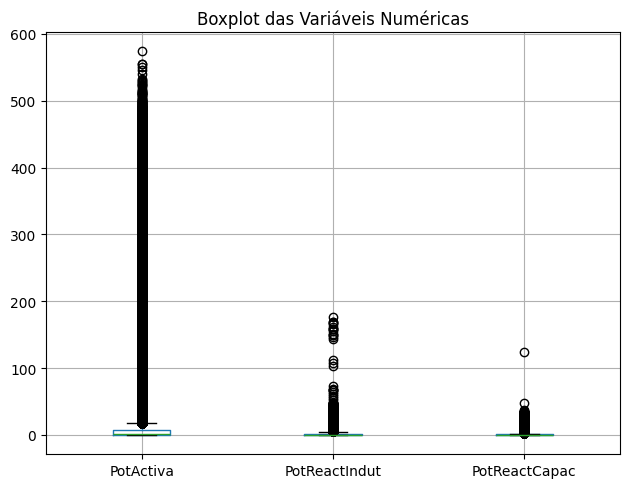

In [32]:
# Selecionar apenas as variaveis de interesse
variaveis = ["PotActiva", "PotReactIndut", "PotReactCapac"]

# Boxplot conjunto
plt.figure()
df.boxplot(column=variaveis)
plt.tight_layout()
plt.title("Boxplot das Variáveis Numéricas")
plt.show()


Com estes boxplots é possivel verificar a existencia de muitos outliers

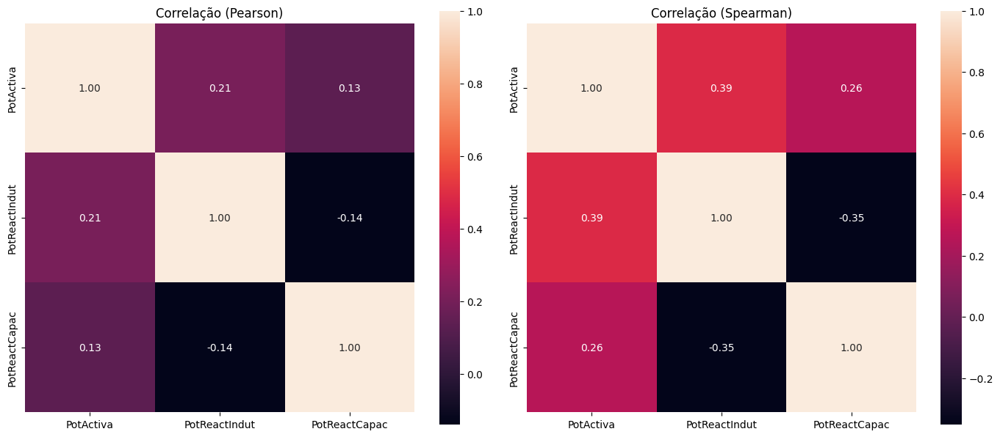

In [33]:
# variáveis que queremos usar para as correlações
num_cols = ["PotActiva", "PotReactIndut", "PotReactCapac"]

# são usados dois métodos diferentes para as correlações
corr = df[num_cols].corr(method="pearson")  # método de Pearson        
corr_spearman = df[num_cols].corr(method="spearman") # método de Spearman

plt.figure(figsize=(14, 6))
# --- Pearson ---
plt.subplot(1, 2, 1)
sns.heatmap(corr, annot=True, fmt=".2f", square=True)
plt.title("Correlação (Pearson)")

# --- Spearman ---
plt.subplot(1, 2, 2)
sns.heatmap(corr_spearman, annot=True, fmt=".2f", square=True)
plt.title("Correlação (Spearman)")

plt.tight_layout()
plt.show()


Pelas correlações apresentadas é possivel concluir que não existe nenhuma correlação entre as varias variaveis numéricas

### Frequencia de registos por Tempo e por CPE

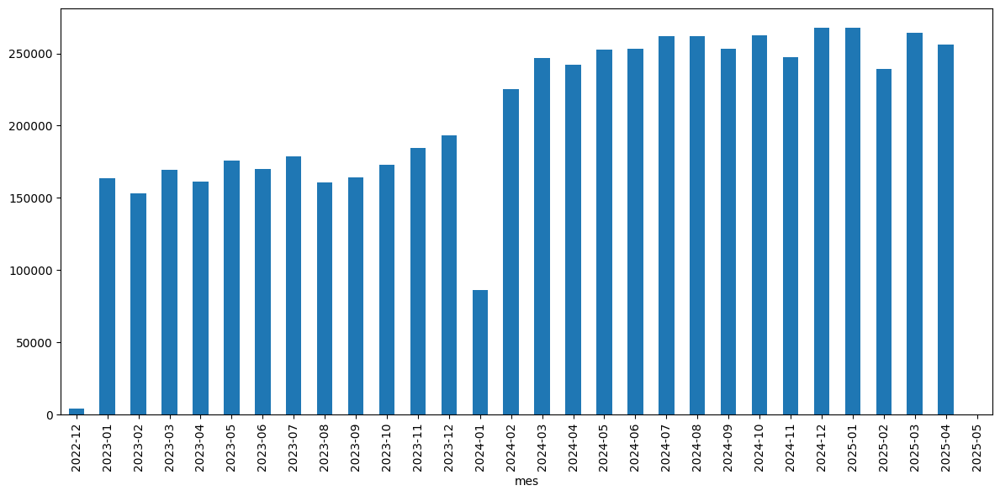

Seg    848934
Ter    848528
Qua    849124
Qui    845948
Sex    845973
Sáb    850071
Dom    851604
Name: count, dtype: int64


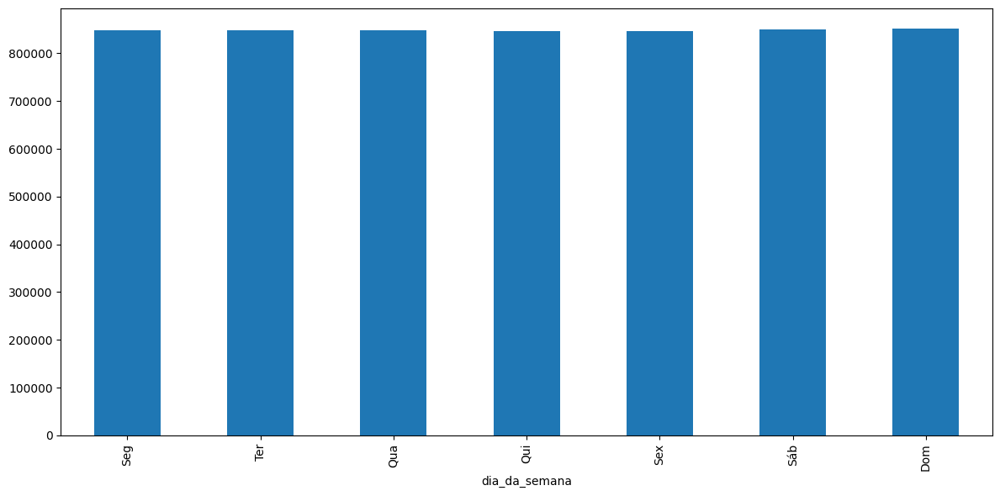

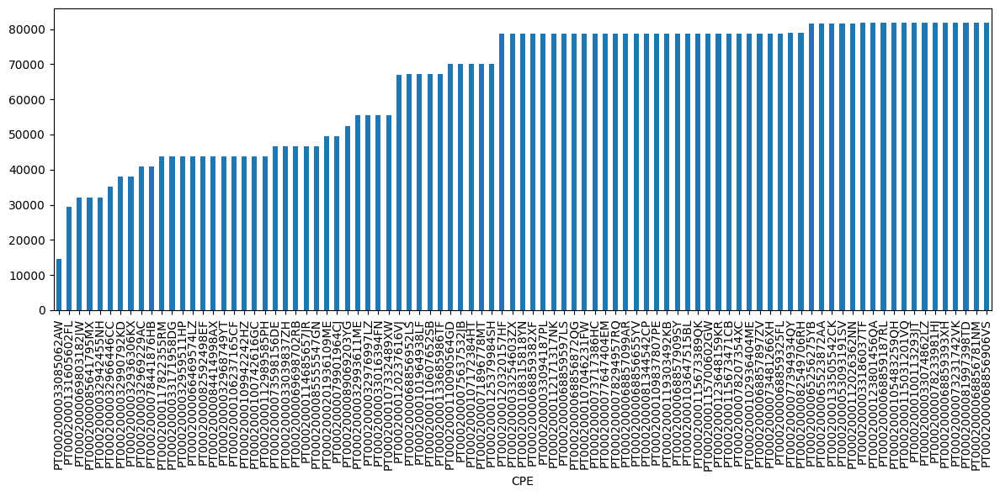

In [34]:
# contagem dos registos por mes
df["mes"].value_counts().sort_index().plot(kind="bar", figsize=(12,6))
plt.tight_layout()
plt.show()

# contagem por dias da semana
registos_dia = df["dia_da_semana"].value_counts().sort_index()
nome_dia = ["Seg", "Ter", "Qua", "Qui", "Sex", "Sáb", "Dom"]
registos_dia.index = nome_dia
print(registos_dia)
df["dia_da_semana"].value_counts().sort_index().plot(kind="bar", figsize=(12,6))
plt.xticks(ticks=range(7), labels=nome_dia)
plt.tight_layout()
plt.show()

# contagem por CPEs
freq_registos_cpe = df["CPE"].value_counts().sort_values()
freq_registos_cpe.plot(kind="bar", figsize=(12,6))
plt.tight_layout()
plt.show()


É possivel ver que todos os meses têm um numero de dados diferente, com o mês 1-2024 a ser o mais critico. O primeiro e ultimo mês têm poucos dados mas é normal. <br>
Se fizermos a freq. por dia da semana concluimos que todos os dias têm o mais ou menos o mesmo número de registos.<br>
Vendo a freq. por CPE percebemos que também existem CPEs com poucos registos.

In [35]:
# Definir o critério
# Apenas CPEs que tenham pelo menos 55% da média de registos máxima são válidos
max_registos = df["CPE"].value_counts().max()
threshold = max_registos * 0.55 

print(f"O máximo de registos é {max_registos}. O corte é {threshold:.0f}.")

# Identificar CPEs "saudáveis"
counts = df["CPE"].value_counts()
cpes_validos = counts[counts >= threshold].index.tolist()


print(f"CPEs a remover por falta de dados: {len(counts) - len(cpes_validos)}")

O máximo de registos é 81776. O corte é 44977.
CPEs a remover por falta de dados: 21


### Potências por dia da semana

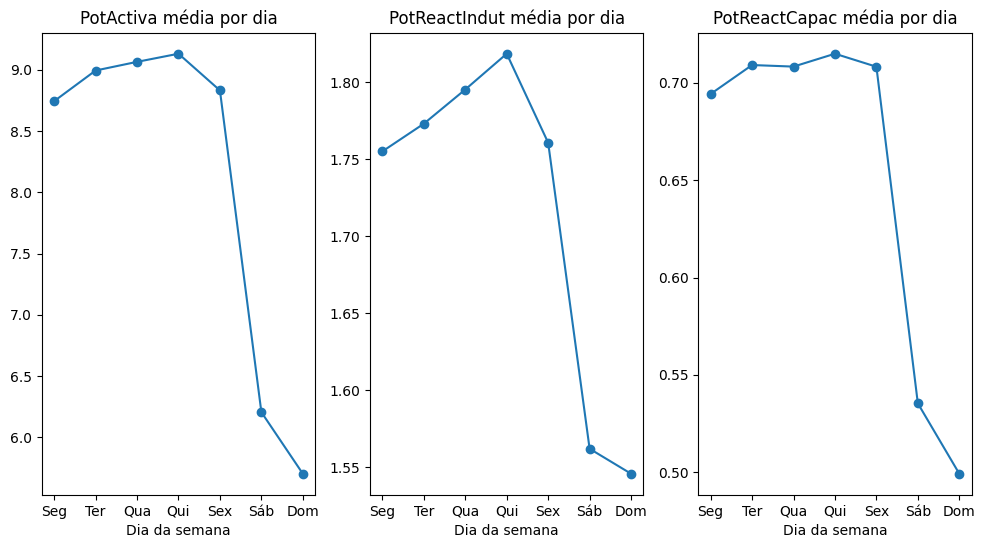

In [36]:
# procura das diferentes potencias por dia de semana
potActiva_media_dia = df.groupby("dia_da_semana")["PotActiva"].mean()
potReactIndut_media_dia = df.groupby("dia_da_semana")["PotReactIndut"].mean()
potReactCapac_media_dia = df.groupby("dia_da_semana")["PotReactCapac"].mean()

# dias da semana
dias = nome_dia

plt.figure(figsize=(12,6))

# plot potActiva
plt.subplot(1,3,1)
plt.plot(dias, potActiva_media_dia.values, marker="o")
plt.title("PotActiva média por dia")
plt.xlabel("Dia da semana")

# plot potReactIndut
plt.subplot(1,3,2)
plt.plot(dias, potReactIndut_media_dia.values, marker="o")
plt.title("PotReactIndut média por dia")
plt.xlabel("Dia da semana")

# plot porReactCapac
plt.subplot(1,3,3)
plt.plot(dias, potReactCapac_media_dia.values, marker="o")
plt.title("PotReactCapac média por dia")
plt.xlabel("Dia da semana")

plt.show()

Dia da semana com menor PotActiva -> Domingo<br>
Dia da semana com maior PotActiva -> Quinta<br>
Dia da semana com menor PotReactIndut -> Domingo<br>
Dia da semana com maior PotReactIndut -> Quinta<br>
Dia da semana com menor PotReactCapac -> Domingo<br>
Dia da semana com maior PotReactCapac -> Quinta

É possivel concluir que o fim de semana é o periodo de tempo onde se usa menos potência. Em sentido contrário, Quinta-feira é o dia em que é usada mais potência.

### Potências por hora do  dia

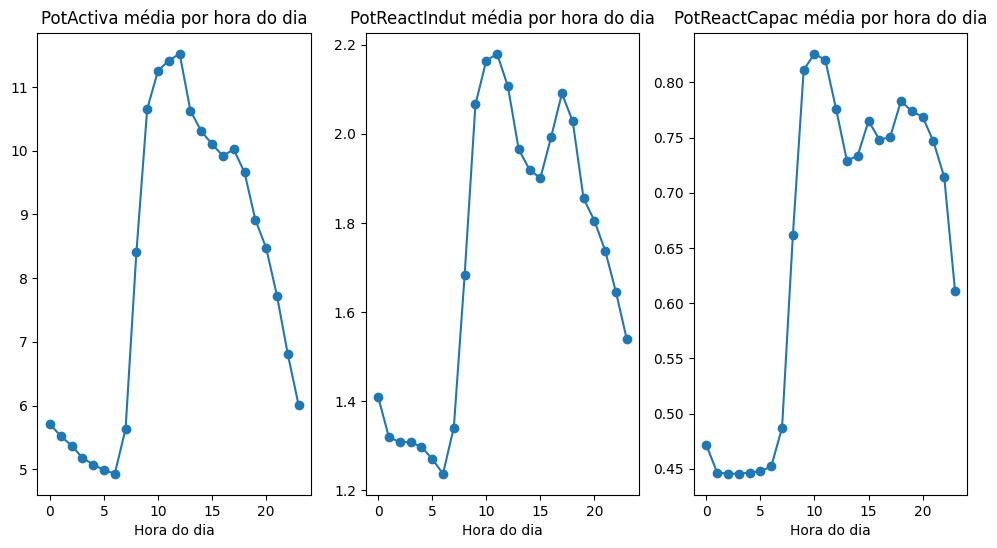

In [37]:
# procura das diferentes potencias por dia de semana
potActiva_media_hora = df.groupby("hora_do_dia")["PotActiva"].mean()
potReactIndut_media_hora = df.groupby("hora_do_dia")["PotReactIndut"].mean()
potReactCapac_media_hora = df.groupby("hora_do_dia")["PotReactCapac"].mean()

# gráficos

# plot potActiva
plt.figure(figsize=(12,6))
plt.subplot(1,3,1)
plt.plot(potActiva_media_hora.index, potActiva_media_hora.values, marker="o")
plt.title("PotActiva média por hora do dia")
plt.xlabel("Hora do dia")

#  plot PotReactIndut
plt.subplot(1,3,2)
plt.plot(potReactIndut_media_hora.index, potReactIndut_media_hora.values, marker="o")
plt.title("PotReactIndut média por hora do dia")
plt.xlabel("Hora do dia")

# plot PotReactCapac
plt.subplot(1,3,3)
plt.plot(potReactCapac_media_hora.index, potReactCapac_media_hora.values, marker="o")
plt.title("PotReactCapac média por hora do dia")
plt.xlabel("Hora do dia")
plt.show()

Hora do dia com menor PotActiva -> 6h<br>
Hora do dia com maior PotActiva -> 12h<br>
Hora do dia com menor PotReactIndut -> 6h<br>
Hora do dia com maior PotReactIndut -> 11h<br>
Hora do dia com menor PotReactCapac -> 3h<br>
Hora do dia com maior PotReactCapac -> 10h

Observa-se que o intervalo entre a 00h e as 07h regista a menor utilização de potência. Por outro lado, o intervalo entre as 8h e as 18h é o que regista maior utilização de potência.

### Frequência de dados por Potência

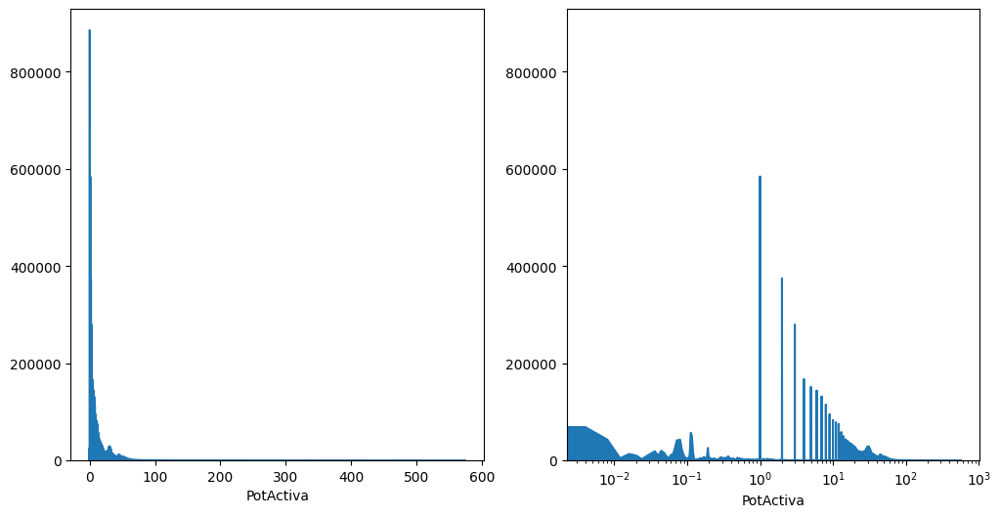

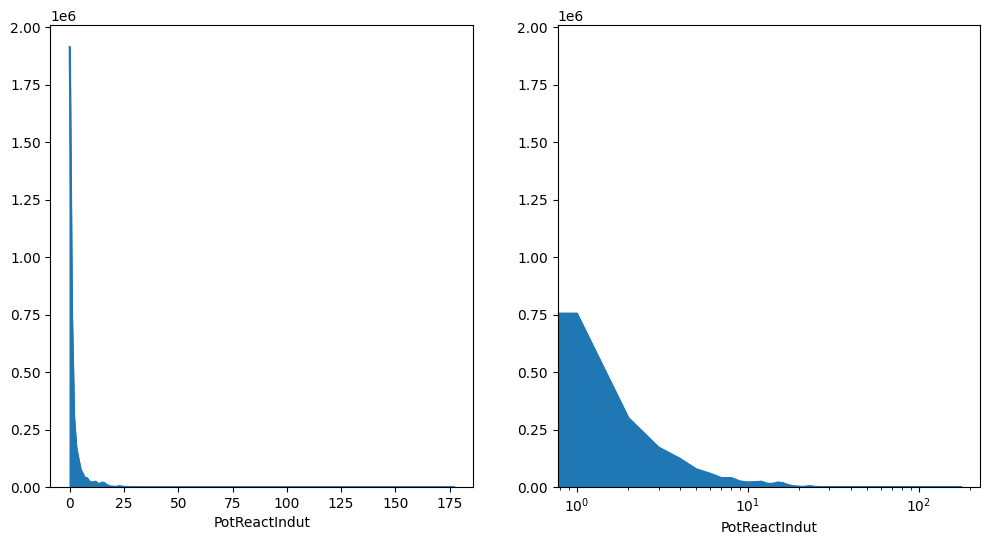

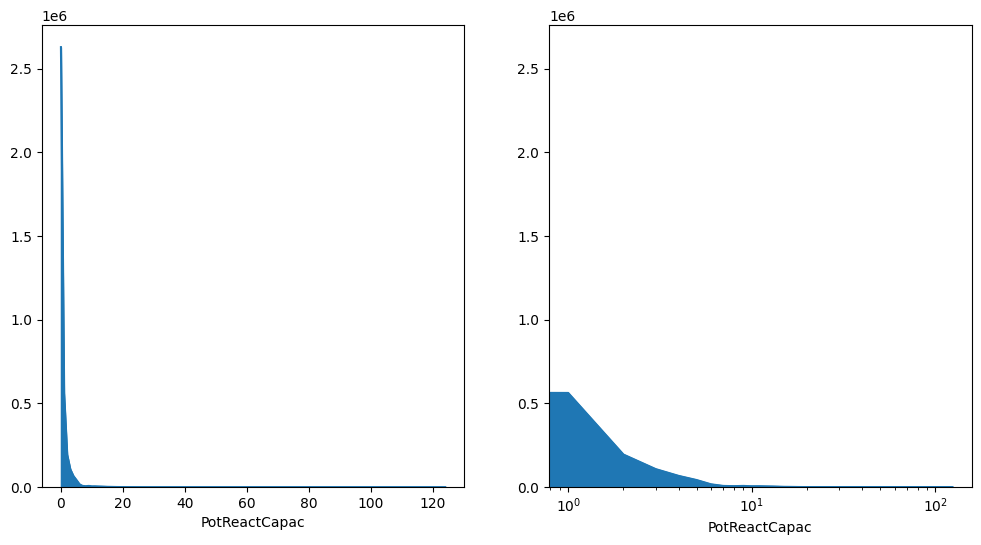

In [38]:
# contagem de dados por potencia
freq_potActiva = df["PotActiva"].value_counts().sort_index()
freq_potReactIndut = df["PotReactIndut"].value_counts().sort_index()
freq_potReactCapac = df["PotReactCapac"].value_counts().sort_index()

# plots PotActiva
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
freq_potActiva.plot(kind="area", figsize=(12,6))
plt.subplot(1,2,2)
freq_potActiva.plot(kind="area", figsize=(12,6), logx=True)
plt.show()

# plots potReactIndut
plt.subplot(1,2,1)
freq_potReactIndut.plot(kind="area", figsize=(12,6))
plt.subplot(1,2,2)
freq_potReactIndut.plot(kind="area", figsize=(12,6), logx=True)
plt.show()

# plots potReactCapac
plt.subplot(1,2,1)
freq_potReactCapac.plot(kind="area", figsize=(12,6))
plt.subplot(1,2,2)
freq_potReactCapac.plot(kind="area", figsize=(12,6), logx=True)
plt.show()

Analisando as 3 potências dadas, podemos dizer que os valores são, por norma, muito pequenos. Assim fizemos um gráfico com escala logaritmica para conseguir observar melhor o que acontece.<br>
Chegamos assim à conclusão que a maior parte dos valores das potências estão compreendidos entre os 0 e os 2 kWh. 

### Potência Ativa por CPE

CPEs com PotActiva média = 0: ['PT0002000032959511HP']


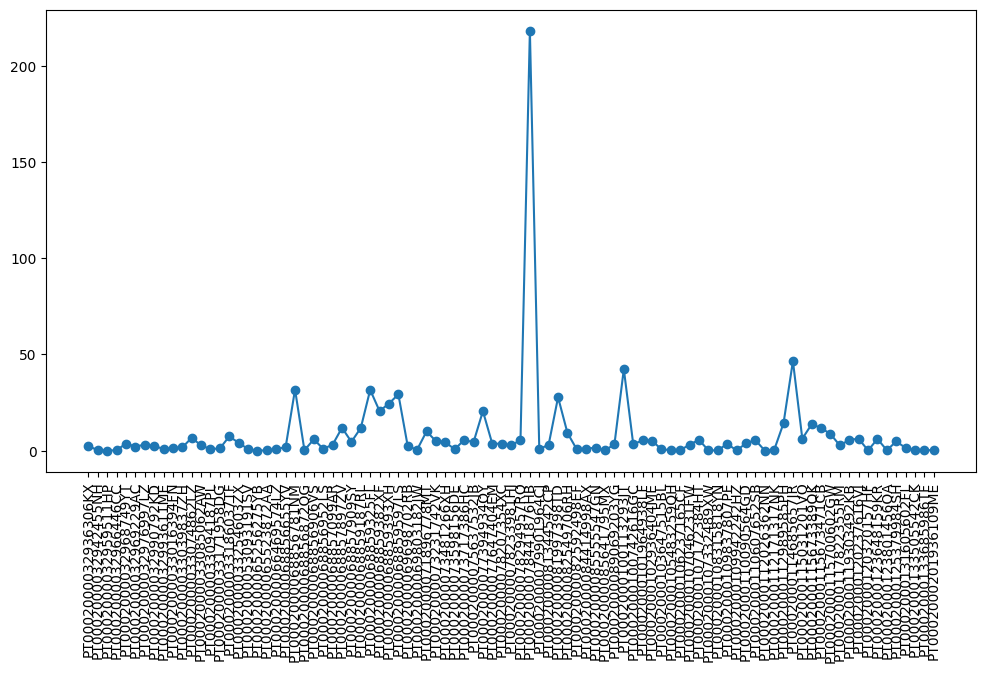

In [39]:
# procura de potActiva por CPE
potActiva_media_CPE = df.groupby("CPE")["PotActiva"].mean()

# procura de CPE com potActiva a zeros
cpe_zeros = potActiva_media_CPE[potActiva_media_CPE == 0].index.tolist()
print("CPEs com PotActiva média = 0:", cpe_zeros)

# plot a potActiva por CPE
plt.figure(figsize=(12,6))
plt.plot(potActiva_media_CPE.index, potActiva_media_CPE.values, marker="o")
plt.xticks(rotation=90)
plt.show()


Com este gráfico conseguimos claramente ver que existe um CPE que utiliza mais potência que os outros todos (através dos links disponibilizados percebemos que era a **torre do lidador**). Apesar de a sua presença altterar os valores das médias **não o consideramos um outlier**.

In [40]:
# 1. Calcular Quartis
Q1 = potActiva_media_CPE.quantile(0.25)
Q3 = potActiva_media_CPE.quantile(0.75)
IQR = Q3 - Q1

# 2. Definir o limite superior
# O padrão é 1.5, mas para dados de energia pode ser agressivo demais.
# por isso foi escolhido o seguinte
limite_superior = Q3 + 5 * IQR

print(f"Limite Superior calculado: {limite_superior}")

# 3. Identificar os CPEs outliers
outliers_iqr = potActiva_media_CPE[potActiva_media_CPE > limite_superior]   #cpes a eliminar no data preparation

print("CPEs considerados outliers pelo IQR:")
print(outliers_iqr.sort_values(ascending=False).head(20)) # Mostra os 5 maiores

Limite Superior calculado: 32.43551789389832
CPEs considerados outliers pelo IQR:
CPE
PT0002000078441876HB    218.193030
PT0002000114685657JR     46.469106
PT0002000100113293JT     42.289255
Name: PotActiva, dtype: float64


### Missing Values

Primeiro é necessario ver se a variavel alvo tem missing values:

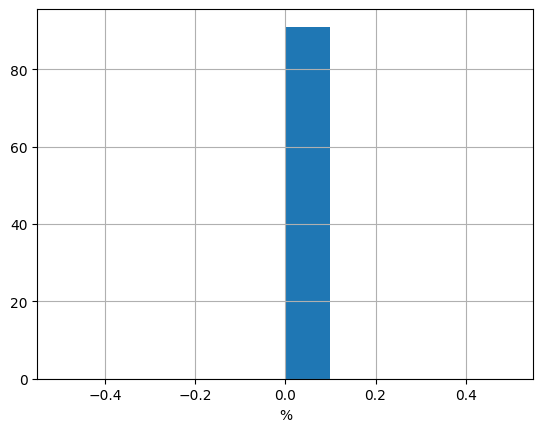

In [41]:
# percentagem de missing values de Potencia Ativa por CPE
missing_potactiva = df.groupby("CPE")["PotActiva"].apply(lambda x : x.isna().mean() * 100).sort_values( ascending=False)

missing_potactiva.hist()
plt.xlabel("%")
plt.show()

Podemos então concluir que a Potência Activa tem todos os valores no dataset não sendo preciso fazer inputação de valores.

Como 99% dos missing values pertencem ao phantom power, a variavel seguinte foi criada para melhor perceber o código:

In [42]:
# criação da variável phantom_power
phantom_power = ["PotReactIndut", "PotReactCapac"]

#### Missing values por CPE

42


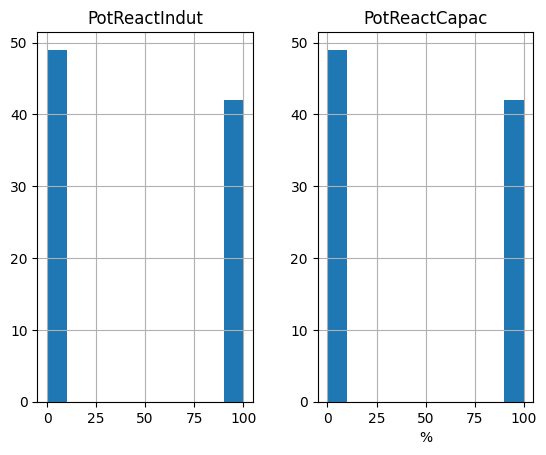

In [43]:
# percentagem de missing values por CPE
missing_cpe = df.groupby("CPE")[phantom_power].apply(lambda x : x.isna().mean() * 100).sort_values("PotReactIndut", ascending=False)
# calcular o numero de CPE's sem valores de phantom power
print(((missing_cpe["PotReactIndut"] == 100) & (missing_cpe["PotReactCapac"] == 100)).sum())

missing_cpe.hist()
plt.xlabel("%")
plt.show()

Existem 42 CPE (de um total de 91) **sem nenhum** valor de phantom power, ou seja, 46% dos CPEs não têm registos de phantom power. <br>
Os restantes CPE's estão a 0%, ou seja, não têm valores de phantom power em falta.

#### Missing values por mês

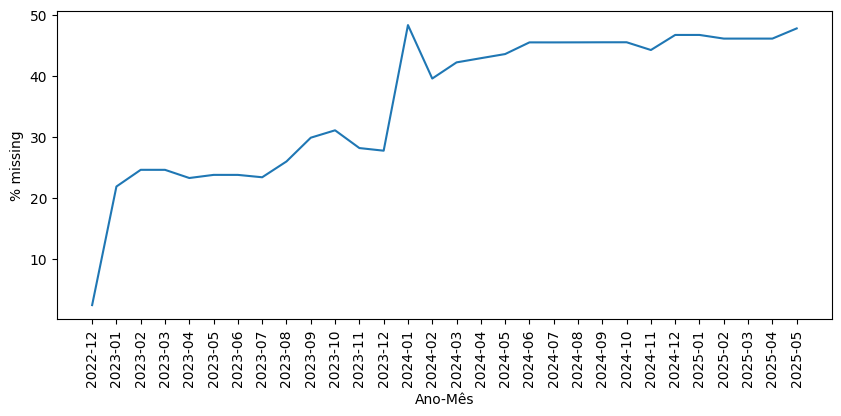

Percentagem média de missing value por mês: PotReactIndut    35.900797
PotReactCapac    35.900797
dtype: float64


,PotReactIndut,PotReactCapac
mes,,
2025-02,46.067641,46.067641
2024-12,46.666667,46.666667
2025-01,46.667065,46.667065
2025-05,47.736626,47.736626
2024-01,48.281257,48.281257


In [44]:
# procura de valores omissos por mes
missing_mes = df.groupby("mes")[phantom_power].apply(lambda x : x.isna().mean() * 100).sort_index()

# plot
plt.figure(figsize=(10,4))
plt.plot(missing_mes.index.astype(str), missing_mes["PotReactIndut"])
plt.xlabel("Ano-Mês")
plt.ylabel("% missing")
plt.xticks(rotation=90)
plt.show()

print("Percentagem média de missing value por mês:", missing_mes.mean())

missing_mes.sort_values("PotReactIndut").tail()

O mês com menor percentagem de missing values é 12-2022 (2.38%)<br>
O mês com maior percentagem de missing values é 1-2024 (48.28%)<br>
Mais uma vez conseguimos perceber que existem alguns meses criticos mas nenhum com mais de 50% de missing values.

## Data Preparation

### Remover atributos vazios

In [45]:
df = df.drop(columns=["DadosdeConsumo"]) #remove coluna sem valores

### Remover CPEs

In [46]:
# procura de CPEs com target a zero
cpe_zeros = potActiva_media_CPE[potActiva_media_CPE == 0].index.tolist()
print(len(cpe_zeros))
df = df[~df["CPE"].isin(cpe_zeros)]

# 1. Condição: O CPE tem de estar na lista de válidos
is_valid = df["CPE"].isin(cpes_validos)

# 2. Condição: O CPE NÃO (~) pode estar na lista de outliers
not_outlier = ~df["CPE"].isin(outliers_iqr.index) 

# 3. Aplicar o filtro: Manter apenas se for válido E não for outlier
df = df[is_valid & not_outlier]

len(df["CPE"].value_counts())


1


68

### Remoção de outliers

In [47]:
# Criar uma função para filtrar valores extremos por CPE
def filtrar_outliers_cpe(grupo):
    limite = grupo["PotActiva"].quantile(0.999)  # 0,1% mais alto
    return grupo[grupo["PotActiva"] <= limite]

print(f"Linhas antes: {len(df)}")

# Aplicar o filtro por CPE
df = df.groupby("CPE", group_keys=False).apply(filtrar_outliers_cpe)

print(f"Linhas depois: {len(df)}")


Linhas antes: 4998428
Linhas depois: 4994702


### Remover linhas duplicadas

In [48]:
print(f"Linhas antes da remoção: {len(df)}")
df = df.drop_duplicates() # remove linhas duplicadas
print("Linhas após remoção:", len(df))

Linhas antes da remoção: 4994702
Linhas após remoção: 4994058


### Tratar variaveis nulas

Como visto na análise do dataset, existem 42 CPE sem phantom power o que equivale a mais de 2.2 milhões de registos sem phantom power. Assim, não podemos simplesmente eliminar esses registos. <br>
A abordagem escolhida para este caso foi em usar a média por dia e hora dos restantes CPEs para imputar nos registos a NaN para minimizar o erro. Ainda assim existirá um erro uma vez que o número de dados em falta são muito grandes

In [49]:
# imputação da média por hora e dia dos phantom power que não contém valores
for pot in phantom_power:
    df[pot] = df[pot].fillna(df.groupby(["dia_da_semana","hora_do_dia","mes"])[pot].transform("mean"))

df.isna().sum()     #dados em falta para as duas PotReact era cerca de 38%


CPE              0
tstamp           0
PotActiva        0
PotReactIndut    0
PotReactCapac    0
ano              0
mes              0
dia_da_semana    0
hora_do_dia      0
dtype: int64

### Criar variaveis adicionais

Como já feito anteriormente, foram criadas as variaveis ano, mes, dia_da_semana e hora_do_dia. Para os modelos de aprendizagem não-supervisionada será criada tambem as variaveis fim_de_semana, dias_uteis, dia e noite.

In [50]:
# feriados encontrados para o concelho da Maia
feriados = [
    "2023-01-01",
    "2024-01-01",
    "2025-01-01",
    "2023-02-21",   # Carnaval
    "2024-02-13",
    "2025-03-04",
    "2023-04-09",   # Páscoa
    "2024-03-31",
    "2025-04-20",
    "2023-04-07",   # Sexta-feira Santa
    "2024-03-29",
    "2025-04-18",
    "2023-04-25",   # Dia da Liberdade
    "2024-04-25",
    "2025-04-25",
    "2023-05-01",   # Dia do Trabalhador
    "2024-05-01",
    "2025-05-01",
    "2023-06-08",   # Corpo de Deus
    "2024-06-30",
    "2023-06-10",   # Dia de Portugal
    "2024-06-10",
    "2023-07-14",   # Feriado Municipal da Maia
    "2024-07-15",
    "2023-08-15",   # Assunção de Nossa Senhora
    "2024-08-15",
    "2023-10-05",   # Dia da República
    "2024-10-05",
    "2023-11-01",   # Dia de Todos os Santos
    "2024-11-01",
    "2022-12-01",   # Restauracao da Independenca
    "2023-12-01",
    "2024-12-01",
    "2022-12-08",   # Imaculada Conceição
    "2023-12-08",
    "2024-12-08",
    "2022-12-25",   # Natal
    "2023-12-25",
    "2024-12-25",
]

# Converter feriados para datetime
feriados_dt = pd.to_datetime(feriados)

# criar variaveis para distinguir os dias da semana
df["dias_nao_uteis"] = ((df["dia_da_semana"] >= 5) | (df["tstamp"].dt.date.isin(feriados_dt.date))).astype(np.int8)
df["dias_uteis"] = (1 - df["dias_nao_uteis"]).astype(np.int8)

# criar variaveis para a manhã, tarde e noite
df["manha"] = ((df["hora_do_dia"] >= 6) & (df["hora_do_dia"] <= 13)).astype(np.int8)
df["tarde"] = ((df["hora_do_dia"] >= 14) & (df["hora_do_dia"] <= 21)).astype(np.int8)
df["noite"] = ((df["hora_do_dia"] < 6) | (df["hora_do_dia"] >= 22)).astype(np.int8)
df["periodo"] = (df["manha"] * 0 + df["tarde"] * 1 + df["noite"] * 2)
# coluna temporaria
df["mes_temp"] = df["mes"].dt.month

# criar variaveis para as estçoes do ano
df["primavera"] = ((df["mes_temp"].isin([3,4,5]))).astype(np.int8)
df["verao"] = ((df["mes_temp"].isin([6,7,8]))).astype(np.int8)
df["outono"] = ((df["mes_temp"].isin([9,10,11]))).astype(np.int8)
df["inverno"] = ((df["mes_temp"].isin([12,1,2]))).astype(np.int8)

# apagar a coluna temporária
df.drop(columns=["mes_temp","dia_da_semana"], inplace=True)
df["estacoes"] = (df["primavera"] * 0 + df["verao"] * 1 + df["outono"] * 2 + df["inverno"] * 3)

In [51]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4994058 entries, 2001937 to 5845041
Data columns (total 19 columns):
 #   Column          Dtype         
---  ------          -----         
 0   CPE             object        
 1   tstamp          datetime64[ns]
 2   PotActiva       float64       
 3   PotReactIndut   float64       
 4   PotReactCapac   float64       
 5   ano             period[Y-DEC] 
 6   mes             period[M]     
 7   hora_do_dia     int32         
 8   dias_nao_uteis  int8          
 9   dias_uteis      int8          
 10  manha           int8          
 11  tarde           int8          
 12  noite           int8          
 13  periodo         int8          
 14  primavera       int8          
 15  verao           int8          
 16  outono          int8          
 17  inverno         int8          
 18  estacoes        int8          
dtypes: datetime64[ns](1), float64(3), int32(1), int8(11), object(1), period[M](1), period[Y-DEC](1)
memory usage: 376.3+ MB


#### label de cada cpe: escola, pavilhao,...

In [52]:
# Leitura do ficheiro txt 'label_cpe.txt'
df_labels = pd.read_csv(
    'label_cpe.txt', 
    sep=' - ', 
    engine='python', 
    header=None, 
    names=['CPE', 'Descricao']
)

# Limpeza técnica apenas para garantir que não ficam espaços "Escola " vs "Escola"
df_labels['CPE'] = df_labels['CPE'].str.strip()
df_labels['Descricao'] = df_labels['Descricao'].str.strip()

#contar os diferentes tipos de descrições que estão presentes no df principal
descricao_presentes = df_labels[df_labels['CPE'].isin(df['CPE'].unique())]['Descricao'].value_counts()
print(descricao_presentes)

Descricao
Escola                 21
Pavilhao                8
Iluminacao Publica      8
Edificio                7
Espaco Publico          6
Cultura e Juventude     5
Sistemas de agua        5
Sem descricao           4
Outros                  4
Name: count, dtype: int64


#### novas correlaçoes

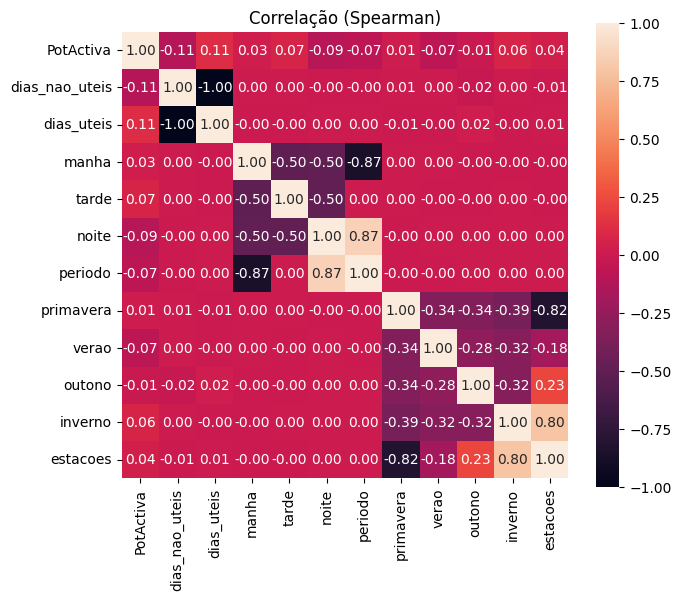

In [53]:
# variaveis para correlacionar
cols_corr = [
    "PotActiva",  # ou DadosDeConsumo
    "dias_nao_uteis", "dias_uteis",
    "manha", "tarde", "noite", "periodo",
    "primavera", "verao", "outono", "inverno", "estacoes"
]

# foi usado o método de spearman
corr = df[cols_corr].corr(method="spearman")

# --- Spearman ---
plt.figure(figsize=(7, 6))
sns.heatmap(corr, annot=True, fmt=".2f", square=True)
plt.title("Correlação (Spearman)")


plt.tight_layout()
plt.show()

### Preparar dataset para Clustering

Tambem é preciso fazer features por CPE:

In [ ]:
# 1. PRÉ-PROCESSAMENTO
# Criamos colunas onde o valor é NaN se não for o período desejado.
# O Pandas ignora NaNs automaticamente ao calcular a média.
cols_temporais = ['manha', 'tarde', 'noite', 'dias_uteis', 'dias_nao_uteis', 
                  'primavera', 'verao', 'outono', 'inverno']

for col in cols_temporais:
    # Cria colunas temporárias
    df[f'temp_{col}'] = np.where(df[col] == 1, df['PotActiva'], np.nan)

# 2. AGREGAÇÃO
df_features = df.groupby("CPE").agg(
    # --- Estatísticas Gerais (Para estabilidade e forma) ---
    consumo_medio_total=("PotActiva", "mean"),
    consumo_std=("PotActiva", "std"),  # Desvio padrão (para volatilidade)
    consumo_max=("PotActiva", "max"),  # Pico máximo (para Load Factor)
    
    # --- Médias Parciais ---
    #media_manha=("temp_manha", "mean"),
    #media_tarde=("temp_tarde", "mean"),
    #media_noite=("temp_noite", "mean"),
    
    media_dias_uteis=("temp_dias_uteis", "mean"),
    media_dias_nao_uteis=("temp_dias_nao_uteis", "mean"),
    
    media_primavera=("temp_primavera", "mean"),
    media_verao=("temp_verao", "mean"),
    media_outono=("temp_outono", "mean"),
    media_inverno=("temp_inverno", "mean"),

    # --- Tendência Recente  ---
    media_recente_1week=("PotActiva", lambda x: x.tail(672).mean()),
    media_recente_1day=("PotActiva", lambda x: x.tail(96).mean())
)

cols_estacoes = ["media_primavera", "media_verao", "media_outono", "media_inverno"]
for col in cols_estacoes:
    df_features[col] = df_features[col].fillna(df_features['consumo_medio_total'])

# 3. FEATURE ENGINEERING

# B. Ratio Fim de Semana vs Semana
df_features['ratio_fds_semana'] = df_features['media_dias_nao_uteis'] / df_features['media_dias_uteis']

# C. Métricas de Estabilidade e Forma
# Coeficiente de Variação (CV): O quão "nervoso" é o consumo.
df_features['cv_consumo'] = df_features['consumo_std'] / df_features['consumo_medio_total']

# Load Factor: Eficiência do uso da rede. (Média / Máximo)
# Perto de 1 = consumo plano (flat). Perto de 0 = picos altos.
df_features['load_factor'] = df_features['consumo_medio_total'] / df_features['consumo_max']

# D. Sazonalidade
# Comparamos cada estação com a média anual
df_features['sazonalidade_verao'] = df_features['media_verao'] / df_features['consumo_medio_total']
df_features['sazonalidade_inverno'] = df_features['media_inverno'] / df_features['consumo_medio_total']

# E. Tendência (O cliente está a aumentar ou diminuir consumo recentemente?)
df_features['ratio_tendencia_1week'] = df_features['media_recente_1week'] / df_features['consumo_medio_total']
#df_features['ratio_tendencia_1day'] = df_features['media_recente_1day'] / df_features['consumo_medio_total']

#df_features['ratio_manha'] = df_features['media_manha'] / df_features['consumo_medio_total']
#df_features['ratio_tarde'] = df_features['media_tarde'] / df_features['consumo_medio_total']
#df_features['ratio_noite'] = df_features['media_noite'] / df_features['consumo_medio_total']

# 4. LIMPEZA FINAL
# Selecionar apenas as colunas de "comportamento" para o clustering
cols_para_clustering = [
    'consumo_medio_total', 
    'media_dias_uteis', 'media_dias_nao_uteis',
    'ratio_fds_semana',
    'cv_consumo', 'load_factor',
    #'ratio_manha', 'ratio_tarde', 'ratio_noite',
    'sazonalidade_verao', 'sazonalidade_inverno',
    'ratio_tendencia_1week'#, 'ratio_tendencia_1day'
]

# Tratar divisões por zero ou NaNs
df_cluster_ready = df_features[cols_para_clustering].copy()
df_cluster_ready = df_cluster_ready.replace([np.inf, -np.inf], np.nan).fillna(0)


# clustering de pot reactivas
df_react = df.groupby("CPE").agg({
    "PotReactIndut": ["mean", "std"],
    "PotReactCapac": ["mean", "std"]
}).reset_index()
df_react.columns = ["CPE", "PotReactIndut_mean", "PotReactIndut_std",
                       "PotReactCapac_mean", "PotReactCapac_std"]


### Preparar dataset para Previsões

#### Dataset para Arima/Sarima

##### Dados não normalizados

In [ ]:
TARGET = "PotActiva"
EXOGENOS_FIXOS = ["periodo", "estacoes", "dias_nao_uteis"] 

df = df.sort_values(["CPE", "tstamp"])
df_previsao = {}

# --- PROCESSAMENTO ---
for cpe, subdf in df.groupby("CPE"):
    # Preparacao basica
    subdf = (
        subdf.copy()
        .sort_values("tstamp")
        .set_index("tstamp")
    )
    
    subdf.index = pd.to_datetime(subdf.index)
    
    # Resampling e Forçar Frequência
    cols_to_keep = [TARGET] + [c for c in EXOGENOS_FIXOS if c in subdf.columns]
    subdf = subdf[cols_to_keep]
    
    # Agrupar pela media para lidar com duplicados, depois impor frequencia
    subdf = subdf.groupby(level=0).mean().asfreq("15min")

    # Interpolacao Inteligente do Target
    subdf[TARGET] = subdf[TARGET].interpolate(
        method="time", 
        limit=8, 
        limit_direction="both"
    )

    
    # Recalcular Hora Ciclica (Seno/Cosseno)
    # Usamos o Index para garantir que linhas novas tenham valor correto
    hora_numerica = subdf.index.hour
    
    subdf["hora_sin"] = np.sin(2 * np.pi * hora_numerica / 24)
    subdf["hora_cos"] = np.cos(2 * np.pi * hora_numerica / 24)

    # Recalcular Mes Ciclico
    mes_numerico = subdf.index.month
    subdf["mes_sin"] = np.sin(2 * np.pi * mes_numerico / 12)
    subdf["mes_cos"] = np.cos(2 * np.pi * mes_numerico / 12)

        
    # Recalcula Dias Úteis / Não Úteis
    if "dias_nao_uteis" in EXOGENOS_FIXOS:
         mask_fds = subdf.index.dayofweek >= 5
         
         # Tenta recuperar a logica dos feriados se a variavel existir
         try:
             # Assume que feriados_dt existe no scope global 
             mask_feriado = subdf.index.normalize().isin(feriados_dt)
             subdf["dias_nao_uteis"] = (mask_fds | mask_feriado).astype(int)
         except:
             # Se der erro (nao encontrar feriados_dt), usa so o FDS
             subdf["dias_nao_uteis"] = mask_fds.astype(int)

    # Recalcula Estacoes Periodo
    if "periodo" in EXOGENOS_FIXOS:
        h = subdf.index.hour
        subdf["periodo"] = 0 # Default
        subdf.loc[(h >= 6) & (h <= 13), "periodo"] = 0 # Manhã
        subdf.loc[(h >= 14) & (h <= 21), "periodo"] = 1 # Tarde
        subdf.loc[(h >= 22) | (h < 6), "periodo"] = 2 # Noite

    # Para outras colunas fixas que NAO dependem do tempo,
    cols_estaticas = [c for c in EXOGENOS_FIXOS if c not in ["dias_nao_uteis", "periodo", "estacoes"]]
    if cols_estaticas:
        subdf[cols_estaticas] = subdf[cols_estaticas].ffill().bfill()

    subdf["PotActiva_Lag_1Week"] = subdf[TARGET].shift(672)


    LISTA_EXOGENOS_FINAL = ["hora_sin", "hora_cos", "mes_sin", "mes_cos", "PotActiva_Lag_1Week"] + EXOGENOS_FIXOS


    # Limpeza final
    cols_final = [TARGET] + LISTA_EXOGENOS_FINAL
    subdf = subdf.dropna()

    # Garantir numerico
    for col in cols_final:
        subdf[col] = pd.to_numeric(subdf[col], errors="coerce")
    
    subdf = subdf.dropna()
    
    df_previsao[cpe] = subdf

# --- Divisao Treino / Teste ---
df_arima = {}

for cpe, serie in df_previsao.items():
    n = len(serie)
    split = int(n * 0.7)
    
    df_arima[cpe] = {
        "treino": serie.iloc[:split],
        "teste":  serie.iloc[split:],
        "exogenos_cols": LISTA_EXOGENOS_FINAL # guardar esta lista para o modelo saber o que usar
    }



##### Dados normalizados

In [ ]:
# Dataset de Arima normalizado

# Dicionario para guardar dados normalizados e os scalers
df_arima_norm = {}

print("--- Iniciando Normalização ---")

for cpe, dados in df_arima.items():
    # Recuperar dados originais
    treino_orig = dados["treino"].copy()
    teste_orig = dados["teste"].copy()
    exogenos_cols = dados["exogenos_cols"]

    # Inicializar Scaler
    scaler = StandardScaler()

    # Fit apenas no TREINO para evitar data leakage
    treino_vals = treino_orig["PotActiva"].values.reshape(-1, 1)
    scaler.fit(treino_vals)

# Funcao auxiliar para nao repetir codigo
    def aplicar_scaler(df_temp, scaler):
        df_out = df_temp.copy()
        # Normaliza Target
        df_out["PotActiva"] = scaler.transform(df_temp["PotActiva"].values.reshape(-1, 1)).flatten()
        # Normaliza o Lag
        if "PotActiva_Lag_1Week" in df_out.columns:
             df_out["PotActiva_Lag_1Week"] = scaler.transform(df_temp["PotActiva_Lag_1Week"].values.reshape(-1, 1)).flatten()
        return df_out

    treino_norm = aplicar_scaler(treino_orig, scaler)
    teste_norm = aplicar_scaler(teste_orig, scaler)

    # Guardar tudo
    df_arima_norm[cpe] = {
        "treino": treino_norm,
        "teste": teste_norm,
        "exogenos_cols": exogenos_cols,
        "scaler": scaler 
    }

print("Dados normalizados criados em 'df_arima_norm'.")


--- Iniciando Normalização ---
Dados normalizados criados em 'df_arima_norm'.


#### Dataset para LSTM

In [ ]:
# constantes
N_STEPS_IN = 96  # 1 semana de historico
N_STEPS_OUT = 1   # 1 semana de previsao
GAP = 672         # 1 semana de gap
FREQ = "15min"
TARGET = "residual"
FEATURES = [
    "dias_uteis",
    #"periodo_sin", "periodo_cos",
    "estacoes_sin", "estacoes_cos",
    "hora_sin", "hora_cos",
    "lag_15min", "lag_30min", "lag_45min","lag_1day",
    "lag_1week_antigo", "rolling_mean_2h"
]

# buscar os dados totais
df_lstm = df.copy()

# funcao responsavel por extrair, limpar e regularizar a serie temporal de um unico CPE
def preparar_serie_cpe(df_lstm, cpe, target="PotActiva", freq="15min"):
    df_cpe = (
        df_lstm[df_lstm["CPE"] == cpe]
        .copy()
        .sort_values("tstamp")
        .set_index("tstamp")
    )
    df_cpe.index = pd.to_datetime(df_cpe.index)
    serie = (
        df_cpe[target]
        .groupby(level=0)
        .mean()
        .asfreq(freq)
        .interpolate(limit_direction="both")
        .dropna()
    )
    return serie

# funcao responsavel por criar as features temporais
def criar_features_temporais(serie):
    df_lstm = serie.to_frame(name="PotActiva")

    # base temporal
    df_lstm["mes"] = df_lstm.index.month.astype(np.int8)
    df_lstm["hora_do_dia"] = df_lstm.index.hour.astype(np.int8)
    df_lstm["hora_sin"] = np.sin(2 * np.pi * df_lstm["hora_do_dia"] / 24).astype(np.float32)
    df_lstm["hora_cos"] = np.cos(2 * np.pi * df_lstm["hora_do_dia"] / 24).astype(np.float32)

    # dias uteis / nao uteis
    df_lstm["dias_uteis"] = ((df_lstm.index.dayofweek < 5) & (~df_lstm.index.isin(feriados_dt))).astype(np.int8)
    df_lstm["dias_nao_uteis"] = (~df_lstm["dias_uteis"]).astype(np.int8)

    # periodos do dia
    df_lstm["manha"] = ((df_lstm["hora_do_dia"] > 6) & (df_lstm["hora_do_dia"] <= 13)).astype(np.int8)
    df_lstm["tarde"] = ((df_lstm["hora_do_dia"] >= 14) & (df_lstm["hora_do_dia"] < 21)).astype(np.int8)
    df_lstm["noite"] = ((df_lstm["hora_do_dia"] <= 6) | (df_lstm["hora_do_dia"] >= 21)).astype(np.int8)
    df_lstm["periodo"] = np.select(
        [df_lstm["manha"]==1, df_lstm["tarde"]==1, df_lstm["noite"]==1],
        [0, 1, 2],
        default=-1
    )
    df_lstm["periodo_sin"] = np.sin(2 * np.pi * df_lstm["periodo"] / 3).astype(np.float32)
    df_lstm["periodo_cos"] = np.cos(2 * np.pi * df_lstm["periodo"] / 3).astype(np.float32)

    # estacoes
    df_lstm["primavera"] = df_lstm["mes"].isin([3,4,5]).astype(np.int8)
    df_lstm["verao"] = df_lstm["mes"].isin([6,7,8]).astype(np.int8)
    df_lstm["outono"] = df_lstm["mes"].isin([9,10,11]).astype(np.int8)
    df_lstm["inverno"] = df_lstm["mes"].isin([12,1,2]).astype(np.int8)
    df_lstm["estacoes"] = np.select(
        [df_lstm["primavera"]==1, df_lstm["verao"]==1, df_lstm["outono"]==1, df_lstm["inverno"]==1],
        [0, 1, 2, 3],
        default=-1
    )
    df_lstm["estacoes_sin"] = np.sin(2 * np.pi * df_lstm["estacoes"] / 4).astype(np.float32)
    df_lstm["estacoes_cos"] = np.cos(2 * np.pi * df_lstm["estacoes"] / 4).astype(np.float32)

    # semana anterior
    df_lstm["lag_15min"] = df_lstm["PotActiva"].shift(1)
    df_lstm["lag_30min"] = df_lstm["PotActiva"].shift(2)
    df_lstm["lag_45min"] = df_lstm["PotActiva"].shift(3)
    df_lstm["lag_1day"] = df_lstm["PotActiva"].shift(96)
    df_lstm["lag_1week_antigo"] = df_lstm["PotActiva"].shift(672)
    df_lstm["rolling_mean_2h"] = df_lstm["PotActiva"].rolling(window=8).mean()
    
    df_lstm["residual"] = df_lstm["PotActiva"] - df_lstm["lag_1week_antigo"]

    df_lstm.dropna(inplace=True)
    return df_lstm[[TARGET] + FEATURES].astype(np.float32)

def criar_sequencias(df_lstm, n_steps_in, n_steps_out, target_col, gap=0):
    X, y = [], []
    values = df_lstm.values
    if target_col not in df_lstm.columns:
        raise ValueError(f"O target '{target_col}' não existe no dataframe.")
    target_idx = df_lstm.columns.get_loc(target_col)
    feature_idx = [i for i in range(values.shape[1])]

    total = len(df_lstm) - n_steps_in - n_steps_out - gap + 1
    for i in range(total):
        X.append(values[i : i + n_steps_in, feature_idx])
        idx_start_out = i + n_steps_in + gap
        y.append(values[idx_start_out : idx_start_out + n_steps_out, target_idx])

    return np.array(X, dtype=np.float32), np.array(y, dtype=np.float32)


def preparar_df_lstm(df_lstm, cpe,  normalizar=False):
    # Preparar a serie e features
    serie = preparar_serie_cpe(df_lstm, cpe, target="PotActiva", freq=FREQ)
    df_feat = criar_features_temporais(serie)

    # Divisao Treino / Teste
    split = int(0.7 * len(df_feat))
    df_train = df_feat.iloc[:split]
    df_test = df_feat.iloc[split:]

    cols_to_scale = [TARGET] + FEATURES
    scaler = None # Variavel para guardar o objeto scaler

    # Logica de Normalizacao Condicional
    if normalizar:
        # Se True, cria e aplica o StandardScaler
        scaler = StandardScaler()

        df_train_scaled = pd.DataFrame(
            scaler.fit_transform(df_train[cols_to_scale]), 
            index=df_train.index, 
            columns=cols_to_scale
        )
        df_test_scaled = pd.DataFrame(
            scaler.transform(df_test[cols_to_scale]), 
            index=df_test.index, 
            columns=cols_to_scale
        )
        X_train, y_train = criar_sequencias(df_train_scaled, N_STEPS_IN, N_STEPS_OUT, TARGET, gap=GAP)
        X_test, y_test = criar_sequencias(df_test_scaled, N_STEPS_IN, N_STEPS_OUT, TARGET, gap=GAP)
        start_idx = N_STEPS_IN + GAP
        end_idx = start_idx + len(y_test)

 
    else:
        # caso contrário nao normaliza

        df_train_processed = df_train[cols_to_scale].copy()
        df_test_processed = df_test[cols_to_scale].copy()

        X_train, y_train = criar_sequencias(df_train_processed, N_STEPS_IN, N_STEPS_OUT, TARGET, gap=GAP)
        X_test, y_test   = criar_sequencias(df_test_processed, N_STEPS_IN, N_STEPS_OUT, TARGET, gap=GAP)

        start_idx = N_STEPS_IN + GAP
        end_idx = start_idx + len(y_test)



    #Baseline para residuo
    baseline_test = df_test["lag_1week_antigo"].values[start_idx : end_idx]

    return X_train, y_train, X_test, y_test, scaler, baseline_test

#### Dataset para modelos de features-sets

In [58]:
lags = [
    672,       # Exatamente 1 semana atras (O mais importante)
    673, 674, 676,  # Contexto imediato (15 min antes/depois de há 1 semana)
    1344,      # Exatamente 2 semanas atras
    2016       # Exatamente 3 semanas atras
]

##### Sem normalização

In [59]:
df_feature_set = {} # dicionario que vai conter o dataset para usar em algoritmos baseados em feature-sets per customer


for cpe, subdf in df_previsao.items():
    df_feat = subdf.copy()
    
    df_feat = df_feat.drop(["PotActiva_Lag_1Week"], axis=1)  # Remover lag antigo para evitar duplicação

    # Criar colunas de Lags
    for lag in lags:
        df_feat[f'lag_{lag}'] = df_feat["PotActiva"].shift(lag)
    
    # Remover linhas com NaNs
    df_feat = df_feat.dropna()
    
    # Separar Treino e Teste
    n = len(df_feat)
    split = int(n * 0.7)
    
    treino = df_feat.iloc[:split]
    teste  = df_feat.iloc[split:]
    
    # Separar Features (X) e Target (y)
    X_treino = treino.drop(columns=["PotActiva"])
    y_treino = treino["PotActiva"]
    
    X_teste = teste.drop(columns=["PotActiva"])
    y_teste = teste["PotActiva"]
    
    # Validar que todos os tipos são numéricos
    X_treino = X_treino.apply(pd.to_numeric, errors='coerce')
    X_teste = X_teste.apply(pd.to_numeric, errors='coerce')

    # dataset final
    df_feature_set[cpe] = {
        "X_treino": X_treino,
        "y_treino": y_treino,
        "X_teste":  X_teste,
        "y_teste":  y_teste
    }
print(f"Dataset corrigido e preparado para {len(df_feature_set)} CPEs.")

Dataset corrigido e preparado para 68 CPEs.


##### Com normalização

In [ ]:
df_feature_set_scaled = {} # dicionario que vai conter o dataset para usar algoritmos baseados em feature-sets per customer, mas normalizado


print("A preparar dados com Normalização...")

for cpe, subdf in df_previsao.items():
    df_feat = subdf.copy()
    
    df_feat = df_feat.drop(["PotActiva_Lag_1Week"], axis=1)  # Remover lag antigo para evitar duplicação

    # Criar colunas de Lags
    for lag in lags:
        df_feat[f'lag_{lag}'] = df_feat["PotActiva"].shift(lag)
    
    # Remover linhas com NaNs
    df_feat = df_feat.dropna()
    
    # Separar Treino e Teste
    n = len(df_feat)
    split = int(n * 0.7)
    
    treino = df_feat.iloc[:split]
    teste  = df_feat.iloc[split:]
    
    # Separar X e y
    X_treino = treino.drop(columns=["PotActiva"])
    y_treino = treino["PotActiva"]
    
    X_teste = teste.drop(columns=["PotActiva"])
    y_teste = teste["PotActiva"]
    
    # Garantir numerico antes de normalizar
    X_treino = X_treino.apply(pd.to_numeric, errors='coerce')
    X_teste = X_teste.apply(pd.to_numeric, errors='coerce')

    # --- NORMALIZAÇÃO ---
    
    # A) Normalizar as Features (X)
    scaler_X = StandardScaler()
    
    # Fit apenas no Treino para nao haver data leakage
    X_treino_scaled = scaler_X.fit_transform(X_treino)
    X_teste_scaled  = scaler_X.transform(X_teste)
    
    # Converter de volta para DataFrame para manter indices e nomes
    X_treino = pd.DataFrame(X_treino_scaled, index=X_treino.index, columns=X_treino.columns)
    X_teste  = pd.DataFrame(X_teste_scaled, index=X_teste.index, columns=X_teste.columns)
    
    # B) Normalizar o Target (y)
    scaler_y = StandardScaler()
    
    # O scaler espera matriz 2D, fazemos reshape
    y_treino_vals = y_treino.values.reshape(-1, 1)
    y_teste_vals  = y_teste.values.reshape(-1, 1)
    
    # Fit no treino, transform no teste
    y_treino_scaled = scaler_y.fit_transform(y_treino_vals)
    y_teste_scaled  = scaler_y.transform(y_teste_vals)
    
    # Voltar para Series (1D)
    y_treino = pd.Series(y_treino_scaled.flatten(), index=y_treino.index)
    y_teste  = pd.Series(y_teste_scaled.flatten(), index=y_teste.index)
    
    # ------------------------------------

    # dataset final
    df_feature_set_scaled[cpe] = {
        "X_treino": X_treino,   # Normalizado
        "y_treino": y_treino,   # Normalizado
        "X_teste":  X_teste,    # Normalizado
        "y_teste":  y_teste,    # Normalizado
        "scaler_y": scaler_y    # Guardado para inverter a previsao depois
    }

print(f"Dataset normalizado e preparado para {len(df_feature_set_scaled)} CPEs.")

A preparar dados com Normalização...
Dataset normalizado e preparado para 68 CPEs.


### Baseline

Baseline requerido para comparar resultados futuros

In [ ]:
baseline_results = {}

for cpe, dados in df_previsao.items():
    serie = dados.copy()
    
    # 1. Calculamos o baseline na série inteira PRIMEIRO.
    serie["Baseline"] = serie["PotActiva"].shift(672)
    
    # 2. Agora fazemos o split
    n = len(serie)
    split = int(n * 0.7)
    
    # O conjunto de teste já vem com a coluna Baseline preenchida
    teste = serie.iloc[split:].copy()
    
    # 3. Remover NaNs
    teste = teste.dropna(subset=["PotActiva", "Baseline"])
    
    if len(teste) == 0:
        print(f"CPE {cpe} sem dados suficientes para teste.")
        continue

    y_true = teste["PotActiva"]
    y_pred = teste["Baseline"]

    # 4. Calcular Métricas e Salvar
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    
    baseline_results[cpe] = {
        "y_true": y_true,
        "y_pred": y_pred,
        "MAE": mae,
        "RMSE": rmse
    }
# Concatenar todos os valores reais e previsoes
todos_reais = np.concatenate([baseline_results[cpe]["y_true"] for cpe in baseline_results])
todas_prev = np.concatenate([baseline_results[cpe]["y_pred"] for cpe in baseline_results])

# Calcular metricas globais
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
mae_total = mean_absolute_error(todos_reais, todas_prev)

print(f"Baseline - MAE total: {mae_total:.3f} | RMSE total: {rmse_total:.3f}")

Baseline - MAE total: 2.078 | RMSE total: 5.660


Assim, o Baseline a ter em conta aquando da avaliação de modelos de previsão será:
- MAE: 2.078
- RMSE: 5.66

## Modeling

### Aprendizagem não-supervisionada

#### K-means

##### K-means nao normalizado

Método do Cotovelo

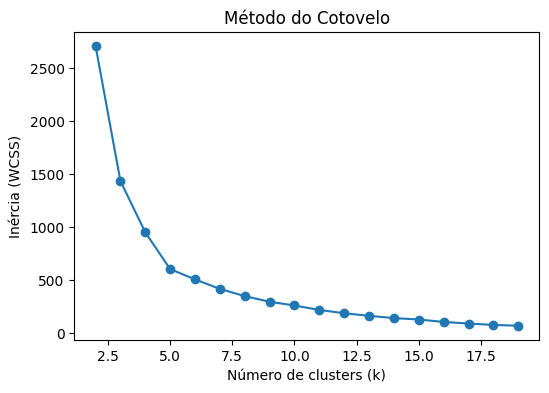

In [62]:
# Separar os dados de input (sem a coluna CPE)
X_KMEANS_UNSCALED = df_cluster_ready.drop(columns=["CPE", "cluster"], errors="ignore")

inertias = [] # lista para as inertias
K = range(2, 20) # range de ks a testar para k-means

# ciclo para correr 
for k in K:
    km = KMeans(n_clusters=k, random_state=42, n_init=20)
    km.fit(X_KMEANS_UNSCALED)
    inertias.append(km.inertia_)

# plot dos resultados
plt.figure(figsize=(6,4))
plt.plot(K, inertias, marker='o')
plt.xlabel("Número de clusters (k)")
plt.ylabel("Inércia (WCSS)")
plt.title("Método do Cotovelo")
plt.show()


Silhouette score

In [63]:
resultados = [] # lista para resultados

# ciclo para testar os diferentes k
for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=20)
    labels = kmeans.fit_predict(X_KMEANS_UNSCALED)

    resultados.append({
        "k": k,
        "inertia": kmeans.inertia_,
        "silhouette": silhouette_score(X_KMEANS_UNSCALED, labels),
    })

# guardar os resultados numa pandaDataFrame para melhor visualizacao
df_resultados = pd.DataFrame(resultados)
display(df_resultados)

,k,inertia,silhouette
0,2,2708.909640,0.791116
1,3,1432.477982,0.510560
2,4,948.505855,0.538267
3,5,601.021293,0.530446
4,6,504.071535,0.442431
5,7,414.263713,0.448741
6,8,346.081798,0.445823
7,9,292.667507,0.438424


Criar modelo, ajustar e comparar

In [64]:
# Criar e ajustar o modelo K-Means
kmeans = KMeans(n_clusters=4, random_state=42, n_init=20)  
kmeans.fit(X_KMEANS_UNSCALED)

# Guardar os clusters no dataframe
df_cluster_ready["cluster_km_unscaled"] = kmeans.labels_

df_comparacao = df_cluster_ready.merge(
    df_labels,
    left_index=True,
    right_on="CPE",
    how="left"
)
# agrupar por cluster e ver as descrições
cluster_desc = df_comparacao.groupby('cluster_km_unscaled')['Descricao'].apply(list)
#display(cluster_desc)
tabela_comparacao = df_comparacao.groupby(['cluster_km_unscaled', 'Descricao']).size().unstack(fill_value=0)

# Mostrar a tabela
display(tabela_comparacao)
    

Descricao,Cultura e Juventude,Edificio,Escola,Espaco Publico,Iluminacao Publica,Outros,Pavilhao,Sem descricao,Sistemas de agua
cluster_km_unscaled,,,,,,,,,
0,4,3,2,3,8,0,1,2,3
1,0,1,2,1,0,3,0,0,0
2,1,3,11,2,0,1,7,2,1
3,0,0,6,0,0,0,0,0,1


##### K-means normalizado

Método do cotovelo

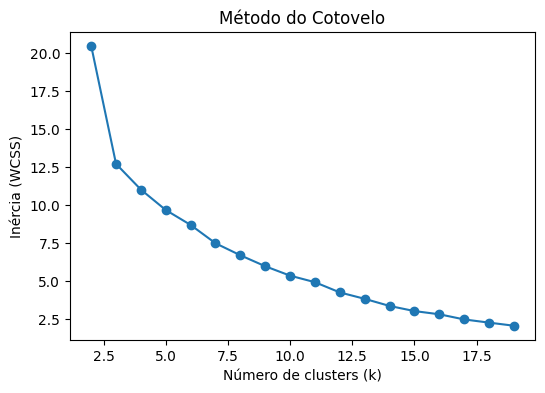

In [65]:
# Separar os dados de input (sem a coluna CPE)
X_KMEANS = df_cluster_ready.drop(columns=["CPE", "cluster"], errors="ignore")
# Normalizar 
scaler = MinMaxScaler()
X_kmeans_scaled = scaler.fit_transform(X_KMEANS)
inertias = []
K = range(2, 20)

# ciclo para testar os k
for k in K:
    km = KMeans(n_clusters=k, random_state=42, n_init=20)
    km.fit(X_kmeans_scaled)
    inertias.append(km.inertia_)

# plotar resultados
plt.figure(figsize=(6,4))
plt.plot(K, inertias, marker='o')
plt.xlabel("Número de clusters (k)")
plt.ylabel("Inércia (WCSS)")
plt.title("Método do Cotovelo")
plt.show()


Silhouette score

In [66]:
resultados = [] # lista para resultados

# ciclo para testar os diferentes k
for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=20)
    labels = kmeans.fit_predict(X_kmeans_scaled)

    resultados.append({
        "k": k,
        "inertia": kmeans.inertia_,
        "silhouette": silhouette_score(X_kmeans_scaled, labels),
    })

# guardar os resultados numa pandaDataFrame para melhor visualizacao
df_resultados = pd.DataFrame(resultados)
display(df_resultados)

,k,inertia,silhouette
0,2,20.488740,0.375990
1,3,12.701280,0.449582
2,4,11.005969,0.315495
3,5,9.659951,0.279193
4,6,8.676382,0.301559
5,7,7.469321,0.302290
6,8,6.677230,0.327843
7,9,5.954578,0.303383


In [67]:
# Criar e ajustar o modelo K-Means
kmeans = KMeans(n_clusters=3, random_state=42, n_init=20)  
kmeans.fit(X_kmeans_scaled)

# Guardar os clusters no dataframe
df_cluster_ready["cluster_km_scaled"] = kmeans.labels_

# Agrupar por cluster e calcular a média dessas colunas
#tabela_medias = df_cluster_ready.groupby("cluster_km_scaled")[df_cluster_ready.columns].mean()
#display(tabela_medias)

# Comparar os clusters com as descrições reais
df_comparacao = df_cluster_ready.merge(
    df_labels,
    left_index=True,
    right_on="CPE",
    how="left"
)
# agrupar por cluster e ver as descrições
cluster_desc = df_comparacao.groupby('cluster_km_scaled')['Descricao'].apply(list)
#display(cluster_desc)
tabela_comparacao = df_comparacao.groupby(['cluster_km_scaled', 'Descricao']).size().unstack(fill_value=0)

# Mostrar a tabela
display(tabela_comparacao)

Descricao,Cultura e Juventude,Edificio,Escola,Espaco Publico,Iluminacao Publica,Outros,Pavilhao,Sem descricao,Sistemas de agua
cluster_km_scaled,,,,,,,,,
0,1,3,17,2,0,1,7,2,2
1,4,3,2,3,8,0,1,2,3
2,0,1,2,1,0,3,0,0,0


In [68]:
# Reduzir para 2 dimensões com PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_kmeans_scaled)

# Juntar as coordenadas do PCA com as colunas originais
plot_df = pd.DataFrame({
    'PCA1': X_pca[:, 0],
    'PCA2': X_pca[:, 1],
    'Cluster_KM': df_cluster_ready['cluster_km_scaled'].astype(str),
    'CPE': df_cluster_ready.index,
    #Colunas originais para o hover:
    'PotActiva': df_cluster_ready['consumo_medio_total']

})

# Scatter Plot Personalizado
fig = px.scatter(plot_df, x='PCA1', y='PCA2', color='Cluster_KM', hover_name='CPE',
    hover_data={            # Ver o perfil de consumo
        'PotActiva': ':.4f',
        'PCA1': False,       
        'PCA2': False,      
        'Cluster_KM': False  # Já está na cor
    }, title='Caracterização de Consumidores (K-Means)', template='plotly_white', width=900, height=600
)

# Ajuste da legenda 
fig.update_layout(legend=dict(title="Cluster", orientation="h", y=1.02, x=0.5, xanchor="center"))
fig.show()

# peso de cada variável na construção do PCA1 e PCA2
loadings = pd.DataFrame( pca.components_.T, columns=['PCA1', 'PCA2'], index= X_KMEANS.columns)


#### Cluster de Phantom Power

reactive_cluster   0   1  2
cluster_km_scaled          
0                  7  24  4
1                  0  26  0
2                  2   2  3


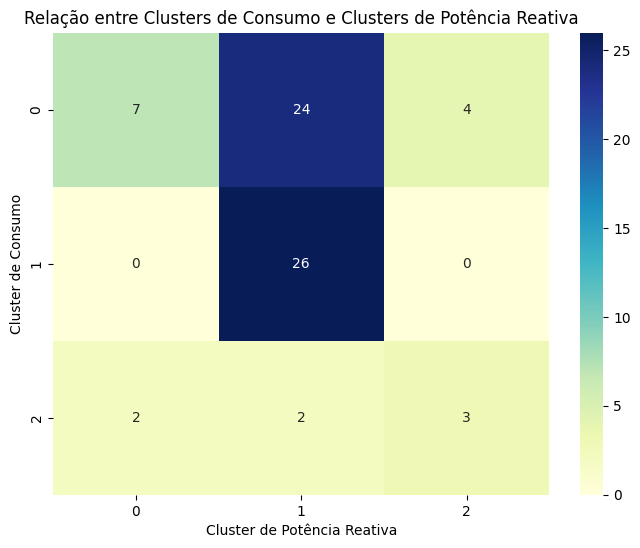

In [69]:
# normalizar
scaler = StandardScaler()
X_reactive_scaled = scaler.fit_transform(df_react[["PotReactIndut_mean", "PotReactIndut_std",
                                                      "PotReactCapac_mean", "PotReactCapac_std"]])

kmeans_reactive = KMeans(n_clusters=3, random_state=42, n_init=20)
df_react["reactive_cluster"] = kmeans_reactive.fit_predict(X_reactive_scaled)
df_merged = df_cluster_ready.merge(df_react[["CPE", "reactive_cluster"]], on="CPE")
# Ver como os clusters se relacionam
cross_tab = pd.crosstab(df_merged["cluster_km_scaled"], df_merged["reactive_cluster"])
print(cross_tab)
#heatmap
plt.figure(figsize=(8,6))
sns.heatmap(cross_tab, annot=True, fmt="d", cmap="YlGnBu")
plt.title("Relação entre Clusters de Consumo e Clusters de Potência Reativa")
plt.xlabel("Cluster de Potência Reativa")
plt.ylabel("Cluster de Consumo")
plt.show()

In [70]:
# fazer sort por reactive_cluster para facilitar a procura
df_react = df_react.sort_values("reactive_cluster").reset_index(drop=True)
# reactive_cluster por cpe por ordem crescente
for cpe in df_react["CPE"]:
    reactive_cluster = df_react.loc[df_react["CPE"] == cpe, "reactive_cluster"].values[0]
    print(f"CPE: {cpe}, Cluster: {reactive_cluster}")

CPE: PT0002000068856906VS, Cluster: 0
CPE: PT0002000073717386HC, Cluster: 0
CPE: PT0002000071896778MT, Cluster: 0
CPE: PT0002000068859325FL, Cluster: 0
CPE: PT0002000110090564GD, Cluster: 0
CPE: PT0002000102936404ME, Cluster: 0
CPE: PT0002000082549706RH, Cluster: 0
CPE: PT0002000081997398TD, Cluster: 0
CPE: PT0002000115700602GW, Cluster: 0
CPE: PT0002000033254603ZX, Cluster: 1
CPE: PT0002000065523872AA, Cluster: 1
CPE: PT0002000053093191SV, Cluster: 1
CPE: PT0002000033074862LZ, Cluster: 1
CPE: PT0002000032976997LZ, Cluster: 1
CPE: PT0002000033016394FN, Cluster: 1
CPE: PT0002000032993611ME, Cluster: 1
CPE: PT0002000068856952LS, Cluster: 1
CPE: PT0002000068856872QG, Cluster: 1
CPE: PT0002000068856781NM, Cluster: 1
CPE: PT0002000068857099AR, Cluster: 1
CPE: PT0002000069698702RB, Cluster: 1
CPE: PT0002000073231742VK, Cluster: 1
CPE: PT0002000068859187RL, Cluster: 1
CPE: PT0002000068857909SY, Cluster: 1
CPE: PT0002000073481266XH, Cluster: 1
CPE: PT0002000073598156DE, Cluster: 1
CPE: PT00020

#### DBScan

##### DBSCAN sem normalização

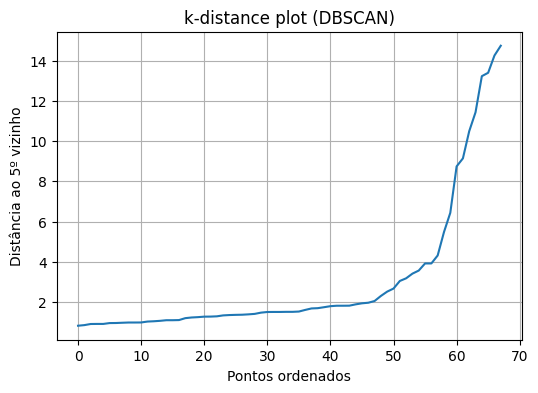

In [71]:
# constante
X_DBSCAN_UNSCALED = df_cluster_ready.drop(columns=["CPE", "cluster"], errors="ignore")

k = 5  # igual ao min_samples

nn = NearestNeighbors(n_neighbors=k)
nn.fit(X_DBSCAN_UNSCALED)

distances, _ = nn.kneighbors(X_DBSCAN_UNSCALED)

# distância ao k-ésimo vizinho
k_distances = np.sort(distances[:, k-1])

# plotar resultados
plt.figure(figsize=(6,4))
plt.plot(k_distances)
plt.ylabel(f"Distância ao {k}º vizinho")
plt.xlabel("Pontos ordenados")
plt.title("k-distance plot (DBSCAN)")
plt.grid(True)
plt.show()

In [72]:
# range de valores de epsilon a testar
eps_values = np.arange(0.1, 5.01, 0.01)
min_samples_values = range(3, 15)

best_score = -1
best_params = None
best_labels = None

# ciclo para correr os testes
for eps in eps_values:
    for min_samples in min_samples_values:
        db = DBSCAN(eps=eps, min_samples=min_samples)
        labels = db.fit_predict(X_DBSCAN_UNSCALED)

        # Remover ruido
        mask = labels != -1
        labels_no_noise = labels[mask]

        # Numero de clusters reais
        n_clusters = len(set(labels_no_noise))

        # Silhouette so faz sentido com ≥2 clusters
        if n_clusters >= 2:
            score = silhouette_score(
                X_DBSCAN_UNSCALED[mask],
                labels_no_noise
            )

            if score > best_score:
                best_score = score
                best_params = (eps, min_samples)
                best_labels = labels

# imprimir so o melhor
print("Melhor silhouette:", best_score)
print("Melhores parâmetros:")
print("eps:", best_params[0])
print("minSamples:", best_params[1])

Melhor silhouette: 0.8322712581773988
Melhores parâmetros:
eps: 0.8599999999999995
minSamples: 4


In [73]:
# usar os melhores parametros para o dbscan
dbscan = DBSCAN(eps=best_params[0], min_samples=best_params[1]) #min_samples é metade do número de features
dbscan.fit(X_DBSCAN_UNSCALED)
df_cluster_ready["cluster_dbscan"] = dbscan.labels_

df_comparacao = df_cluster_ready.merge(
    df_labels,
    left_index=True,
    right_on="CPE",
    how="left"
)

# agrupar por cluster e ver as descricoes
cluster_desc = df_comparacao.groupby('cluster_dbscan')['Descricao'].apply(list)
#display(cluster_desc)
tabela_comparacao = df_comparacao.groupby(['cluster_dbscan', 'Descricao']).size().unstack(fill_value=0)

# Mostrar a tabela
display(tabela_comparacao)

Descricao,Cultura e Juventude,Edificio,Escola,Espaco Publico,Iluminacao Publica,Outros,Pavilhao,Sem descricao,Sistemas de agua
cluster_dbscan,,,,,,,,,
-1,5,5,19,5,7,4,5,4,4
0,0,1,2,1,1,0,0,0,1
1,0,1,0,0,0,0,3,0,0


In [78]:
# Reduzir para 2 dimensoes com PCA
pca_dbscan = PCA(n_components=2)
X_pca_dbscan = pca_dbscan.fit_transform(X_DBSCAN_UNSCALED)

# Juntar as coordenadas do PCA com as colunas originais
plot_df = pd.DataFrame({
    'PCA1': X_pca[:, 0],
    'PCA2': X_pca[:, 1],
    'Cluster_DBSCAN': df_cluster_ready['cluster_dbscan'].astype(str),
    'CPE': df_cluster_ready.index,
    # Colunas originais para o hover:
    'PotActiva': df_cluster_ready['consumo_medio_total']

})

# Grafico dinamico
fig = px.scatter(plot_df, x='PCA1', y='PCA2', color='Cluster_DBSCAN', hover_name='CPE',
    hover_data={            # Ver o perfil de consumo
        'PotActiva': ':.4f',
        'PCA1': False,       
        'PCA2': False,      
        'Cluster_DBSCAN': False  # Já esta na cor
    }, title='Caracterização de Consumidores (DBSCAN)', template='plotly_white', width=900, height=600
)

fig.update_layout(legend=dict(title="Cluster", orientation="h", y=1.02, x=0.5, xanchor="center"))
fig.show()

##### DBSCAN com normalização

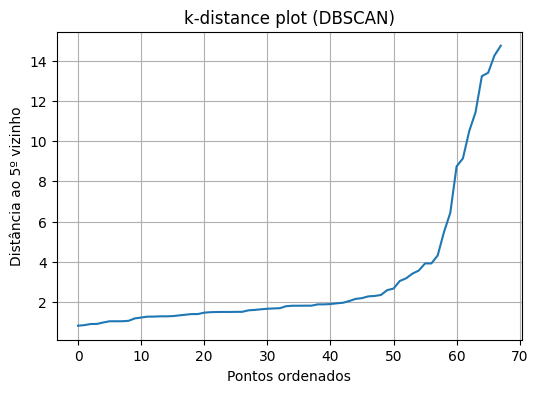

In [74]:
# Separar os dados de input (sem a coluna CPE)
X_DBSCAN = df_cluster_ready.drop(columns=["CPE", "cluster"], errors="ignore")

k = 5  # igual ao min_samples

nn = NearestNeighbors(n_neighbors=k)
nn.fit(X_DBSCAN)

distances, _ = nn.kneighbors(X_DBSCAN)

# distância ao k-ésimo vizinho
k_distances = np.sort(distances[:, k-1])

# plotar resultados
plt.figure(figsize=(6,4))
plt.plot(k_distances)
plt.ylabel(f"Distância ao {k}º vizinho")
plt.xlabel("Pontos ordenados")
plt.title("k-distance plot (DBSCAN)")
plt.grid(True)
plt.show()

In [75]:
# Normalizar 
scaler = MinMaxScaler()
X_DBSCAN_scaled = scaler.fit_transform(X_DBSCAN)

# # range de valores de epsilon a testar
eps_values = np.arange(0.1, 5.01, 0.01)
min_samples_values = range(3, 15)

best_score = -1
best_params = None
best_labels = None

# ciclo para correr os testes
for eps in eps_values:
    for min_samples in min_samples_values:
        db = DBSCAN(eps=eps, min_samples=min_samples)
        labels = db.fit_predict(X_DBSCAN_scaled)

        # Remover ruído
        mask = labels != -1
        labels_no_noise = labels[mask]

        # Número de clusters reais
        n_clusters = len(set(labels_no_noise))

        # Silhouette só faz sentido com ≥2 clusters
        if n_clusters >= 2:
            score = silhouette_score(
                X_DBSCAN_scaled[mask],
                labels_no_noise
            )

            if score > best_score:
                best_score = score
                best_params = (eps, min_samples)
                best_labels = labels

# imprimir so o melhor
print("Melhor silhouette:", best_score)
print("Melhores parâmetros:")
print("eps:", best_params[0])
print("minSamples:", best_params[1])

Melhor silhouette: 0.7084182542442163
Melhores parâmetros:
eps: 0.23999999999999994
minSamples: 4


In [76]:
dbscan = DBSCAN(eps=best_params[0], min_samples=best_params[1]) #min_samples é metade do número de features
dbscan.fit(X_DBSCAN_scaled)
df_cluster_ready["cluster_dbscan"] = dbscan.labels_

# Agrupar por cluster e calcular a média dessas colunas
#tabela_medias = df_features.groupby("cluster")[colunas_consumo].mean()
#display(tabela_medias)

df_comparacao = df_cluster_ready.merge(
    df_labels,
    left_index=True,
    right_on="CPE",
    how="left"
)

# agrupar por cluster e ver as descricoes
cluster_desc = df_comparacao.groupby('cluster_dbscan')['Descricao'].apply(list)
#display(cluster_desc)
tabela_comparacao = df_comparacao.groupby(['cluster_dbscan', 'Descricao']).size().unstack(fill_value=0)

# Mostrar a tabela
display(tabela_comparacao)

Descricao,Cultura e Juventude,Edificio,Escola,Espaco Publico,Iluminacao Publica,Outros,Pavilhao,Sem descricao,Sistemas de agua
cluster_dbscan,,,,,,,,,
-1,5,5,10,6,8,3,3,2,5
0,0,1,11,0,0,1,2,2,0
1,0,1,0,0,0,0,3,0,0


In [77]:
# Reduzir para 2 dimensoes com PCA
pca_dbscan = PCA(n_components=2)
X_pca_dbscan = pca_dbscan.fit_transform(X_DBSCAN_scaled)

# Juntar as coordenadas do PCA com as colunas originais
plot_df = pd.DataFrame({
    'PCA1': X_pca[:, 0],
    'PCA2': X_pca[:, 1],
    'Cluster_DBSCAN': df_cluster_ready['cluster_dbscan'].astype(str),
    'CPE': df_cluster_ready.index,
    # Colunas originais para o hover:
    'PotActiva': df_cluster_ready['consumo_medio_total']

})

# Gráfico dinamico
fig = px.scatter(plot_df, x='PCA1', y='PCA2', color='Cluster_DBSCAN', hover_name='CPE',
    hover_data={            # Ver o perfil de consumo
        'PotActiva': ':.4f',
        'PCA1': False,       
        'PCA2': False,      
        'Cluster_DBSCAN': False  # Já esta na cor
    }, title='Caracterização de Consumidores (DBSCAN)', template='plotly_white', width=900, height=600
)

fig.update_layout(legend=dict(title="Cluster", orientation="h", y=1.02, x=0.5, xanchor="center"))
fig.show()

### Aprendizagem Supervisionada

In [50]:
# criacao de um dicionário de pesquisa rápida para saberes a que cluster pertence cada CPE.
cluster_por_cpe = (
    df_cluster_ready["cluster_km_scaled"]
    .to_dict()
)


#### Arima/Sarimax - Usado com inputs de time-series por CPE (sem normalização)

##### Ver se cpe tem potActiva estacionaria ou não, ou seja, se d=0 ou não

In [51]:

resultados_adf = [] # lista para guardar resultados de adf

# ciclo para testar se a série é estacionária
for cpe, subdf in df.groupby("CPE"):
    ts = subdf["PotActiva"].astype(float)
    print(f"Analisando CPE: {cpe} com {len(ts)} registos.")
    # ignorar séries demasiado curtas
    if len(ts) < 50:
        continue

    try:
        ts_diff_seasonal = ts.diff(96).dropna()

        stat, pvalue, *_ = adfuller(ts_diff_seasonal, autolag="AIC")
    except Exception:
        continue

    # resultados finais de cada CPE
    resultados_adf.append({
        "CPE": cpe,
        "cluster": cluster_por_cpe.get(cpe, -1),
        "p_value": pvalue,
        "stationary": pvalue <= 0.05
    })

    # se pvalue > 0.05 significa que a série é estacionária
    if pvalue > 0.05: # só dá print se for estacionaria
        print(f"ADF: stat: {stat:.4f}")
        print(f" - Série temporal ESTACIONÁRIA (p-value: {pvalue:.4f})")
    
    
df_adf = pd.DataFrame(resultados_adf)

Analisando CPE: PT0002000032976997LZ com 55321 registos.
Analisando CPE: PT0002000032993611ME com 55312 registos.
Analisando CPE: PT0002000033016394FN com 55323 registos.
Analisando CPE: PT0002000033039837ZH com 46594 registos.
Analisando CPE: PT0002000033074862LZ com 81731 registos.
Analisando CPE: PT0002000033094187PL com 78619 registos.
Analisando CPE: PT0002000033186037TF com 81590 registos.
Analisando CPE: PT0002000033254603ZX com 78619 registos.
Analisando CPE: PT0002000053093191SV com 81593 registos.
Analisando CPE: PT0002000065256275YB com 81601 registos.
Analisando CPE: PT0002000065523872AA com 81591 registos.
Analisando CPE: PT0002000068856655YV com 78756 registos.
Analisando CPE: PT0002000068856781NM com 81744 registos.
Analisando CPE: PT0002000068856872QG com 78765 registos.
Analisando CPE: PT0002000068856906VS com 81706 registos.
Analisando CPE: PT0002000068856952LS com 67161 registos.
Analisando CPE: PT0002000068857099AR com 78751 registos.
Analisando CPE: PT0002000068857

In [52]:
# este bloco serve para determinar automaticamente o parâmetro d do modelo ARIMA para cada cluster
# se o cluster for estacionario não precisa de diferenciar d=0, se nao d = 1
df_adf.groupby("cluster")["stationary"].mean().sort_index()
d_por_cluster = (
    df_adf
    .groupby("cluster")["stationary"]
    .mean()
    .apply(lambda x: 0 if x >= 0.6 else 1)
    .to_dict()
)

print(d_por_cluster)

{0: 0, 1: 0, 2: 0}


##### ver melhor p e q através dos gráficos da Autocorrelation (q) e Partial Autocorrelation (p)


=== Cluster 0 ===
CPE: PT0002000077647404EM


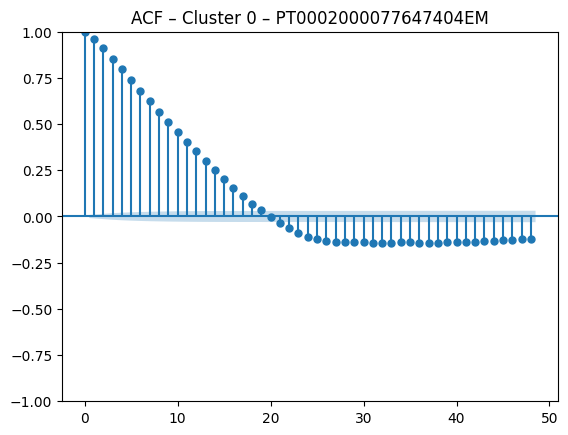

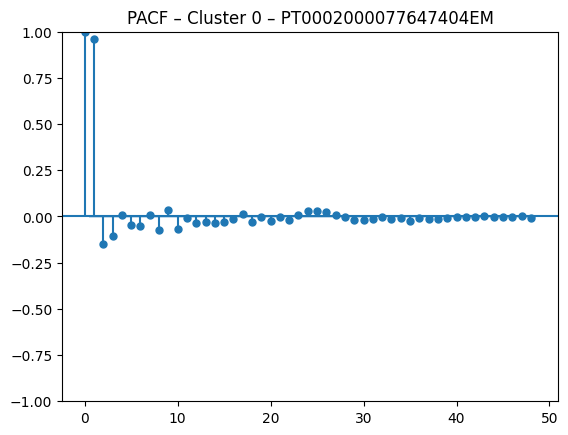

CPE: PT0002000115673471CB


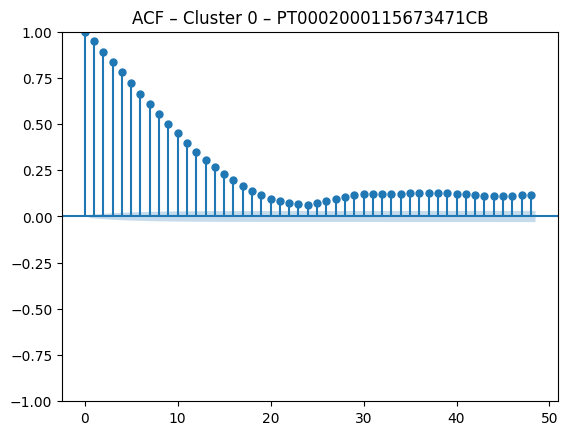

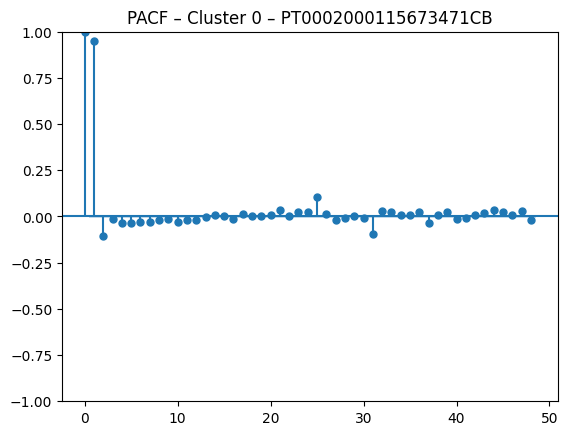


=== Cluster 1 ===
CPE: PT0002000065256275YB


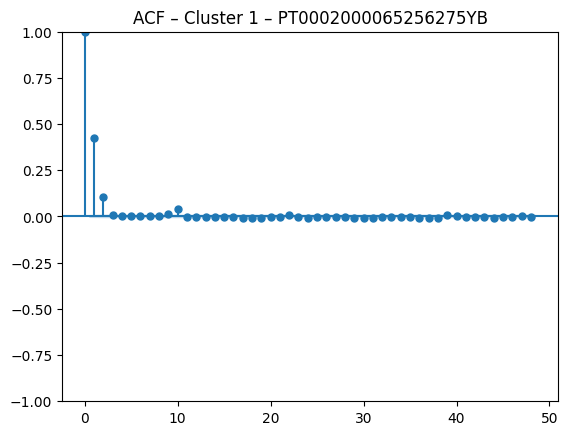

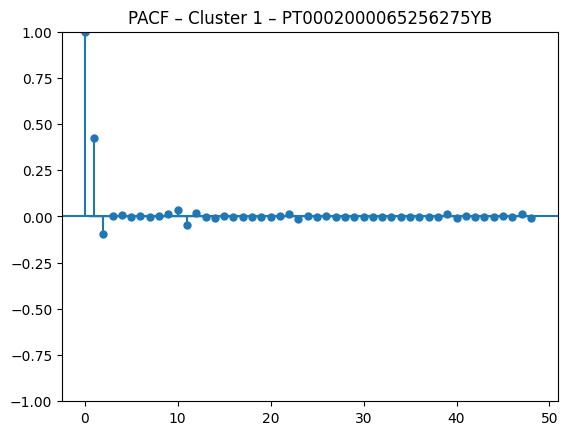

CPE: PT0002000120320157HF


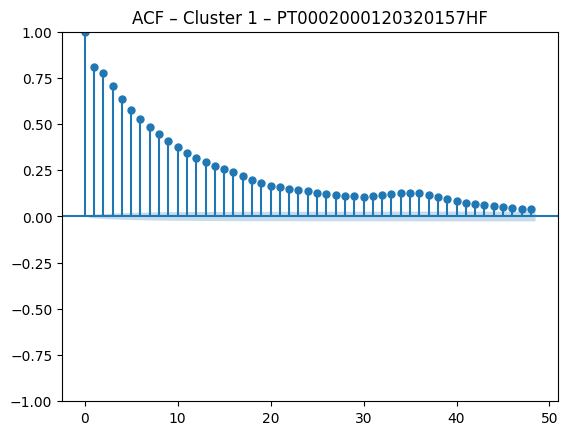

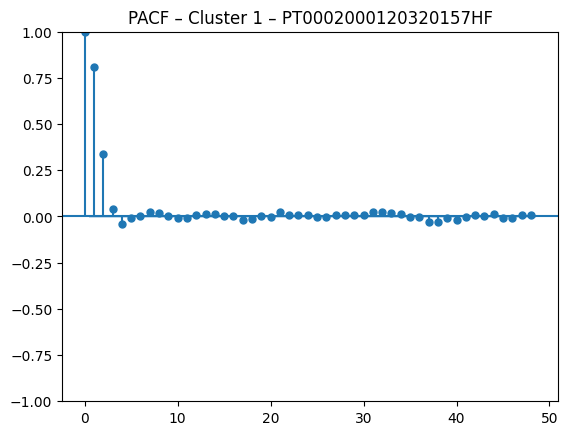


=== Cluster 2 ===
CPE: PT0002000068859393XH


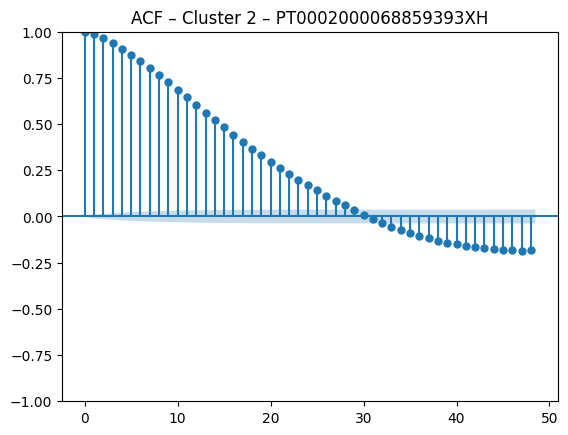

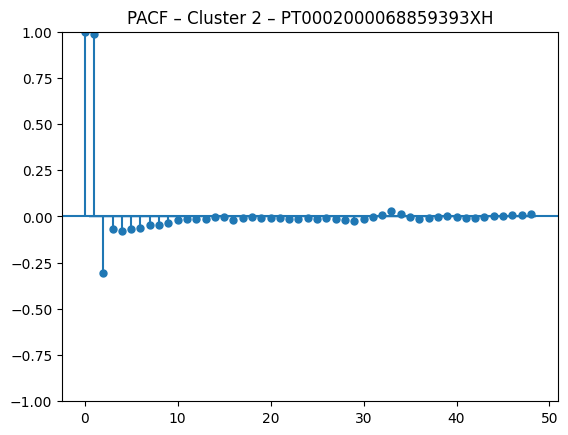

CPE: PT0002000068859325FL


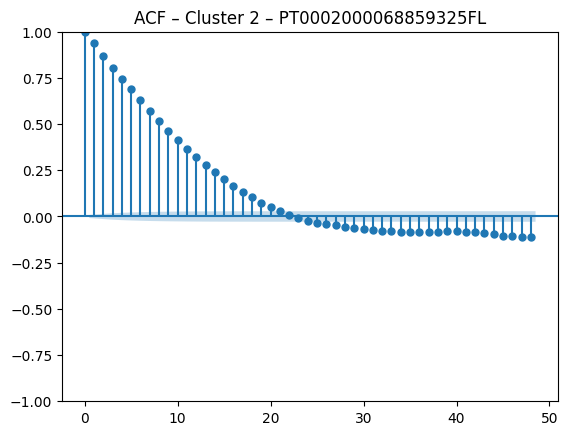

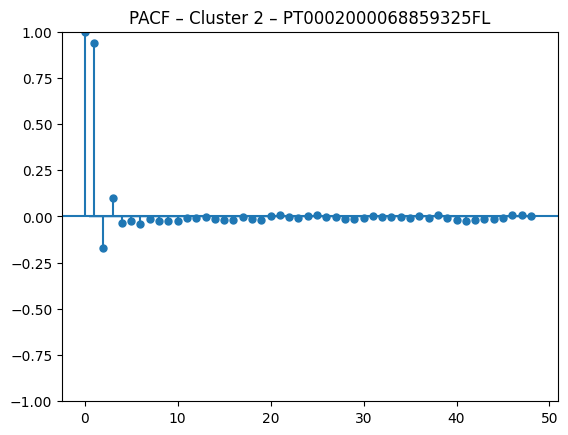

In [53]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Agrupar CPEs por cluster
cpes_por_cluster = defaultdict(list)

for cpe in df_arima.keys():
    cluster = cluster_por_cpe.get(cpe)
    if cluster is not None:
        cpes_por_cluster[cluster].append(cpe)

# Escolher 2 CPEs aleatórios por cluster
cpes_escolhidos = {}

for cluster, cpes in cpes_por_cluster.items():
    if len(cpes) >= 2:
        cpes_escolhidos[cluster] = random.sample(cpes, 2)
    else:
        cpes_escolhidos[cluster] = cpes

# O código percorre os CPEs escolhidos e gera dois gráficos essenciais para a modelação ARIMA
# ACF (Função de Autocorrelação)
# PACF (Função de Autocorrelação Parcial)
for cluster, lista_cpes in cpes_escolhidos.items():
    print(f"\n=== Cluster {cluster} ===")

    for cpe in lista_cpes:
        ts = df_arima[cpe]["treino"]["PotActiva"].dropna()

        if len(ts) < 30:
            continue

        print(f"CPE: {cpe}")

        plot_acf(ts)
        plt.title(f"ACF – Cluster {cluster} – {cpe}")
        plt.show()

        plot_pacf(ts)
        plt.title(f"PACF – Cluster {cluster} – {cpe}")
        plt.show()

##### encontrar melhor arima sem exorgenos (sem normalização)

In [54]:
cpes_por_cluster = defaultdict(list)

for cpe, cluster in cluster_por_cpe.items():
    cpes_por_cluster[cluster].append(cpe)

# intervalos para os valores de p e q
p_range = [1, 2, 3, 4, 5]
q_range = [1, 2, 3]
d = 0

best_order_cluster = {} # lista para guardar resultados

# correr cada cluster e cpe
for cluster, cpes_cluster in cpes_por_cluster.items():
    print(f"\n=== Cluster {cluster} ===")

    df_list = []

    # escolher 5 CPEs (ou menos se não houver)
    limit = min(len(cpes_cluster), 5)

    for cpe in cpes_cluster[:limit]:
        # Assumindo que df_arima[cpe] é um DataFrame/Series com índice temporal correto
        y = df_arima[cpe]["treino"]["PotActiva"].astype(float)
        df_list.append(y)

    if not df_list:
        continue

   # Criar a Série Média do Cluster (Centróide)
    y_cluster_mean = pd.concat(df_list, axis=1, join="inner").mean(axis=1)

    best_aic = np.inf
    best_order = None

    # Grid Search na Série Média
    for p, q in itertools.product(p_range, q_range):
        try:
            # ARIMA na média do cluster elimina o problema dos saltos artificiais
            model = ARIMA(y_cluster_mean, order=(p, d, q))
            results = model.fit()

            print(f"Cluster {cluster} | ARIMA({p},{d},{q}) - AIC: {results.aic:.2f}")

            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)

        except Exception as e:
            continue
    
    # print do melhor por cada cluster
    best_order_cluster[cluster] = best_order
    print(f"--> Vencedor Cluster {cluster}: {best_order}")
  


=== Cluster 0 ===
Cluster 0 | ARIMA(1,0,1) - AIC: 52115.12
Cluster 0 | ARIMA(1,0,2) - AIC: 51948.38
Cluster 0 | ARIMA(1,0,3) - AIC: 51879.77
Cluster 0 | ARIMA(2,0,1) - AIC: 52074.72
Cluster 0 | ARIMA(2,0,2) - AIC: 50852.05
Cluster 0 | ARIMA(2,0,3) - AIC: 51930.71
Cluster 0 | ARIMA(3,0,1) - AIC: 50876.05
Cluster 0 | ARIMA(3,0,2) - AIC: 50897.37
Cluster 0 | ARIMA(3,0,3) - AIC: 50847.00
Cluster 0 | ARIMA(4,0,1) - AIC: 50854.30
Cluster 0 | ARIMA(4,0,2) - AIC: 50868.16
Cluster 0 | ARIMA(4,0,3) - AIC: 51135.63
Cluster 0 | ARIMA(5,0,1) - AIC: 50810.87
Cluster 0 | ARIMA(5,0,2) - AIC: 50857.46
Cluster 0 | ARIMA(5,0,3) - AIC: 50879.68
--> Vencedor Cluster 0: (5, 0, 1)

=== Cluster 1 ===
Cluster 1 | ARIMA(1,0,1) - AIC: -29736.02
Cluster 1 | ARIMA(1,0,2) - AIC: -30135.69
Cluster 1 | ARIMA(1,0,3) - AIC: -30176.15
Cluster 1 | ARIMA(2,0,1) - AIC: -30439.02
Cluster 1 | ARIMA(2,0,2) - AIC: -30438.23
Cluster 1 | ARIMA(2,0,3) - AIC: -30466.01
Cluster 1 | ARIMA(3,0,1) - AIC: -30438.38
Cluster 1 | ARIMA(3

In [55]:

resultados_arima = {} # dicionario para conter resultados do arima

for cpe, dados in df_arima.items():

    # dados de treino e teste
    y_train = dados["treino"]["PotActiva"].astype(float)
    y_test  = dados["teste"]["PotActiva"].astype(float)
    
    cluster = cluster_por_cpe[cpe]
    order = best_order_cluster[cluster]

    # segurança básica
    if len(y_train) < 50:
        continue

    # modelo arima usado
    model = ARIMA(
        y_train,
        order=order
    )

    results = model.fit()

    # previsão imediata
    y_pred = results.forecast(steps=len(y_test))
    y_pred.index = y_test.index
    y_true = y_test.to_numpy()
    y_hat  = y_pred.to_numpy()

    # metricas de avaliacao/erro
    mae  = mean_absolute_error(y_true, y_hat)
    rmse = np.sqrt(np.mean((y_true - y_hat)**2))


    resultados_arima[cpe] = {
        "real": y_test,
        "previsao": y_pred,
        "mae": mae,
        "rmse": rmse
    }

    # print de resultados para o cpe em causa
    print(f"CPE {cpe} | RMSE: {rmse:.2f} | MAE: {mae:.2f}")
    

Rmse da previsão Arima para o cpe PT0002000032976997LZ:
RMSE: 4.015    ||    MAE: 3.333
Rmse da previsão Arima para o cpe PT0002000032993611ME:
RMSE: 1.084    ||    MAE: 0.785
Rmse da previsão Arima para o cpe PT0002000033016394FN:
RMSE: 1.377    ||    MAE: 0.966
Rmse da previsão Arima para o cpe PT0002000033039837ZH:
RMSE: 2.353    ||    MAE: 1.483
Rmse da previsão Arima para o cpe PT0002000033074862LZ:
RMSE: 7.475    ||    MAE: 5.486
Rmse da previsão Arima para o cpe PT0002000033094187PL:
RMSE: 0.483    ||    MAE: 0.462
Rmse da previsão Arima para o cpe PT0002000033186037TF:
RMSE: 5.705    ||    MAE: 5.178
Rmse da previsão Arima para o cpe PT0002000033254603ZX:
RMSE: 5.322    ||    MAE: 4.214
Rmse da previsão Arima para o cpe PT0002000053093191SV:
RMSE: 0.596    ||    MAE: 0.501
Rmse da previsão Arima para o cpe PT0002000065256275YB:
RMSE: 0.018    ||    MAE: 0.003
Rmse da previsão Arima para o cpe PT0002000065523872AA:
RMSE: 0.114    ||    MAE: 0.076
Rmse da previsão Arima para o cp

In [56]:
# Concatenar todos os valores reais e previsões
todos_reais = np.concatenate([resultados_arima[cpe]["real"] for cpe in resultados_arima])
todas_prev = np.concatenate([resultados_arima[cpe]["previsao"] for cpe in resultados_arima])

# Calcular métricas globais
mae_total = mean_absolute_error(todos_reais, todas_prev)
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))

print(f"ARIMA - MAE total: {mae_total:.2f} | RMSE total: {rmse_total:.2f}")


ARIMA - MAE total: 4.38 | RMSE total: 8.51


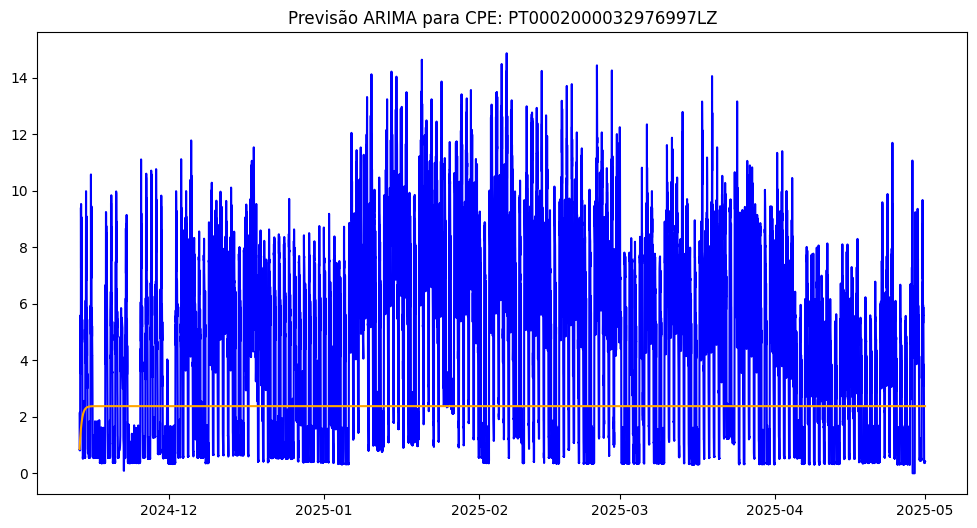

In [57]:
cpe = list(resultados_arima.keys())[0]  #fazer plot para o primeiro cpe

# plot dos resultados do primeiro cpe
plt.figure(figsize=(12,6))
plt.plot(resultados_arima[cpe]["real"], label="Real", color="blue")
plt.plot(resultados_arima[cpe]["previsao"], label="Previsão ARIMA", color="orange")
plt.title(f"Previsão ARIMA para CPE: {cpe}")
plt.show()

##### encontrar melhor sarimax (sem normalização)

In [ ]:
cpes_por_cluster = defaultdict(list)
for cpe, cluster in cluster_por_cpe.items():
    cpes_por_cluster[cluster].append(cpe)

# intervalos para os parametros a testar
p_range = [1, 2, 3, 4, 5]
q_range = [1, 2, 3]
P_range = [0, 1]
Q_range = [0, 1]

d = 0
D = 0
s_range = [0, 96]

best_order_cluster = {}

# ciclo principal
for cluster, cpes_cluster in cpes_por_cluster.items():
    print(f"\n=== Cluster {cluster} ===")

    # --- Y: média do cluster ---
    df_list = []
    limit = min(len(cpes_cluster), 5)
    
    for cpe in cpes_cluster[:limit]:
        y = df_arima[cpe]["treino"]["PotActiva"].astype(float)
        df_list.append(y)

    if not df_list:
        continue

    y_cluster_mean = pd.concat(df_list, axis=1, join="inner").mean(axis=1)

    # --- EXÓGENOS: de um CPE representativo ---
    cpe_ref = cpes_cluster[0]
    X = df_arima[cpe_ref]["treino"][df_arima[cpe_ref]["exogenos_cols"]].astype(float)
    X = X.loc[y_cluster_mean.index]

    best_aic = np.inf
    best_order = None

    # testar todos os parametros para o cluster escolhido
    for p, q, s, P, Q in itertools.product(p_range, q_range, s_range, P_range, Q_range):
        try:
            # modelo com os parametros
            model = SARIMAX(
                y_cluster_mean,
                exog=X,
                order=(p, d, q),
                seasonal_order=(P, D, Q, 0),
                enforce_stationarity=True,
                enforce_invertibility=False
            )

            # resultados do modelo testado
            results = model.fit(disp=False)

            print(
                f"Cluster {cluster} | "
                f"SARIMAX({p},{d},{q})x({P},{D},{Q},{s}) "
                f"AIC={results.aic:.2f}"
            )

            # se for melhor que o atual melhor, guarda este
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = ((p, d, q), (P, D, Q, s))

        except Exception:
            continue
    # imprimir o melhor final
    best_order_cluster[cluster] = best_order
    print(f"--> Vencedor Cluster {cluster}: {best_order}")



=== Cluster 0 ===
Cluster 0 | SARIMAX(1,0,1)x(0,0,0,0) AIC=50109.19
Cluster 0 | SARIMAX(1,0,1)x(0,0,0,96) AIC=50109.19
Cluster 0 | SARIMAX(1,0,2)x(0,0,0,0) AIC=50107.93
Cluster 0 | SARIMAX(1,0,2)x(0,0,0,96) AIC=50107.93
Cluster 0 | SARIMAX(1,0,3)x(0,0,0,0) AIC=50105.89
Cluster 0 | SARIMAX(1,0,3)x(0,0,0,96) AIC=50105.89
Cluster 0 | SARIMAX(2,0,1)x(0,0,0,0) AIC=50091.30
Cluster 0 | SARIMAX(2,0,1)x(0,0,0,96) AIC=50091.30
Cluster 0 | SARIMAX(2,0,2)x(0,0,0,0) AIC=50096.70
Cluster 0 | SARIMAX(2,0,2)x(0,0,0,96) AIC=50096.70
Cluster 0 | SARIMAX(2,0,3)x(0,0,0,0) AIC=50097.48
Cluster 0 | SARIMAX(2,0,3)x(0,0,0,96) AIC=50097.48
Cluster 0 | SARIMAX(3,0,1)x(0,0,0,0) AIC=50095.99
Cluster 0 | SARIMAX(3,0,1)x(0,0,0,96) AIC=50095.99
Cluster 0 | SARIMAX(3,0,2)x(0,0,0,0) AIC=50098.64
Cluster 0 | SARIMAX(3,0,2)x(0,0,0,96) AIC=50098.64
Cluster 0 | SARIMAX(3,0,3)x(0,0,0,0) AIC=50093.83
Cluster 0 | SARIMAX(3,0,3)x(0,0,0,96) AIC=50093.83
Cluster 0 | SARIMAX(4,0,1)x(0,0,0,0) AIC=50097.68
Cluster 0 | SARIMAX(4,

In [ ]:
resultados_sarimax = {} # dicionario para conter resultados do arima

for cpe, dados in df_arima.items():
    cluster = cluster_por_cpe[cpe]
    best = best_order_cluster.get(cluster)

    if best is None:
        continue

    order, seasonal_order = best

    # dados de treino e teste
    y_train = dados["treino"]["PotActiva"].astype(float)
    y_test  = dados["teste"]["PotActiva"].astype(float)

    X_train = dados["treino"][dados["exogenos_cols"]].astype(float)
    X_test  = dados["teste"][dados["exogenos_cols"]].astype(float)

    # alinhamento defensivo
    X_train = X_train.loc[y_train.index]
    X_test  = X_test.loc[y_test.index]

    # modelo sarimax usado com os melhores parametros
    model = SARIMAX(
        y_train,
        exog=X_train,
        order=order,
        seasonal_order=seasonal_order,
        enforce_stationarity=True,
        enforce_invertibility=False
    )

    results = model.fit(disp=False)

    # previsão imediata
    y_pred = results.forecast(
        steps=len(y_test),
        exog=X_test
    )
    y_pred.index = y_test.index

    # metricas de avaliacao/erro
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(np.mean((y_test - y_pred)**2))


    resultados_sarimax[cpe] = {
        "real": y_test,
        "previsao": y_pred,
        "rmse": rmse,
        "mae": mae
    }

    # print de resultados para o cpe em causa
    print(f"CPE: {cpe} | RMSE: {rmse:.2f} | MAE: {mae:.2f}")
    

Rmse da previsão Srimax para o cpe PT0002000032976997LZ:
RMSE: 2.537    ||    MAE: 2.064
Rmse da previsão Srimax para o cpe PT0002000032993611ME:
RMSE: 0.322    ||    MAE: 0.214
Rmse da previsão Srimax para o cpe PT0002000033016394FN:
RMSE: 1.033    ||    MAE: 0.771
Rmse da previsão Srimax para o cpe PT0002000033039837ZH:
RMSE: 1.593    ||    MAE: 1.047
Rmse da previsão Srimax para o cpe PT0002000033074862LZ:
RMSE: 4.467    ||    MAE: 3.074
Rmse da previsão Srimax para o cpe PT0002000033094187PL:
RMSE: 0.360    ||    MAE: 0.217
Rmse da previsão Srimax para o cpe PT0002000033186037TF:
RMSE: 0.768    ||    MAE: 0.451
Rmse da previsão Srimax para o cpe PT0002000033254603ZX:
RMSE: 3.203    ||    MAE: 2.300
Rmse da previsão Srimax para o cpe PT0002000053093191SV:
RMSE: 0.389    ||    MAE: 0.281
Rmse da previsão Srimax para o cpe PT0002000065256275YB:
RMSE: 0.012    ||    MAE: 0.002
Rmse da previsão Srimax para o cpe PT0002000065523872AA:
RMSE: 0.084    ||    MAE: 0.053
Rmse da previsão Srim

In [60]:
# Concatenar todos os valores reais e previsões
todos_reais = np.concatenate([resultados_sarimax[cpe]["real"] for cpe in resultados_sarimax])
todas_prev = np.concatenate([resultados_sarimax[cpe]["previsao"] for cpe in resultados_sarimax])

# Calcular métricas globais
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
mae_total = mean_absolute_error(todos_reais, todas_prev)

print(f"SARIMAX - MAE total: {mae_total:.2f} | RMSE total: {rmse_total:.2f}")

SARIMAX - MAE total: 2.91 | RMSE total: 6.31


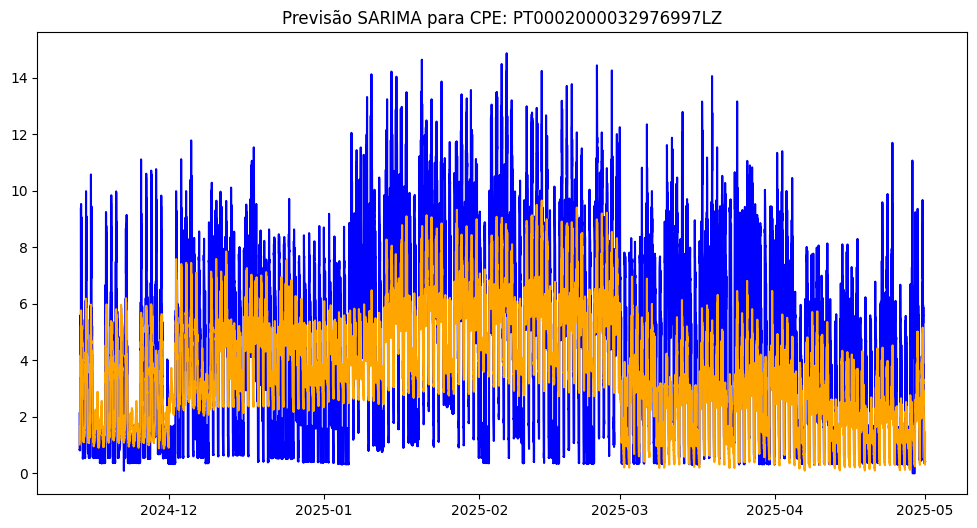

In [ ]:
cpe = list(resultados_sarimax.keys())[0]  #fazer plot para o primeiro cpe

# plot para resultados do cpe em causa
plt.figure(figsize=(12,6))
plt.plot(resultados_sarimax[cpe]["real"], label="Real", color="blue")
plt.plot(resultados_sarimax[cpe]["previsao"], label="Previsão SARIMA", color="orange")
plt.title(f"Previsão SARIMA para CPE: {cpe}")
plt.show()

##### encontrar melhor Arima sem exorgenos (com normalização)

In [62]:
# intervalos para os valores de p e q
p_range = [1, 2, 3, 4, 5]
q_range = [1, 2, 3]
d = 0

best_order_cluster_norm = {}

print("\n--- Grid Search (Dados Normalizados) ---")

# correr cada cluster e cpe
for cluster, cpes_cluster in cpes_por_cluster.items():
    print(f"\n=== Cluster {cluster} (Normalizado) ===")

    df_list = []
    limit = min(len(cpes_cluster), 5)

    # AQUI MUDAMOS: Vamos buscar os dados a df_arima_norm
    for cpe in cpes_cluster[:limit]:
        if cpe in df_arima_norm:
            # Pegar na série já normalizada
            y = df_arima_norm[cpe]["treino"]["PotActiva"].astype(float)
            df_list.append(y)

    if not df_list:
        continue

    # Criar a Série Média do Cluster (Agora é uma média de séries normalizadas)
    y_cluster_mean = pd.concat(df_list, axis=1, join="inner").mean(axis=1)

    best_aic = np.inf
    best_order = None

    for p, q in itertools.product(p_range, q_range):
        try:
            # Ajuste do modelo
            model = ARIMA(y_cluster_mean, order=(p, d, q))
            results = model.fit()

            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)

        except Exception as e:
            continue
            
        print(f"Cluster {cluster} | ARIMA({p},{d},{q}) - AIC: {results.aic:.2f}")

    # print do melhor por cada cluster
    best_order_cluster_norm[cluster] = best_order
    print(f"--> Vencedor Cluster {cluster} (Norm): {best_order} | AIC: {best_aic:.2f}")
    


--- Grid Search (Dados Normalizados) ---

=== Cluster 0 (Normalizado) ===
Cluster 0 | ARIMA(1,0,1) - AIC: -29422.30
Cluster 0 | ARIMA(1,0,2) - AIC: -29523.91
Cluster 0 | ARIMA(1,0,3) - AIC: -29599.27
Cluster 0 | ARIMA(2,0,1) - AIC: -29468.84
Cluster 0 | ARIMA(2,0,2) - AIC: -30476.62
Cluster 0 | ARIMA(2,0,3) - AIC: -30205.20
Cluster 0 | ARIMA(3,0,1) - AIC: -30399.06
Cluster 0 | ARIMA(3,0,2) - AIC: -29495.14
Cluster 0 | ARIMA(3,0,3) - AIC: -30462.36
Cluster 0 | ARIMA(4,0,1) - AIC: -30472.92
Cluster 0 | ARIMA(4,0,2) - AIC: -30314.32
Cluster 0 | ARIMA(4,0,3) - AIC: -29495.94
Cluster 0 | ARIMA(5,0,1) - AIC: -30512.94
Cluster 0 | ARIMA(5,0,2) - AIC: -30469.43
Cluster 0 | ARIMA(5,0,3) - AIC: -30335.11
--> Vencedor Cluster 0 (Norm): (5, 0, 1) | AIC: -30512.94

=== Cluster 1 (Normalizado) ===
Cluster 1 | ARIMA(1,0,1) - AIC: -29853.29
Cluster 1 | ARIMA(1,0,2) - AIC: -30355.61
Cluster 1 | ARIMA(1,0,3) - AIC: -30365.24
Cluster 1 | ARIMA(2,0,1) - AIC: -29658.34
Cluster 1 | ARIMA(2,0,2) - AIC: -305

In [63]:
resultados_arima_norm = {}


for cpe, dados in df_arima_norm.items():
    
    # Dados Normalizados (para o TREINO)
    y_train = dados["treino"]["PotActiva"].astype(float)
    y_test_norm = dados["teste"]["PotActiva"].astype(float)
    
    # Recuperar o scaler específico deste CPE
    scaler = dados["scaler"]

    # Definir Ordem (Idealmente dinâmica pelo cluster, ou fixa)
    order = (5, 0, 1) # Usando a fixa temporariamente como no teu exemplo

    # Segurança básica
    if len(y_train) < 30:
        continue

    try:
        # Treinar (com dados NORMALIZADOS)
        model = ARIMA(y_train, order=order)
        results = model.fit()

        # Previsão (sai na escala NORMALIZADA)
        forecast_norm = results.forecast(steps=len(y_test_norm))
        
        # Previsão Real
        pred_values_real = scaler.inverse_transform(
            forecast_norm.values.reshape(-1, 1)
        ).flatten()
        
        # Teste Real (Watts) - Recuperamos o valor original para comparar
        real_values_test = scaler.inverse_transform(
            y_test_norm.values.reshape(-1, 1)
        ).flatten()

        # Criar Series Pandas para manter as datas (importante para gráficos)
        y_pred_final = pd.Series(pred_values_real, index=y_test_norm.index)
        y_real_final = pd.Series(real_values_test, index=y_test_norm.index)

        # Calcular Erros (Agora em Watts Reais)
        mae  = mean_absolute_error(y_real_final, y_pred_final)
        rmse = np.sqrt(np.mean((y_real_final - y_pred_final)**2))

        # Guardar resultados
        resultados_arima_norm[cpe] = {
            "real": y_real_final,      # Guardamos o valor em Watts
            "previsao": y_pred_final,  # Guardamos a previsão em Watts
            "rmse": rmse,
            "mae": mae,           
        }

        # Print de controlo
        print(f"CPE: {cpe} | RMSE: {rmse:.2f} | MAE: {mae:.2f}")
    
    except Exception as e:
        print(f"Erro no CPE {cpe}: {e}")
        continue
        


CPE: PT0002000032976997LZ | RMSE: 4.01 | MAE: 3.33
CPE: PT0002000032993611ME | RMSE: 1.08 | MAE: 0.78
CPE: PT0002000033016394FN | RMSE: 1.37 | MAE: 0.97
CPE: PT0002000033039837ZH | RMSE: 2.30 | MAE: 1.58
CPE: PT0002000033074862LZ | RMSE: 7.49 | MAE: 5.46
CPE: PT0002000033094187PL | RMSE: 0.48 | MAE: 0.46
CPE: PT0002000033186037TF | RMSE: 5.71 | MAE: 5.19
CPE: PT0002000033254603ZX | RMSE: 5.34 | MAE: 4.20
CPE: PT0002000053093191SV | RMSE: 0.60 | MAE: 0.50
CPE: PT0002000065256275YB | RMSE: 0.02 | MAE: 0.00
CPE: PT0002000065523872AA | RMSE: 0.11 | MAE: 0.08
CPE: PT0002000068856655YV | RMSE: 2.03 | MAE: 1.61
CPE: PT0002000068856781NM | RMSE: 3.87 | MAE: 2.82
CPE: PT0002000068856872QG | RMSE: 0.56 | MAE: 0.27
CPE: PT0002000068856906VS | RMSE: 2.76 | MAE: 2.30
CPE: PT0002000068856952LS | RMSE: 1.16 | MAE: 0.76
CPE: PT0002000068857099AR | RMSE: 3.89 | MAE: 2.49
CPE: PT0002000068857897ZV | RMSE: 10.36 | MAE: 7.85
CPE: PT0002000068857909SY | RMSE: 5.06 | MAE: 4.56
CPE: PT0002000068859187RL | RM

In [64]:
# Concatenar todos os valores reais e previsões
todos_reais = np.concatenate([resultados_arima_norm[cpe]["real"] for cpe in resultados_arima_norm])
todas_prev = np.concatenate([resultados_arima_norm[cpe]["previsao"] for cpe in resultados_arima_norm])

# Calcular métricas globais
mae_total = mean_absolute_error(todos_reais, todas_prev)
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
print(f"ARIMA Normalizado - MAE total: {mae_total:.2f}, RMSE total: {rmse_total:.2f}")

ARIMA Normalizado - MAE total: 4.38, RMSE total: 8.56


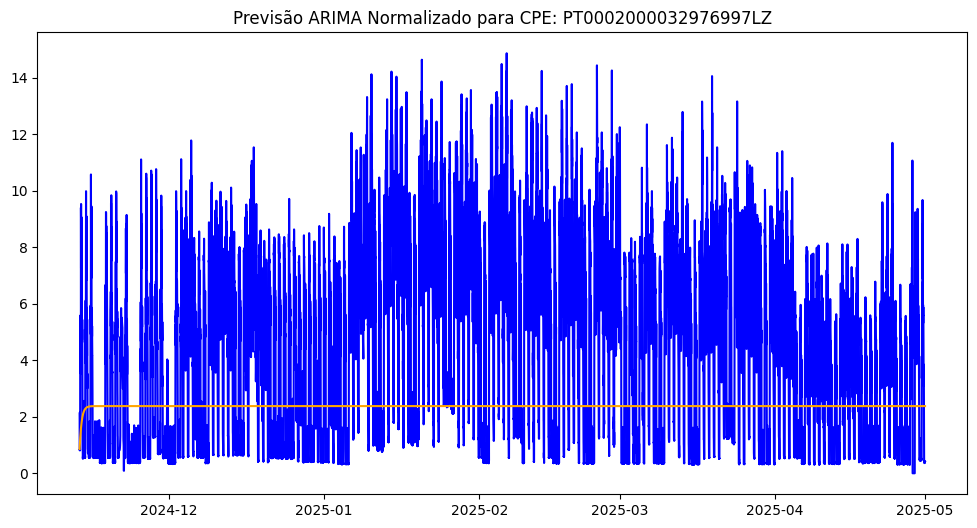

In [ ]:
cpe = list(resultados_arima_norm.keys())[0]  #fazer plot para o primeiro cpe

# plot de resultados para o cpe em causa
plt.figure(figsize=(12,6))
plt.plot(resultados_arima_norm[cpe]["real"], label="Real", color="blue")
plt.plot(resultados_arima_norm[cpe]["previsao"], label="Previsão ARIMA Normalizado", color="orange")
plt.title(f"Previsão ARIMA Normalizado para CPE: {cpe}")
plt.show()

##### encontrar melhor sarima com exogenos (com normalização)

In [ ]:
# Intervalos para os valores de p e q
p_range = [1, 2, 3, 4, 5]
q_range = [1, 2, 3]
P = 0
Q = 0

d = 0
D = 0
s_range = [0, 96]



best_config_cluster_norm = {}

print("\n--- Grid Search SARIMAX (Dados Normalizados + Exógenas) ---")

for cluster, cpes_cluster in cpes_por_cluster.items():
    print(f"\n=== Cluster {cluster} (Normalizado) ===")

    df_list_y = []
    
    # Precisamos de um CPE de referência para ir buscar as colunas Exógenas
    cpe_ref = None 

    limit = min(len(cpes_cluster), 5)

    # Coletar os Y (PotActiva) normalizados
    for cpe in cpes_cluster[:limit]:
        if cpe in df_arima_norm:
            y = df_arima_norm[cpe]["treino"]["PotActiva"].astype(float)
            df_list_y.append(y)
            if cpe_ref is None:
                cpe_ref = cpe

    if not df_list_y:
        continue

    # Criar a Série Média do Cluster (Target)
    # Usamos o join='inner' para garantir que as datas batem certo
    y_cluster_mean = pd.concat(df_list_y, axis=1, join="inner").mean(axis=1)

    # Preparar as Exógenas (X) para o mesmo intervalo de tempo
    # Vamos buscar as colunas exógenas do primeiro CPE e filtramos pelo índice da média
    cols_exog = df_arima_norm[cpe_ref]["exogenos_cols"]
    
    # Extrair dataframe de exógenas
    exog_cluster = df_arima_norm[cpe_ref]["treino"][cols_exog].loc[y_cluster_mean.index]
    
    # Garantir que é numérico
    exog_cluster = exog_cluster.astype(float)

    best_aic = np.inf
    best_order = None
    best_seasonal_order = None

    # Loop Grid Search
    for p, q, s in itertools.product(p_range, q_range, s_range):
        try:
 
            model = SARIMAX(
                endog=y_cluster_mean,
                exog=exog_cluster,
                order=(p, d, q),
                seasonal_order=(P, D, Q, s),
                enforce_stationarity=True,
                enforce_invertibility=False
            )
            
            # disp=False para não encher o ecrã de logs
            results = model.fit(disp=False, method='bfgs', maxiter=50)

            print(f"Cluster {cluster} | SARIMAX({p},{d},{q})x({P},{D},{Q},{s}) - AIC: {results.aic:.2f}")

            # se for melhor guarda
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_seasonal_order = (P, D, Q, s)

        except Exception as e:
            print(f"Erro na combinação {p},{d},{q}: {e}")
            continue
            
    # guardar o melhor para este cluster 
    best_config_cluster_norm[cluster] = {
        "order": best_order,
        "seasonal_order": best_seasonal_order,
        "exog_cols": cols_exog # Guardamos quais colunas foram usadas
    }
    
    print(f"--> Vencedor Cluster {cluster}: Order {best_order} | AIC: {best_aic:.2f}")
    


--- Grid Search SARIMAX (Dados Normalizados + Exógenas) ---

=== Cluster 0 (Normalizado) ===
Cluster 0 | SARIMAX(1,0,1)x(0,0,0,0) - AIC: -31930.66
Cluster 0 | SARIMAX(1,0,1)x(0,0,0,96) - AIC: -31930.66
Cluster 0 | SARIMAX(1,0,2)x(0,0,0,0) - AIC: -31929.95
Cluster 0 | SARIMAX(1,0,2)x(0,0,0,96) - AIC: -31929.95
Cluster 0 | SARIMAX(1,0,3)x(0,0,0,0) - AIC: -31936.69
Cluster 0 | SARIMAX(1,0,3)x(0,0,0,96) - AIC: -31936.69
Cluster 0 | SARIMAX(2,0,1)x(0,0,0,0) - AIC: -31907.78
Cluster 0 | SARIMAX(2,0,1)x(0,0,0,96) - AIC: -31907.78
Cluster 0 | SARIMAX(2,0,2)x(0,0,0,0) - AIC: -31718.96
Cluster 0 | SARIMAX(2,0,2)x(0,0,0,96) - AIC: -31718.96
Cluster 0 | SARIMAX(2,0,3)x(0,0,0,0) - AIC: -31845.01
Cluster 0 | SARIMAX(2,0,3)x(0,0,0,96) - AIC: -31845.01
Cluster 0 | SARIMAX(3,0,1)x(0,0,0,0) - AIC: -30654.91
Cluster 0 | SARIMAX(3,0,1)x(0,0,0,96) - AIC: -30654.91
Cluster 0 | SARIMAX(3,0,2)x(0,0,0,0) - AIC: -31786.54
Cluster 0 | SARIMAX(3,0,2)x(0,0,0,96) - AIC: -31786.54
Cluster 0 | SARIMAX(3,0,3)x(0,0,0,

In [67]:
resultados_sarimax_norm = {}

for cpe, dados in df_arima_norm.items():
    
    # Recuperar a melhor configuração do cluster
    cluster = cluster_por_cpe.get(cpe)
    best_config = best_config_cluster_norm.get(cluster)

    if best_config is None:
        print(f"CPE {cpe}: Configuração não encontrada para cluster {cluster}")
        continue

    # Extrair os parâmetros do dicionário (Ajuste Técnico aqui)
    order = best_config["order"]
    seasonal_order = best_config["seasonal_order"]
    
    # Preparar Dados (Normalizados)
    y_train = dados["treino"]["PotActiva"].astype(float)
    y_test  = dados["teste"]["PotActiva"].astype(float)

    # Filtrar colunas exógenas
    cols_exog = dados["exogenos_cols"]
    X_train = dados["treino"][cols_exog].astype(float)
    X_test  = dados["teste"][cols_exog].astype(float)

    # Alinhamento defensivo (garantir índices iguais)
    X_train = X_train.loc[y_train.index]
    X_test  = X_test.loc[y_test.index]
    
    # Recuperar o Scaler para inverter depois
    scaler = dados["scaler"]

    try:
        # Treinar Modelo (Escala Normalizada)
        model = SARIMAX(
            y_train,
            exog=X_train,
            order=order,
            seasonal_order=seasonal_order, # Agora ja entra aqui correto
            enforce_stationarity=True,
            enforce_invertibility=False
        )

        # maxiter=50 ajuda a nao ficar preso infinitamente
        results = model.fit(disp=False, method='bfgs', maxiter=50)

        # Previsão (Sai na Escala Normalizada)
        forecast_norm = results.forecast(
            steps=len(y_test),
            exog=X_test
        )
        
        
        # Inverter Previsao
        pred_real_vals = scaler.inverse_transform(
            forecast_norm.values.reshape(-1, 1)
        ).flatten()
        
        # Inverter Dados Reais de Teste (para comparacao justa)
        y_test_real_vals = scaler.inverse_transform(
            y_test.values.reshape(-1, 1)
        ).flatten()

        # Recriar Series Pandas para manter datas
        y_pred_final = pd.Series(pred_real_vals, index=y_test.index)
        y_real_final = pd.Series(y_test_real_vals, index=y_test.index)


        # Calcular metricas de Erros
        rmse = np.sqrt(np.mean((y_real_final - y_pred_final)**2))
        mae  = mean_absolute_error(y_real_final, y_pred_final)

        resultados_sarimax_norm[cpe] = {
            "real": y_real_final,
            "previsao": y_pred_final,
            "rmse": rmse,
            "mae": mae
        }

        print(f"CPE {cpe} | RMSE: {rmse:.2f} | MAE: {mae:.2f} ")
    
    except Exception as e:
        print(f"Erro no CPE {cpe}: {e}")
        continue

CPE PT0002000032976997LZ | RMSE: 2.40 | MAE: 2.01 
CPE PT0002000032993611ME | RMSE: 0.30 | MAE: 0.20 
CPE PT0002000033016394FN | RMSE: 0.92 | MAE: 0.60 
CPE PT0002000033039837ZH | RMSE: 1.55 | MAE: 1.05 
CPE PT0002000033074862LZ | RMSE: 4.11 | MAE: 2.86 
CPE PT0002000033094187PL | RMSE: 0.36 | MAE: 0.24 
CPE PT0002000033186037TF | RMSE: 0.87 | MAE: 0.65 
CPE PT0002000033254603ZX | RMSE: 3.15 | MAE: 2.45 
CPE PT0002000053093191SV | RMSE: 0.41 | MAE: 0.32 
CPE PT0002000065256275YB | RMSE: 0.01 | MAE: 0.00 
CPE PT0002000065523872AA | RMSE: 0.09 | MAE: 0.06 
CPE PT0002000068856655YV | RMSE: 1.60 | MAE: 1.27 
CPE PT0002000068856781NM | RMSE: 3.33 | MAE: 2.05 
CPE PT0002000068856872QG | RMSE: 0.55 | MAE: 0.28 
CPE PT0002000068856906VS | RMSE: 2.64 | MAE: 2.21 
CPE PT0002000068856952LS | RMSE: 0.94 | MAE: 0.70 
CPE PT0002000068857099AR | RMSE: 2.95 | MAE: 2.05 
CPE PT0002000068857897ZV | RMSE: 6.19 | MAE: 4.38 
CPE PT0002000068857909SY | RMSE: 3.84 | MAE: 3.31 
CPE PT0002000068859187RL | RMSE

In [68]:
# Concatenar todos os valores reais e previsões
todos_reais = np.concatenate([resultados_sarimax_norm[cpe]["real"] for cpe in resultados_sarimax_norm])
todas_prev = np.concatenate([resultados_sarimax_norm[cpe]["previsao"] for cpe in resultados_sarimax_norm])

# Calcular métricas globais
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
mae_total = mean_absolute_error(todos_reais, todas_prev)

print(f"SARIMAX - MAE total: {mae_total:.2f} | RMSE total: {rmse_total:.2f}")

SARIMAX - MAE total: 2.63 | RMSE total: 5.45


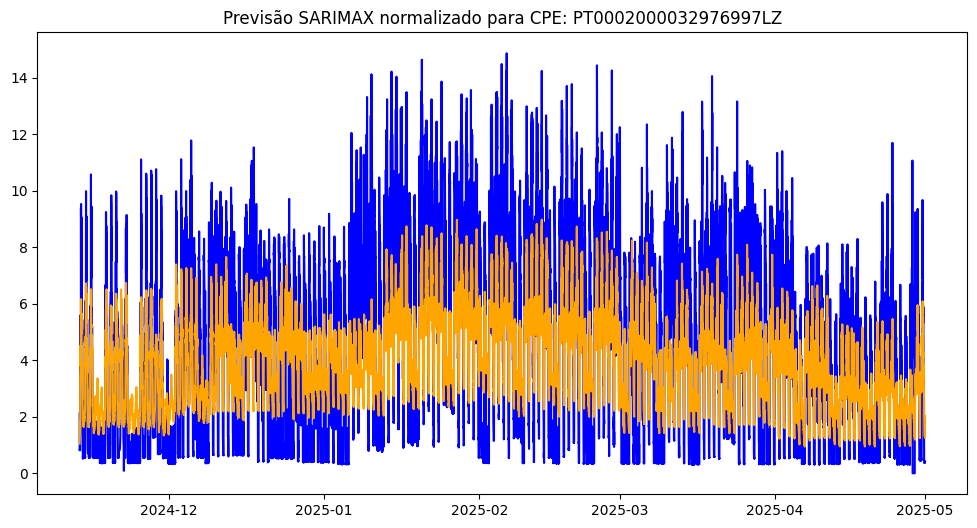

In [69]:
cpe = list(resultados_sarimax_norm.keys())[0]  #fazer plot para o primeiro cpe

# plotar resultados do cpe em causa
plt.figure(figsize=(12,6))
plt.plot(resultados_sarimax_norm[cpe]["real"], label="Real", color="blue")
plt.plot(resultados_sarimax_norm[cpe]["previsao"], label="Previsão SARIMAX normalizado", color="orange")
plt.title(f"Previsão SARIMAX normalizado para CPE: {cpe}")
plt.show()

#### LSTM - Usado com inputs de time-series por CPE

In [70]:
# --- Constantes Iniciais ---
SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

EPOCHS = 30
BATCH_SIZE = 128

cpe_list = df.CPE.unique().tolist()


##### Sem Normalização

In [71]:

modelos_por_cluster = {}

# Obter lista de clusters únicos
clusters_unicos = set(cluster_por_cpe.values())

print(f"--- FASE 1: TREINO POR CLUSTER ---")

for cluster_id in clusters_unicos:
    print(f"\n A processar CLUSTER: {cluster_id}")
    
    # Identificar TODOS os CPEs deste cluster
    todos_cpes_deste_cluster = [cpe for cpe, c in cluster_por_cpe.items() if c == cluster_id]
    total_no_cluster = len(todos_cpes_deste_cluster)
    
    # SELEÇÃO ALEATORIA LOCAL (Dentro do Cluster)
    n_samples = min(10, total_no_cluster)
    cpes_subset = np.random.choice(todos_cpes_deste_cluster, n_samples, replace=False)
        
    X_train_cluster = []
    y_train_cluster = []
    
    # Coletar dados apenas do SUBSET sorteado
    for cpe in cpes_subset:
        try:
            # Chama a função criada anteriormente.
            X_tr, y_tr, _, _, _, _ = preparar_df_lstm(df_lstm=df_lstm, cpe=cpe, normalizar=False)

            # Se houver dados válidos, adiciona à lista
            if len(X_tr) > 0:
                X_train_cluster.append(X_tr)
                y_train_cluster.append(y_tr)
        except:
            # Se um CPE der erro, ignora e passa ao próximo
            continue 
    
    # Segurança: Se a amostragem não retornou dados, salta este cluster
    if not X_train_cluster:
        print(f"Sem dados suficientes para o Cluster {cluster_id}")
        continue

    # Concatenacao
    # Transforma a lista de arrays num unico Dataset para este cluster.
    X_train_final = np.concatenate(X_train_cluster)
    y_train_final = np.concatenate(y_train_cluster)
    
    print(f"Dados acumulados para treino: {X_train_final.shape}")

    # Definir Modelo
    model = Sequential([
        LSTM(32, activation="tanh", 
             input_shape=(X_train_final.shape[1], X_train_final.shape[2]),
             kernel_regularizer=l2(0.01),
             recurrent_regularizer=l2(0.01)),
        Dropout(0.3),
        Dense(1, activation="linear")
    ])
    
    # Configuração do Otimizador
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
    model.compile(optimizer=optimizer, loss="mse", metrics=['mae'])
    
    # Para o treino se o erro de validacao nao baixar durante 4 epocas
    early_stop = EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True)

    # Treino do modelo
    model.fit(
        X_train_final, y_train_final,
        epochs=EPOCHS, 
        batch_size=BATCH_SIZE,
        validation_split=0.1,
        verbose=2,
        callbacks=[early_stop]
    )
    
    # Guardar o melhor do Cluster
    modelos_por_cluster[cluster_id] = model
    
    # LIMPEZA DE MEMÓRIA
    del X_train_final, y_train_final, X_train_cluster, y_train_cluster
    gc.collect()

--- FASE 1: TREINO POR CLUSTER ---

 A processar CLUSTER: 0
Dados acumulados para treino: (552028, 96, 12)
Epoch 1/30
3882/3882 - 46s - 12ms/step - loss: 13.9853 - mae: 1.8249 - val_loss: 14.3268 - val_mae: 1.9666
Epoch 2/30
3882/3882 - 44s - 11ms/step - loss: 13.4220 - mae: 1.7965 - val_loss: 14.6902 - val_mae: 1.9934
Epoch 3/30
3882/3882 - 46s - 12ms/step - loss: 13.1569 - mae: 1.7798 - val_loss: 14.8260 - val_mae: 1.9505
Epoch 4/30
3882/3882 - 42s - 11ms/step - loss: 12.8989 - mae: 1.7634 - val_loss: 14.8804 - val_mae: 1.9588
Epoch 5/30
3882/3882 - 41s - 11ms/step - loss: 12.7574 - mae: 1.7526 - val_loss: 14.7241 - val_mae: 1.9562

 A processar CLUSTER: 1
Dados acumulados para treino: (506597, 96, 12)
Epoch 1/30
3563/3563 - 46s - 13ms/step - loss: 1.1720 - mae: 0.3947 - val_loss: 1.2043 - val_mae: 0.6576
Epoch 2/30
3563/3563 - 43s - 12ms/step - loss: 1.1101 - mae: 0.3875 - val_loss: 1.1945 - val_mae: 0.6514
Epoch 3/30
3563/3563 - 43s - 12ms/step - loss: 1.0986 - mae: 0.3847 - val_lo

In [72]:

resultados_lstm_unscaled = {}

for cpe in cpe_list:
    
    cluster_id = cluster_por_cpe.get(cpe)
    
    if cluster_id not in modelos_por_cluster:
        continue

    print(f"A avaliar CPE: {cpe} (Cluster {cluster_id})")
    
    try:
        # Preparar dados
        # Nota: O scaler retornado aqui e ignorado pois normalizar=False
        _, _, X_test, y_test, _, baseline_test = preparar_df_lstm(df_lstm=df_lstm, cpe=cpe, normalizar=False)
        
        if len(X_test) == 0:
            continue

        model = modelos_por_cluster[cluster_id]

        # Previsao
        # O modelo cospe diretamente o valor residual na escala original
        previsao_unscaled = model.predict(X_test, batch_size=BATCH_SIZE, verbose=0)
        
        # Ajustar shape: O predict devolve (N, 1), queremos apenas (N,) para somar com a baseline
        y_pred_residual = previsao_unscaled.flatten() 
        y_real_residual = y_test.flatten() # O y_test ja e o residual real sem escala

        # Reconstrucao (Soma a Baseline)
        min_len = min(len(baseline_test), len(y_pred_residual))
        
        # Garante que usamos índices numericos para somar arrays numpy
        baseline_slice = baseline_test.values[:min_len] if hasattr(baseline_test, 'values') else baseline_test[:min_len]
        
        previsao = baseline_slice + y_pred_residual[:min_len]
        real_final = baseline_slice + y_real_residual[:min_len]

        # Avaliacao
        mse = mean_squared_error(real_final, previsao)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(real_final, previsao)

        print(f"Antes de clipping: MAE: {mae:.4f} | RMSE: {rmse:.4f}")

        # clip feito para meter valores negativos a zero (nao existem potencias negativas)
        previsao_final = np.clip(previsao, 0, None)

        # metricas de erro
        mse = mean_squared_error(real_final, previsao_final)
        rmse_final = np.sqrt(mse)
        mae_final = mean_absolute_error(real_final, previsao_final)

        print(f"Após clipping: MAE: {mae_final:.4f} | RMSE: {rmse_final:.4f}")

        resultados_lstm_unscaled[cpe] = {
            "real": real_final, 
            "previsao": previsao_final,
            "rmse": rmse_final,
            "mae": mae_final,
            "cluster": cluster_id
        }
        
        gc.collect()

    except Exception as e:
        print(f"Erro no CPE {cpe}: {e}")


tf.keras.backend.clear_session()

A avaliar CPE: PT0002000032976997LZ (Cluster 0)
Antes de clipping: MAE: 1.2545 | RMSE: 1.8780
Após clipping: MAE: 1.2544 | RMSE: 1.8780
A avaliar CPE: PT0002000032993611ME (Cluster 1)
Antes de clipping: MAE: 0.1319 | RMSE: 0.2950
Após clipping: MAE: 0.1318 | RMSE: 0.2950
A avaliar CPE: PT0002000033016394FN (Cluster 1)
Antes de clipping: MAE: 0.4546 | RMSE: 0.8105
Após clipping: MAE: 0.4546 | RMSE: 0.8105
A avaliar CPE: PT0002000033039837ZH (Cluster 1)
Antes de clipping: MAE: 0.6612 | RMSE: 1.2334
Após clipping: MAE: 0.6611 | RMSE: 1.2333
A avaliar CPE: PT0002000033074862LZ (Cluster 0)
Antes de clipping: MAE: 2.0437 | RMSE: 3.5089
Após clipping: MAE: 2.0437 | RMSE: 3.5089
A avaliar CPE: PT0002000033094187PL (Cluster 1)
Antes de clipping: MAE: 0.2075 | RMSE: 0.3372
Após clipping: MAE: 0.2075 | RMSE: 0.3372
A avaliar CPE: PT0002000033186037TF (Cluster 0)
Antes de clipping: MAE: 0.4362 | RMSE: 0.7951
Após clipping: MAE: 0.4362 | RMSE: 0.7951
A avaliar CPE: PT0002000033254603ZX (Cluster 0)


In [115]:
# Concatenar todos os valores reais e previsões
todos_reais = np.concatenate([resultados_lstm_unscaled[cpe]["real"] for cpe in resultados_lstm_unscaled])
todas_prev = np.concatenate([resultados_lstm_unscaled[cpe]["previsao"] for cpe in resultados_lstm_unscaled])

# Calcular métricas globais
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
mae_total = mean_absolute_error(todos_reais, todas_prev)
print(f"LSTM - MAE total: {mae_total:.3f}, RMSE total: {rmse_total:.3f}")

LSTM - MAE total: 1.976, RMSE total: 5.064


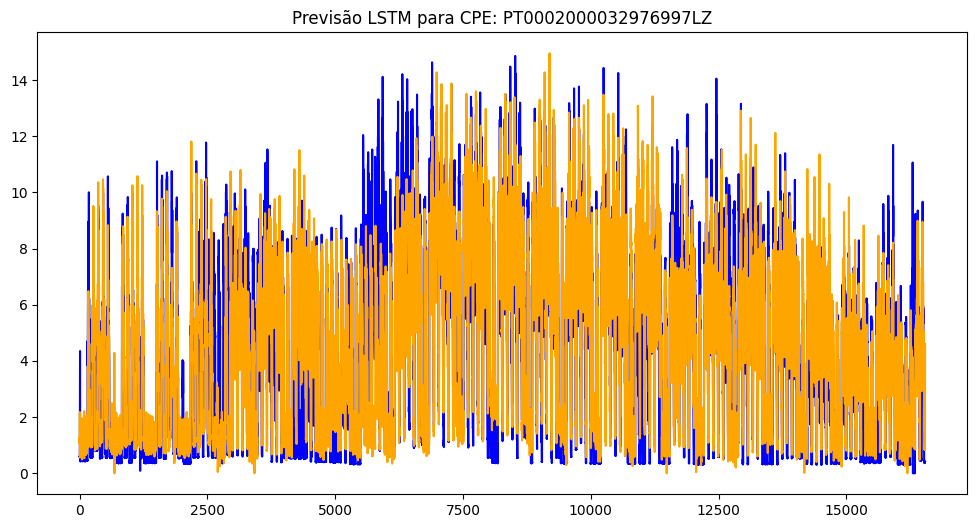

In [74]:
cpe = list(resultados_lstm_unscaled.keys())[0]  #fazer plot para o primeiro cpe

# plotar resultados do cpe em causa
plt.figure(figsize=(12,6))
plt.plot(resultados_lstm_unscaled[cpe]["real"], label="Real", color="blue")
plt.plot(resultados_lstm_unscaled[cpe]["previsao"], label="Previsão LSTM", color="orange")
plt.title(f"Previsão LSTM para CPE: {cpe}")
plt.show()

##### Com normalização

In [75]:

modelos_por_cluster = {}

# Obter lista de clusters unicos
clusters_unicos = set(cluster_por_cpe.values())

print(f"--- FASE 1: TREINO POR CLUSTER ---")

for cluster_id in clusters_unicos:
    print(f"\n A processar CLUSTER: {cluster_id}")
    
    # Identificar TODOS os CPEs deste cluster
    todos_cpes_deste_cluster = [cpe for cpe, c in cluster_por_cpe.items() if c == cluster_id]
    total_no_cluster = len(todos_cpes_deste_cluster)
    
    # SELEÇÃO ALEATORIA LOCAL (Dentro do Cluster)
    n_samples = min(10, total_no_cluster)
    cpes_subset = np.random.choice(todos_cpes_deste_cluster, n_samples, replace=False)
    
    
    print(f"   -> Selecionados {len(cpes_subset)} CPEs de um total de {total_no_cluster}.")

    X_train_cluster = []
    y_train_cluster = []
    
    # Coletar dados apenas do SUBSET sorteado
    for cpe in cpes_subset:
        try:
            # Chama a função criada anteriormente.
            X_tr, y_tr, _, _, _, _ = preparar_df_lstm(df_lstm=df_lstm, cpe=cpe, normalizar=True)
            if len(X_tr) > 0:
                
            # Se houver dados válidos, adiciona à lista
                X_train_cluster.append(X_tr)
                y_train_cluster.append(y_tr)
        except:
            # Se um CPE der erro, ignora e passa ao próximo
            continue 

    # Segurança: Se a amostragem não retornou dados, salta este cluster
    if not X_train_cluster:
        print(f"Sem dados suficientes para o Cluster {cluster_id}")
        continue

    # Concatenacao
    # Transforma a lista de arrays num unico Dataset para este cluster
    X_train_final = np.concatenate(X_train_cluster)
    y_train_final = np.concatenate(y_train_cluster)
    
    print(f"Dados acumulados para treino: {X_train_final.shape}")

    # Definir Modelo
    model = Sequential([
        LSTM(32, activation="tanh", 
             input_shape=(X_train_final.shape[1], X_train_final.shape[2]),
             kernel_regularizer=l2(0.01),
             recurrent_regularizer=l2(0.01)),
        Dropout(0.3),
        Dense(1, activation="linear")
    ])
    
    # Configuração do Otimizador
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
    model.compile(optimizer=optimizer, loss="mse", metrics=['mae'])
    
    # Para o treino se o erro de validacao nao baixar durante 4 epocas
    early_stop = EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True)

    # Treino do modelo
    model.fit(
        X_train_final, y_train_final,
        epochs=EPOCHS, 
        batch_size=BATCH_SIZE,
        validation_split=0.1,
        verbose=2,
        callbacks=[early_stop]
    )

    # Guardar o melhor do Cluster
    modelos_por_cluster[cluster_id] = model
    
    # LIMPEZA DE MEMÓRIA
    del X_train_final, y_train_final, X_train_cluster, y_train_cluster
    gc.collect()

--- FASE 1: TREINO POR CLUSTER ---

 A processar CLUSTER: 0
   -> Selecionados 10 CPEs de um total de 35.
Dados acumulados para treino: (535563, 96, 12)
Epoch 1/30
3766/3766 - 41s - 11ms/step - loss: 0.9140 - mae: 0.5279 - val_loss: 0.8615 - val_mae: 0.5443
Epoch 2/30
3766/3766 - 40s - 11ms/step - loss: 0.8795 - mae: 0.5234 - val_loss: 0.8593 - val_mae: 0.5438
Epoch 3/30
3766/3766 - 41s - 11ms/step - loss: 0.8759 - mae: 0.5221 - val_loss: 0.8592 - val_mae: 0.5435
Epoch 4/30
3766/3766 - 42s - 11ms/step - loss: 0.8732 - mae: 0.5215 - val_loss: 0.8568 - val_mae: 0.5453
Epoch 5/30
3766/3766 - 46s - 12ms/step - loss: 0.8729 - mae: 0.5217 - val_loss: 0.8571 - val_mae: 0.5440
Epoch 6/30
3766/3766 - 43s - 11ms/step - loss: 0.8710 - mae: 0.5210 - val_loss: 0.8552 - val_mae: 0.5454
Epoch 7/30
3766/3766 - 43s - 11ms/step - loss: 0.8700 - mae: 0.5209 - val_loss: 0.8554 - val_mae: 0.5449
Epoch 8/30
3766/3766 - 43s - 11ms/step - loss: 0.8704 - mae: 0.5210 - val_loss: 0.8562 - val_mae: 0.5452
Epoch 9

In [76]:
resultados_lstm_scaled = {}

for cpe in cpe_list:
    
    cluster_id = cluster_por_cpe.get(cpe)
    
    if cluster_id not in modelos_por_cluster:
        continue

    print(f"A avaliar CPE: {cpe} (Cluster {cluster_id})")
    
    try:
        # Preparar dados (Test e Scaler)
        _, _, X_test, y_test, scaler, baseline_test = preparar_df_lstm(df_lstm=df_lstm, cpe=cpe, normalizar=True)
        
        if len(X_test) == 0:
            continue

        model = modelos_por_cluster[cluster_id]

        # Previsao
        previsoes_scaled = model.predict(X_test, batch_size=BATCH_SIZE, verbose=0)
        
        # Inversao
        dummy_pred = pd.DataFrame(np.zeros((len(previsoes_scaled), len(FEATURES) + 1)), columns=[TARGET] + FEATURES)
        dummy_pred[TARGET] = previsoes_scaled
        dummy_pred_inverse = scaler.inverse_transform(dummy_pred)
        y_pred_residual = dummy_pred_inverse[:, 0]

        dummy_real = pd.DataFrame(np.zeros((len(y_test), len(FEATURES) + 1)), columns=[TARGET] + FEATURES)
        dummy_real[TARGET] = y_test
        dummy_real_inverse = scaler.inverse_transform(dummy_real)
        y_real_residual = dummy_real_inverse[:, 0]

        # Reconstrucao (Soma a Baseline)
        min_len = min(len(baseline_test), len(y_pred_residual))
        previsao = baseline_test[:min_len] + y_pred_residual[:min_len]
        real_final = baseline_test[:min_len] + y_real_residual[:min_len]

        # metricas de erro
        mse = mean_squared_error(real_final, previsao)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(real_final, previsao)

        print(f"Antes de clipping: MAE: {mae:.4f} | RMSE: {rmse:.4f}")

        # clip feito para meter valores negativos a zero (nao existem potencias negativas)
        previsao_final = np.clip(previsao, 0, None)

        # metricas de erro
        mse = mean_squared_error(real_final, previsao_final)
        rmse_final = np.sqrt(mse)
        mae_final = mean_absolute_error(real_final, previsao_final)

        print(f"Após clipping: MAE: {mae_final:.4f} | RMSE: {rmse_final:.4f}")

        resultados_lstm_scaled[cpe] = {
            "real": real_final, 
            "previsao": previsao_final,
            "rmse": rmse_final,
            "mae": mae_final,
            "cluster": cluster_id
        }
        
        gc.collect()

    except Exception as e:
        print(f"Erro no CPE {cpe}: {e}")

tf.keras.backend.clear_session()

A avaliar CPE: PT0002000032976997LZ (Cluster 0)
Antes de clipping: MAE: 1.2224 | RMSE: 1.8874
Após clipping: MAE: 1.2223 | RMSE: 1.8874
A avaliar CPE: PT0002000032993611ME (Cluster 1)
Antes de clipping: MAE: 0.1703 | RMSE: 0.3060
Após clipping: MAE: 0.1702 | RMSE: 0.3058
A avaliar CPE: PT0002000033016394FN (Cluster 1)
Antes de clipping: MAE: 0.4709 | RMSE: 0.8126
Após clipping: MAE: 0.4709 | RMSE: 0.8125
A avaliar CPE: PT0002000033039837ZH (Cluster 1)
Antes de clipping: MAE: 0.7347 | RMSE: 1.2889
Após clipping: MAE: 0.7346 | RMSE: 1.2884
A avaliar CPE: PT0002000033074862LZ (Cluster 0)
Antes de clipping: MAE: 2.0158 | RMSE: 3.4486
Após clipping: MAE: 2.0158 | RMSE: 3.4486
A avaliar CPE: PT0002000033094187PL (Cluster 1)
Antes de clipping: MAE: 0.2150 | RMSE: 0.3519
Após clipping: MAE: 0.2150 | RMSE: 0.3519
A avaliar CPE: PT0002000033186037TF (Cluster 0)
Antes de clipping: MAE: 0.3400 | RMSE: 0.7155
Após clipping: MAE: 0.3400 | RMSE: 0.7155
A avaliar CPE: PT0002000033254603ZX (Cluster 0)


In [116]:
# Concatenar todos os valores reais e previsões
todos_reais = np.concatenate([resultados_lstm_scaled[cpe]["real"] for cpe in resultados_lstm_scaled])
todas_prev = np.concatenate([resultados_lstm_scaled[cpe]["previsao"] for cpe in resultados_lstm_scaled])

# Calcular métricas globais
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
mae_total = mean_absolute_error(todos_reais, todas_prev)
print(f"LSTM Normalizado - MAE total: {mae_total:.3f}, RMSE total: {rmse_total:.3f}")

LSTM Normalizado - MAE total: 1.973, RMSE total: 5.016


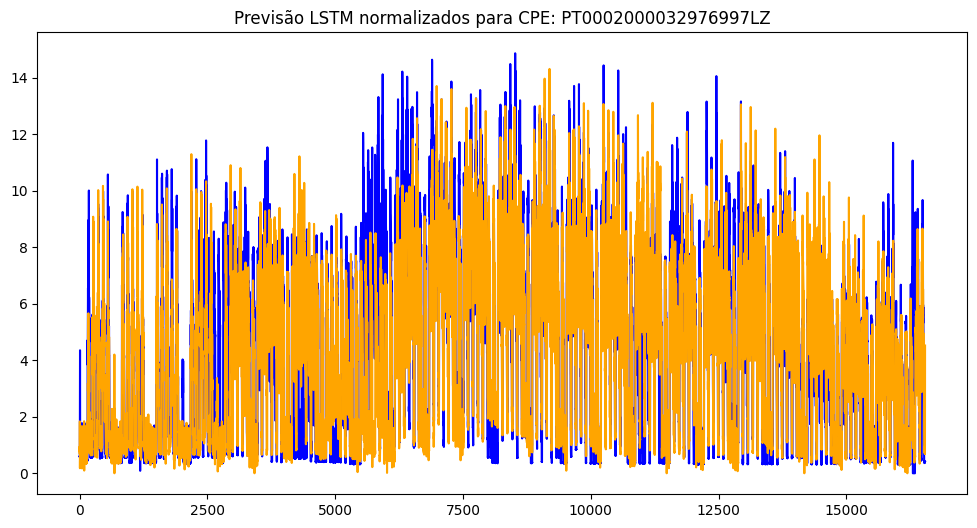

In [78]:
cpe = list(resultados_lstm_scaled.keys())[0]  #fazer plot para o primeiro cpe

# plotar resultados de cpe em causa
plt.figure(figsize=(12,6))
plt.plot(resultados_lstm_scaled[cpe]["real"], label="Real", color="blue")
plt.plot(resultados_lstm_scaled[cpe]["previsao"], label="Previsão LSTM normalizados", color="orange")
plt.title(f"Previsão LSTM normalizados para CPE: {cpe}")
plt.show()

#### XGBoost - Usado com inputs de features-sets por CPE

In [89]:

# Configurações Iniciais
# N_TRIALS: Quantas "receitas" diferentes o Optuna vai testar por cluster.
N_TRIALS = 20

# Escolhemos apenas 5 cpe aleatorios para representar o grupo.
N_CPES_TESTE = 5

# Reorganizar os dados para acesso fácil por Cluster
cpes_by_cluster_id = {}
for cpe, cluster_id in cluster_por_cpe.items():
    if cpe in df_feature_set:
        cpes_by_cluster_id.setdefault(cluster_id, []).append(cpe)

best_params_cluster_xgboost = {}

print(f"--- Iniciando Otimização por Cluster (XGBoost v2 Compatible) ---")

# Loop por Cluster
for cluster_id, lista_cpes in cpes_by_cluster_id.items():
    
    # Selecionar aleatoriamente as "cobaias"  deste cluster
    cpes_selecionados = random.sample(lista_cpes, min(len(lista_cpes), N_CPES_TESTE))
    print(f"\n> Otimizando Cluster {cluster_id} usando: {cpes_selecionados}")

    # Definir a Funcao Objetivo
    # O Optuna vai chamar esta funcao varias vezes com valores diferentes
    def objective(trial):
        params = {
            'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.2, log=True),
            'max_depth': trial.suggest_int('max_depth', 3, 9),
            'subsample': trial.suggest_float('subsample', 0.6, 0.95),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 0.95),
            'min_child_weight': trial.suggest_int('min_child_weight', 1, 7),
            # --- FIXOS ---
            'objective': 'reg:squarederror',
            'n_estimators': 1000, 
            'n_jobs': -1,
            # CORRECAO: O early stopping entra aqui agora
            'early_stopping_rounds': 30
        }
        
        erros_cpes = []
        
        # Testar estes parametros nos 5 cpes
        for cpe in cpes_selecionados:
            dados = df_feature_set[cpe]
            X_t, y_t = dados["X_treino"], dados["y_treino"]
            X_v, y_v = dados["X_teste"], dados["y_teste"]
            
            # Passamos tudo no construtor (**params)
            model = xgb.XGBRegressor(**params)
            
            # Treinar
            model.fit(
                X_t, y_t,
                eval_set=[(X_v, y_v)],
                verbose=False
            )

            # Avaliar
            preds = model.predict(X_v)
            rmse = np.sqrt(mean_squared_error(y_v, preds))
            erros_cpes.append(rmse)
        
        # O resultado deste teste e a MEDIA dos erros das 5 cobaias
        return np.mean(erros_cpes)

    # Executar a Otimizacao
    optuna.logging.set_verbosity(optuna.logging.WARNING) 
    study = optuna.create_study(direction='minimize')
    study.optimize(objective, n_trials=N_TRIALS)
    
    # Guardar os melhores params
    best_params = study.best_params
    best_params.update({
        'objective': 'reg:squarederror',
        'n_estimators': 2000, # Aumentamos para a previsão final (mais capacidade)
        'n_jobs': -1,
        'early_stopping_rounds': 50 # Definimos o valor final aqui
    })
    
    best_params_cluster_xgboost[cluster_id] = best_params
    print(f"  [Cluster {cluster_id}] Melhor RMSE: {study.best_value:.4f}")

print("\n--- Otimização Concluída ---")

--- Iniciando Otimização por Cluster (XGBoost v2 Compatible) ---

> Otimizando Cluster 0 usando: ['PT0002000078294957RQ', 'PT0002000082549706RH', 'PT0002000110607652SB', 'PT0002000078207354XC', 'PT0002000101964938LF']
  [Cluster 0] Melhor RMSE: 2.7221

> Otimizando Cluster 1 usando: ['PT0002000085555547GN', 'PT0002000033094187PL', 'PT0002000123801456QA', 'PT0002000032993611ME', 'PT0002000201936109ME']
  [Cluster 1] Melhor RMSE: 0.5390

> Otimizando Cluster 2 usando: ['PT0002000068859382XF', 'PT0002000077394934QY', 'PT0002000068859325FL', 'PT0002000068859393XH', 'PT0002000081997398TD']
  [Cluster 2] Melhor RMSE: 10.4087

--- Otimização Concluída ---


##### Sem normalização

In [90]:
resultados_xgboost = {}

# Loop principal
for cpe, dados in df_feature_set.items():
    
    cluster_id = cluster_por_cpe.get(cpe)

    # Se este CPE pertence a um cluster que otimizamos, usa os melhores parametros desse cluster.
    if cluster_id is not None and cluster_id in best_params_cluster_xgboost:
        params_usar = best_params_cluster_xgboost[cluster_id].copy()
        origem = f"Cluster {cluster_id}"
    else:
        # se não, usa os seguintes parametros
        params_usar = {
            'n_estimators': 1000, 'learning_rate': 0.05, 'max_depth': 5, 
            'objective': 'reg:squarederror', 'n_jobs': -1, 
            'early_stopping_rounds': 50 # Colocar aqui
        }
        origem = "Default"

    # print(f"Treinando {cpe} ({origem})...")
    
    X_treino, y_treino = dados["X_treino"], dados["y_treino"]
    X_teste, y_teste   = dados["X_teste"], dados["y_teste"]
    
    print(f"CPE: {cpe} | cluster: {cluster_id}")

    # Instanciar Modelo
    model = xgb.XGBRegressor(**params_usar)
    
    # Treino
    model.fit(
        X_treino, y_treino, 
        eval_set=[(X_treino, y_treino), (X_teste, y_teste)],
        verbose=False
    )
    
    # Previsao e avaliacao
    previsoes_array = model.predict(X_teste)
    previsoes_series = pd.Series(previsoes_array, index=y_teste.index)
    rmse = np.sqrt(mean_squared_error(y_teste, previsoes_series))
    mae = mean_absolute_error(y_teste, previsoes_series)
    
    # Guardar resultados
    resultados_xgboost[cpe] = {
        "modelo": model,
        "real": y_teste,
        "previsao": previsoes_series,
        "rmse": rmse,
        "mae": mae,
        "cluster": cluster_id,
        "params": params_usar
    }
    print(f"MAE: {mae:.4f} | RMSE: {rmse:.4f}")
print("--- Treino Final Concluído ---")

CPE: PT0002000032976997LZ | cluster: 0
MAE: 2.0372 | RMSE: 2.6477
CPE: PT0002000032993611ME | cluster: 1
MAE: 0.2136 | RMSE: 0.3680
CPE: PT0002000033016394FN | cluster: 1
MAE: 0.4969 | RMSE: 0.8564
CPE: PT0002000033039837ZH | cluster: 1
MAE: 0.6030 | RMSE: 1.2235
CPE: PT0002000033074862LZ | cluster: 0
MAE: 1.7909 | RMSE: 3.0993
CPE: PT0002000033094187PL | cluster: 1
MAE: 0.2312 | RMSE: 0.3277
CPE: PT0002000033186037TF | cluster: 0
MAE: 0.9538 | RMSE: 1.3285
CPE: PT0002000033254603ZX | cluster: 0
MAE: 1.8862 | RMSE: 2.9405
CPE: PT0002000053093191SV | cluster: 1
MAE: 0.2806 | RMSE: 0.4005
CPE: PT0002000065256275YB | cluster: 1
MAE: 0.0020 | RMSE: 0.0119
CPE: PT0002000065523872AA | cluster: 1
MAE: 0.0534 | RMSE: 0.0864
CPE: PT0002000068856655YV | cluster: 1
MAE: 0.8819 | RMSE: 1.2292
CPE: PT0002000068856781NM | cluster: 2
MAE: 1.4136 | RMSE: 2.9786
CPE: PT0002000068856872QG | cluster: 1
MAE: 0.2577 | RMSE: 0.4761
CPE: PT0002000068856906VS | cluster: 0
MAE: 2.0140 | RMSE: 2.4885
CPE: PT000

In [91]:
# Concatenar todos os valores reais e previsões
todos_reais = np.concatenate([resultados_xgboost[cpe]["real"] for cpe in resultados_xgboost])
todas_prev = np.concatenate([resultados_xgboost[cpe]["previsao"] for cpe in resultados_xgboost])

# Calcular métricas globais
mae_total = mean_absolute_error(todos_reais, todas_prev)
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))

print(f"XGBoost - MAE total: {mae_total:.3f} | RMSE total: {rmse_total:.3f}")


XGBoost - MAE total: 1.957 | RMSE total: 4.589


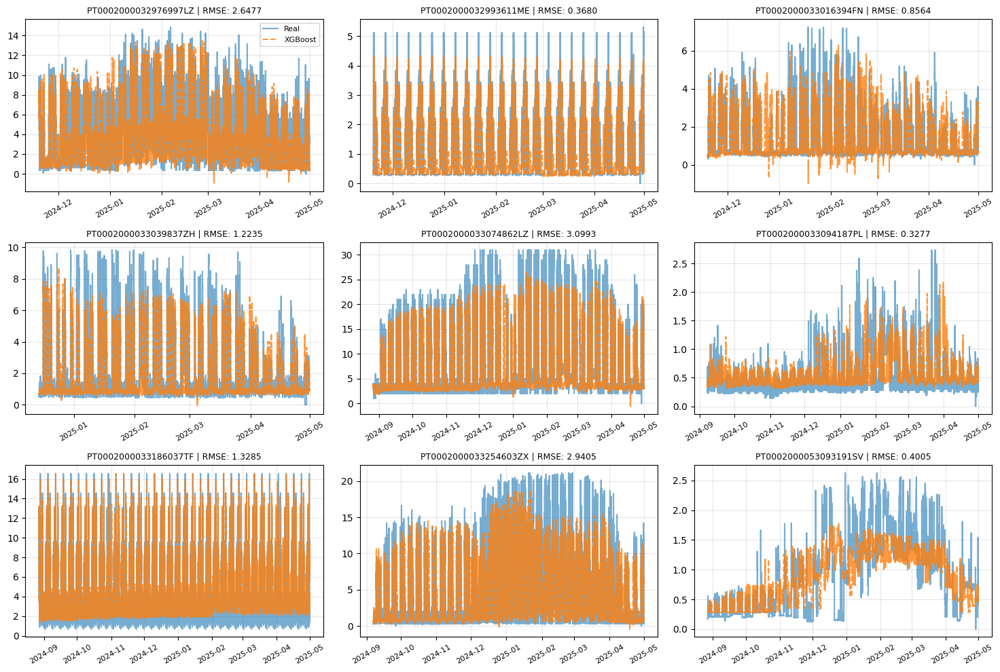

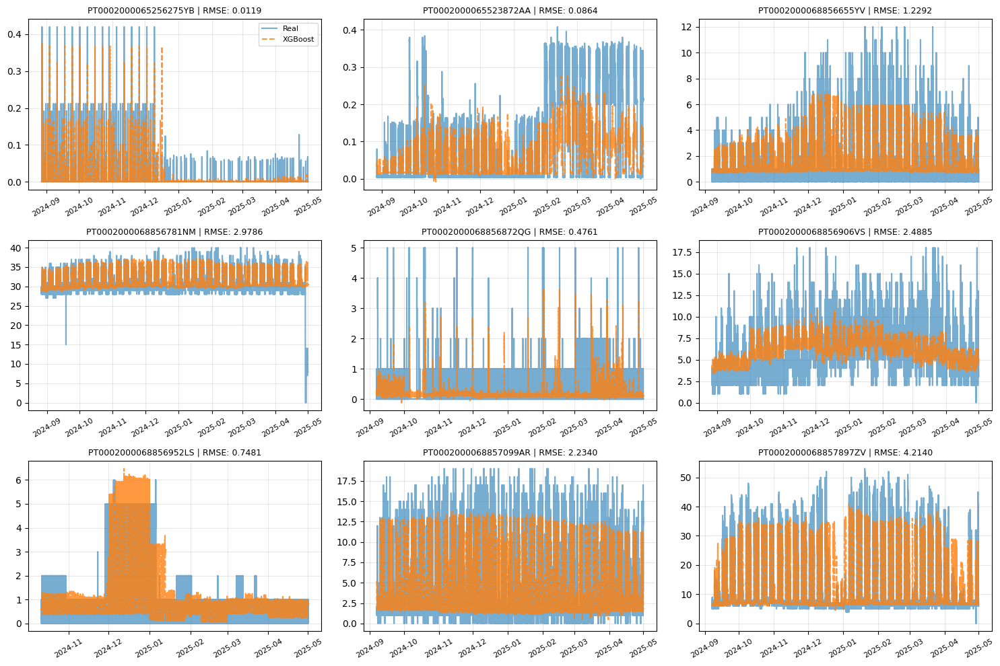

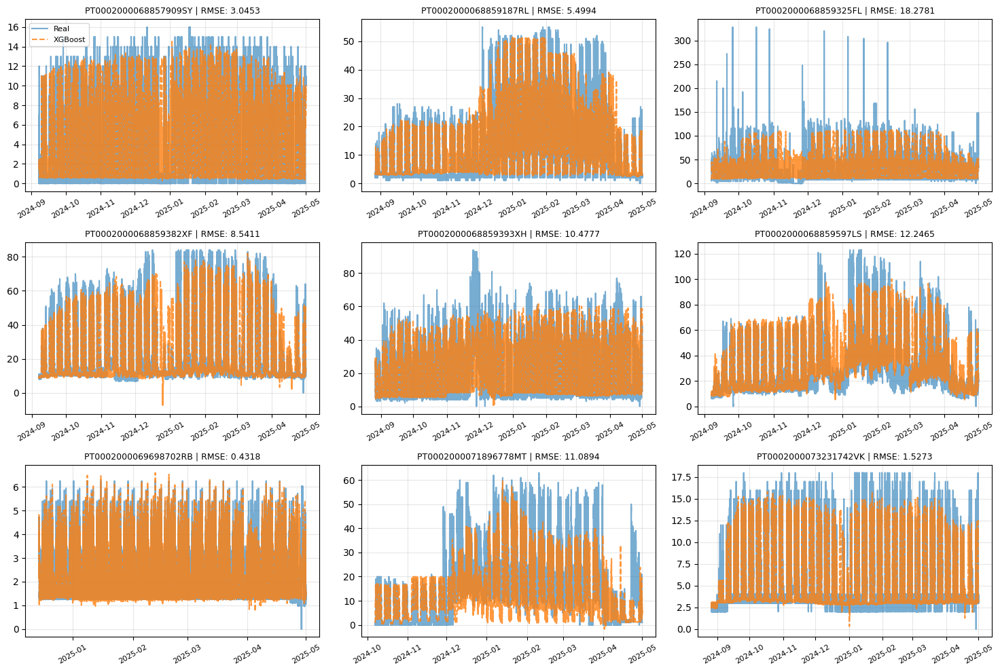

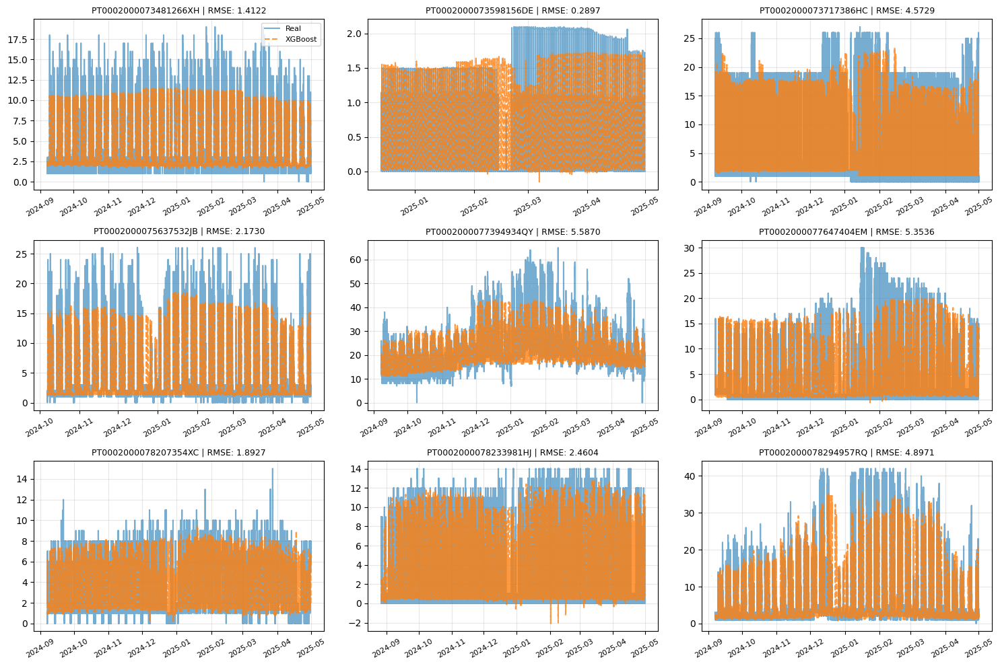

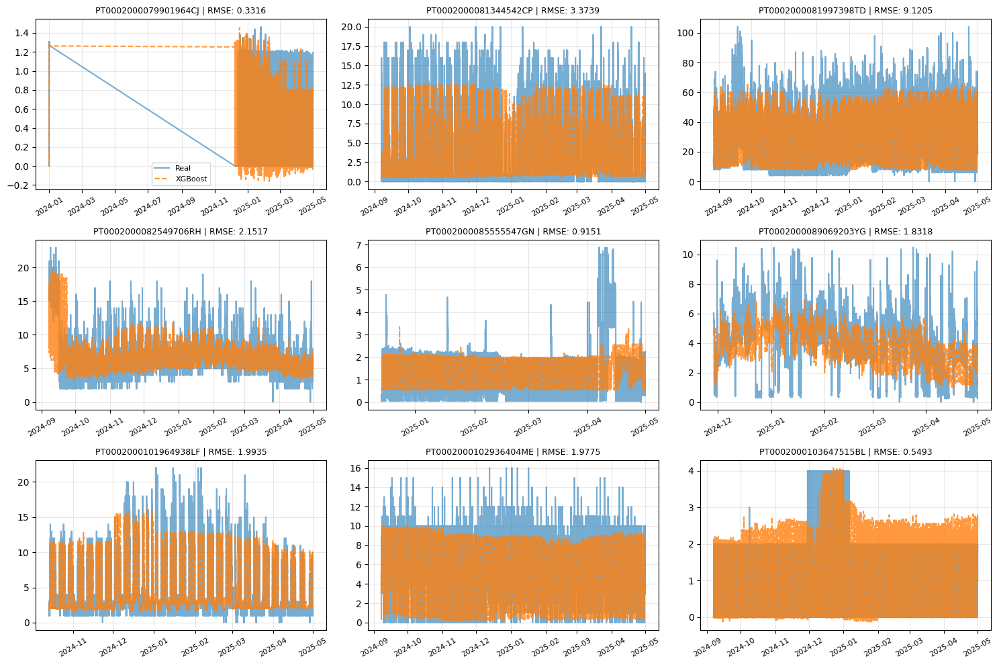

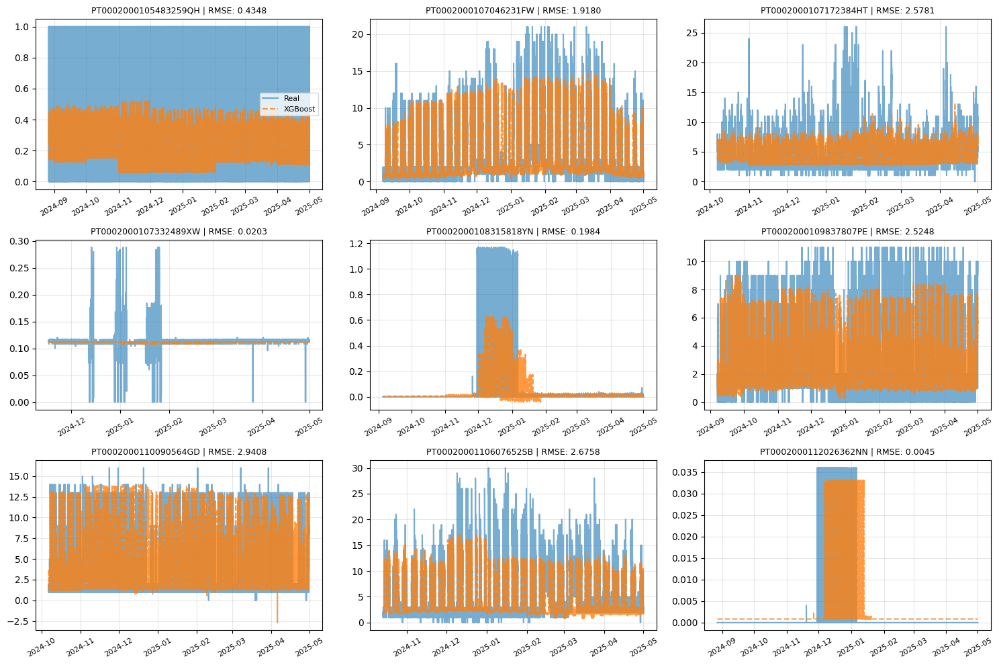

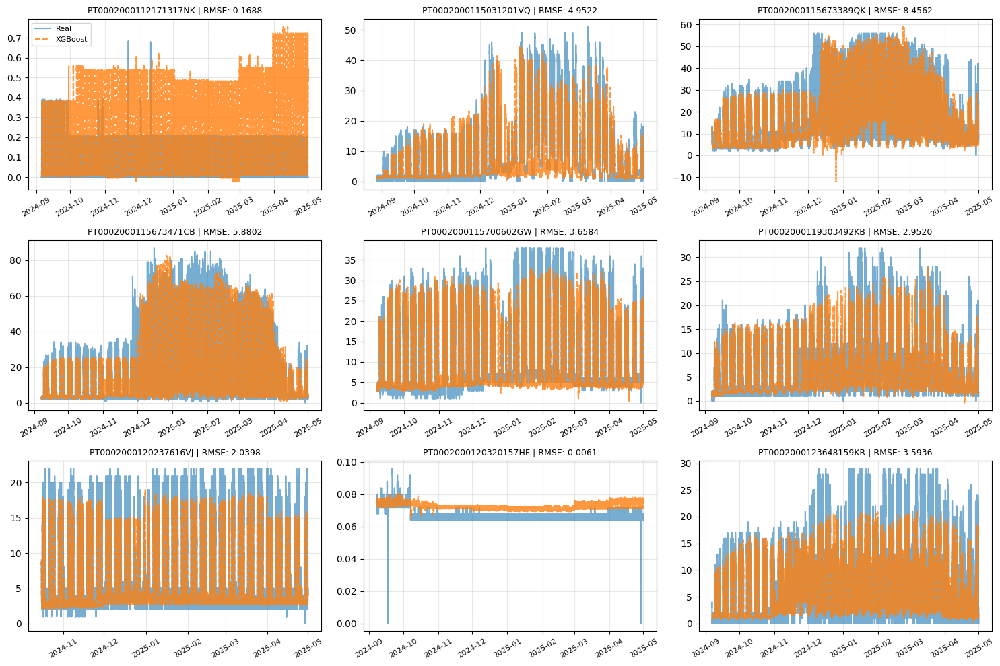

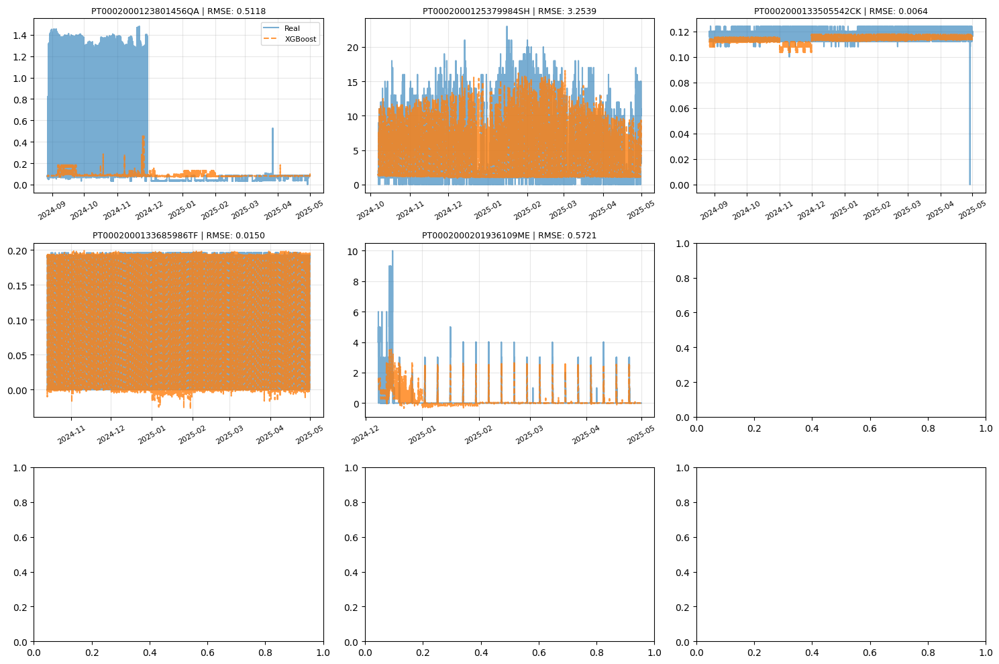

In [92]:
resultados_xgboost = resultados_xgboost 

cpes = list(resultados_xgboost.keys())
batch_size = 9

for i in range(0, len(cpes), batch_size):
    fig, axes = plt.subplots(3, 3, figsize=(15, 10))
    axes = axes.flatten()
    
    # Selecionar o lote atual de CPEs
    batch_cpes = cpes[i : i + batch_size]
    
    for j, cpe in enumerate(batch_cpes):
        # Extrair dados do dicionário de resultados_xgboost
        dados_cpe = resultados_xgboost[cpe]
        real = dados_cpe["real"]
        previsao = dados_cpe["previsao"]
        rmse_val = dados_cpe["rmse"]
        
        # Plotar
        axes[j].plot(real.index, real, label="Real", color='tab:blue', alpha=0.6)
        axes[j].plot(previsao.index, previsao, label="XGBoost", color='tab:orange', alpha=0.8, linestyle='--')
        
        # Título com o erro associado
        axes[j].set_title(f"{cpe} | RMSE: {rmse_val:.4f}", fontsize=9)
        axes[j].grid(True, alpha=0.3)
        
        # Melhorar a leitura da data no eixo X
        axes[j].tick_params(axis='x', rotation=30, labelsize=8)
        
        # Legenda apenas no primeiro gráfico para não poluir, ou em todos se preferires
        if j == 0:
            axes[j].legend(loc='best', fontsize=8)
    
    plt.tight_layout()
    plt.show()

##### Com normalização

In [ ]:
# Dicionario para guardar os resultados finais
resultados_xgboost_norm = {}

for cpe, dados in df_feature_set_scaled.items():
    
    # Obter os dados (QUE ESTAO NORMALIZADOS)
    X_treino, y_treino = dados["X_treino"], dados["y_treino"]
    X_teste, y_teste   = dados["X_teste"], dados["y_teste"]
    
    # Resgatar o Scaler para poder converter de volta depois
    if "scaler_y" in dados:
        scaler_y = dados["scaler_y"]
    else:
        print(f"Erro: Scaler não encontrado para {cpe}. Saltando.")
        continue

    # Logica de Parametros por Cluster
    cluster_id = cluster_por_cpe.get(cpe)
    
    if cluster_id is not None and cluster_id in best_params_cluster_xgboost:
        # Copiar para nao alterar o original
        params_usar = best_params_cluster_xgboost[cluster_id].copy()
        origem = f"Cluster {cluster_id}"
    else:
        # Fallback (Parametros genericos seguros)
        params_usar = {
            'n_estimators': 1000, 
            'learning_rate': 0.05, 
            'max_depth': 5, 
            'early_stopping_rounds': 50, # Importante estar aqui
            'objective': 'reg:squarederror',
            'n_jobs': -1
        }
        origem = "Default"

    print(f"Treinando {cpe} cluster {cluster_id}")

    # Instanciar o modelo XGBoost com os parâmetros do Cluster
    #  **params_usar para desempacotar tudo 
    model = xgb.XGBRegressor(**params_usar, random_state=42)
    
    # Treinar o modelo
    model.fit(
        X_treino, y_treino, 
        eval_set=[(X_treino, y_treino), (X_teste, y_teste)],
        verbose=False
    )
    
    # Fazer a previsão (O resultado sai NORMALIZADO, ex: -0.5, 1.2)
    previsoes_norm = model.predict(X_teste)
    
    # --- DESNORMALIZAR (Voltar para kW) ---
    # O scaler precisa de um array 2D, por isso usamos reshape(-1, 1)
    previsoes_real_values = scaler_y.inverse_transform(previsoes_norm.reshape(-1, 1)).flatten()
    
    # Tambem temos de desnormalizar o y_teste para comparar 
    y_teste_real_values = scaler_y.inverse_transform(y_teste.values.reshape(-1, 1)).flatten()
    
    # Criar Series com indice temporal correto
    previsoes_series = pd.Series(previsoes_real_values, index=y_teste.index)
    y_teste_real_series = pd.Series(y_teste_real_values, index=y_teste.index)
    
    # Calcular erro REAL (RMSE em kW)
    rmse = np.sqrt(mean_squared_error(y_teste_real_series, previsoes_series))
    mae = mean_absolute_error(y_teste_real_series, previsoes_series)
    
    
    # Guardar tudo
    resultados_xgboost_norm[cpe] = {
        "modelo": model,
        "real": y_teste_real_series,    
        "previsao": previsoes_series,
        "rmse": rmse,
        "mae": mae,
        "cluster": cluster_id,
        "params": params_usar
    }

    print(f"CPE {cpe} | MAE: {mae:.4f} | RMSE: {rmse:.4f}")
print("--- Processo Concluído (Normalizado com Params Otimizados) ---")

Treinando PT0002000032976997LZ cluster 0
CPE PT0002000032976997LZ | MAE: 2.0932 | RMSE: 2.7262
Treinando PT0002000032993611ME cluster 1
CPE PT0002000032993611ME | MAE: 0.2235 | RMSE: 0.3736
Treinando PT0002000033016394FN cluster 1
CPE PT0002000033016394FN | MAE: 0.5103 | RMSE: 0.8742
Treinando PT0002000033039837ZH cluster 1
CPE PT0002000033039837ZH | MAE: 0.6060 | RMSE: 1.2400
Treinando PT0002000033074862LZ cluster 0
CPE PT0002000033074862LZ | MAE: 1.7853 | RMSE: 3.1144
Treinando PT0002000033094187PL cluster 1
CPE PT0002000033094187PL | MAE: 0.2309 | RMSE: 0.3249
Treinando PT0002000033186037TF cluster 0
CPE PT0002000033186037TF | MAE: 0.9292 | RMSE: 1.2924
Treinando PT0002000033254603ZX cluster 0
CPE PT0002000033254603ZX | MAE: 1.8930 | RMSE: 2.9613
Treinando PT0002000053093191SV cluster 1
CPE PT0002000053093191SV | MAE: 0.2713 | RMSE: 0.3905
Treinando PT0002000065256275YB cluster 1
CPE PT0002000065256275YB | MAE: 0.0020 | RMSE: 0.0120
Treinando PT0002000065523872AA cluster 1
CPE PT000

In [94]:
# Concatenar todos os valores reais e previsoes
todos_reais = np.concatenate([resultados_xgboost_norm[cpe]["real"] for cpe in resultados_xgboost_norm])
todas_prev = np.concatenate([resultados_xgboost_norm[cpe]["previsao"] for cpe in resultados_xgboost_norm])

# Calcular metricas globais
mae_total = mean_absolute_error(todos_reais, todas_prev)
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))

print(f"XGBoost normalizado - MAE total: {mae_total:.3f} | RMSE total: {rmse_total:.3f}")


XGBoost normalizado - MAE total: 1.956 | RMSE total: 4.595


#### Random Forest - Usado com inputs de features-sets por CPE

In [95]:
# Configurações
N_TRIALS = 20 # Quantas combinacoes testar por cluster
N_CPES_TESTE = 5 # Quantos CPEs usar para o teste

# Agrupar os CPEs por cluster
cpes_by_cluster_id = {}
for cpe, cluster_id in cluster_por_cpe.items():
    if cpe in df_feature_set:
        cpes_by_cluster_id.setdefault(cluster_id, []).append(cpe)

best_params_cluster_randomForest = {}

print(f"--- Iniciando Otimização por Cluster ---")

for cluster_id, lista_cpes in cpes_by_cluster_id.items():
    
    # Selecao de amostra representativa do cluster
    cpes_selecionados = random.sample(lista_cpes, min(len(lista_cpes), N_CPES_TESTE))
    print(f"\n> Otimizando Cluster {cluster_id} usando: {cpes_selecionados}")

    # Funcao objetivo
    def objective(trial):
        params = {
            'learning_rate': 1, # Taxa de aprendizagem fixa para RandomForest 
            'max_depth': trial.suggest_int('max_depth', 3, 9),
            'subsample': trial.suggest_float('subsample', 0.6, 0.95),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 0.95),
            'min_child_weight': trial.suggest_int('min_child_weight', 1, 7),
            # --- FIXOS ---
            'objective': 'reg:squarederror',
            'n_estimators': 200, 
            'n_jobs': -1,
        }
        
        erros_cpes = []
        
        for cpe in cpes_selecionados:
            dados = df_feature_set[cpe]
            X_t, y_t = dados["X_treino"], dados["y_treino"]
            X_v, y_v = dados["X_teste"], dados["y_teste"]
            
            # Passamos tudo no construtor (**params)
            # Usamos XGBRFRegressor (Scikit-Learn API para Random Forest do XGBoost)
            model = xgb.XGBRFRegressor(**params)
            
            # CORREÇÃO: No fit já NÃO passamos early_stopping_rounds
            model.fit(
                X_t, y_t,
                verbose=False
            )
            
            preds = model.predict(X_v)
            rmse = np.sqrt(mean_squared_error(y_v, preds))
            erros_cpes.append(rmse)
        
        return np.mean(erros_cpes)

    # Otimizacao
    optuna.logging.set_verbosity(optuna.logging.WARNING) 
    study = optuna.create_study(direction='minimize')
    study.optimize(objective, n_trials=N_TRIALS)
    
    # Guardar os melhores parametros
    best_params = study.best_params
    best_params.update({
        'objective': 'reg:squarederror',
        'n_estimators': 1000,
        'n_jobs': -1,
    })
    
    # Guardar os melhores parametros para o cluster
    best_params_cluster_randomForest[cluster_id] = best_params
    print(f"  [Cluster {cluster_id}] Melhor RMSE: {study.best_value:.4f}")

print("\n--- Otimização Concluída ---")

--- Iniciando Otimização por Cluster ---

> Otimizando Cluster 0 usando: ['PT0002000081344542CP', 'PT0002000068857897ZV', 'PT0002000033254603ZX', 'PT0002000110607652SB', 'PT0002000107172384HT']
  [Cluster 0] Melhor RMSE: 3.1920

> Otimizando Cluster 1 usando: ['PT0002000112171317NK', 'PT0002000108315818YN', 'PT0002000053093191SV', 'PT0002000033094187PL', 'PT0002000033016394FN']
  [Cluster 1] Melhor RMSE: 0.4057

> Otimizando Cluster 2 usando: ['PT0002000068859325FL', 'PT0002000068859382XF', 'PT0002000068859597LS', 'PT0002000068859393XH', 'PT0002000068856781NM']
  [Cluster 2] Melhor RMSE: 10.9637

--- Otimização Concluída ---


##### Sem normalização

In [ ]:
resultados_randomForest = {}

for cpe, dados in df_feature_set.items():
    
    # Identificar o cluster deste CPE
    if cpe in cluster_por_cpe:
        cluster_id = cluster_por_cpe[cpe]
        
        # Recuperar os melhores parametros para esse cluster
        if cluster_id in best_params_cluster_randomForest:
            params = best_params_cluster_randomForest[cluster_id].copy()
        else:
            print(f"AVISO: Cluster {cluster_id} não encontrado nos parâmetros. Usando default.")
            params = {'n_estimators': 300, 'max_depth': 5} # Fallback
    else:
        print(f"AVISO: CPE {cpe} sem cluster definido. Usando default.")
        params = {'n_estimators': 300, 'max_depth': 5} # Fallback

    # Garantir parametros que podem não ter sido salvos no 'best_params'
    params['random_state'] = 42
    
    print(f"Treinando CPE: {cpe} (Cluster {cluster_id})")

    # Obter os dados preparados
    X_treino, y_treino = dados["X_treino"], dados["y_treino"]
    X_teste, y_teste   = dados["X_teste"], dados["y_teste"]
    
    # Instanciar o modelo usando **params (unpacking do dicionario)
    model = xgb.XGBRFRegressor(**params)
    
    # Treinar o modelo
    model.fit(X_treino, y_treino)
    
    # Fazer a previsao
    previsoes_array = model.predict(X_teste)
    
    # Converter previsao para manter o índice de data
    previsoes_series = pd.Series(previsoes_array, index=y_teste.index)
    
    # Calcular erro (RMSE)
    rmse = np.sqrt(mean_squared_error(y_teste, previsoes_series))
    mae = mean_absolute_error(y_teste, previsoes_series)
    print(f" MAE: {mae:.4f} | RMSE: {rmse:.4f}")
    
    # Guardar tudo
    resultados_randomForest[cpe] = {
        "real": y_teste,
        "previsao": previsoes_series,
        "rmse": rmse,
        "mae": mae,
        "cluster_usado": cluster_id
    }


Treinando CPE: PT0002000032976997LZ (Cluster 0)
 MAE: 2.1430 | RMSE: 2.8114
Treinando CPE: PT0002000032993611ME (Cluster 1)
 MAE: 0.2394 | RMSE: 0.4027
Treinando CPE: PT0002000033016394FN (Cluster 1)
 MAE: 0.5429 | RMSE: 0.9143
Treinando CPE: PT0002000033039837ZH (Cluster 1)
 MAE: 0.6436 | RMSE: 1.2643
Treinando CPE: PT0002000033074862LZ (Cluster 0)
 MAE: 1.8757 | RMSE: 3.2744
Treinando CPE: PT0002000033094187PL (Cluster 1)
 MAE: 0.2140 | RMSE: 0.3352
Treinando CPE: PT0002000033186037TF (Cluster 0)
 MAE: 0.9297 | RMSE: 1.4942
Treinando CPE: PT0002000033254603ZX (Cluster 0)
 MAE: 1.9984 | RMSE: 3.1192
Treinando CPE: PT0002000053093191SV (Cluster 1)
 MAE: 0.2738 | RMSE: 0.4021
Treinando CPE: PT0002000065256275YB (Cluster 1)
 MAE: 0.0020 | RMSE: 0.0123
Treinando CPE: PT0002000065523872AA (Cluster 1)
 MAE: 0.0520 | RMSE: 0.0861
Treinando CPE: PT0002000068856655YV (Cluster 1)
 MAE: 0.8867 | RMSE: 1.2315
Treinando CPE: PT0002000068856781NM (Cluster 2)
 MAE: 1.4049 | RMSE: 2.9794
Treinando CP

In [97]:
# Concatenar todos os valores reais e previsoes
todos_reais = np.concatenate([resultados_randomForest[cpe]["real"] for cpe in resultados_randomForest])
todas_prev = np.concatenate([resultados_randomForest[cpe]["previsao"] for cpe in resultados_randomForest])

# Calcular metricas globais
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
mae_total = mean_absolute_error(todos_reais, todas_prev)

print(f"Random Forest - MAE total: {mae_total:.3f} | RMSE total: {rmse_total:.3f}")

Random Forest - MAE total: 1.987 | RMSE total: 4.713


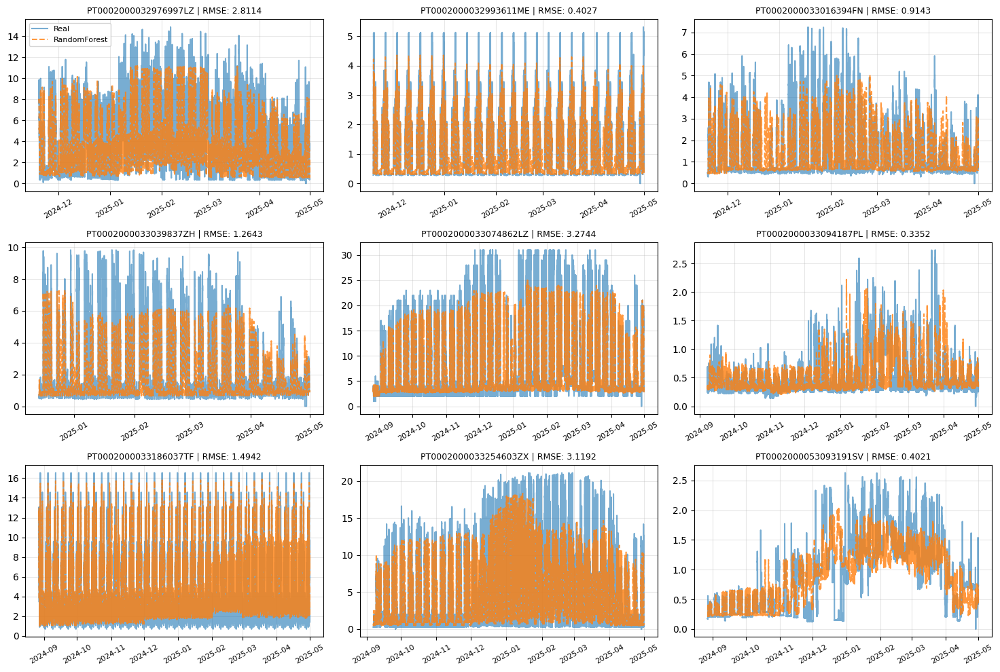

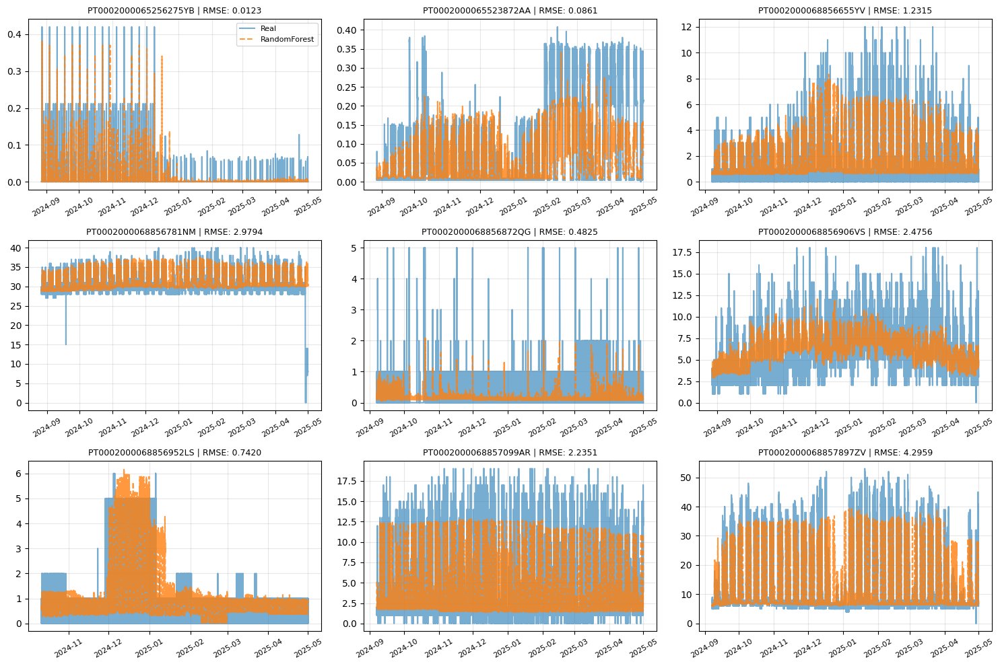

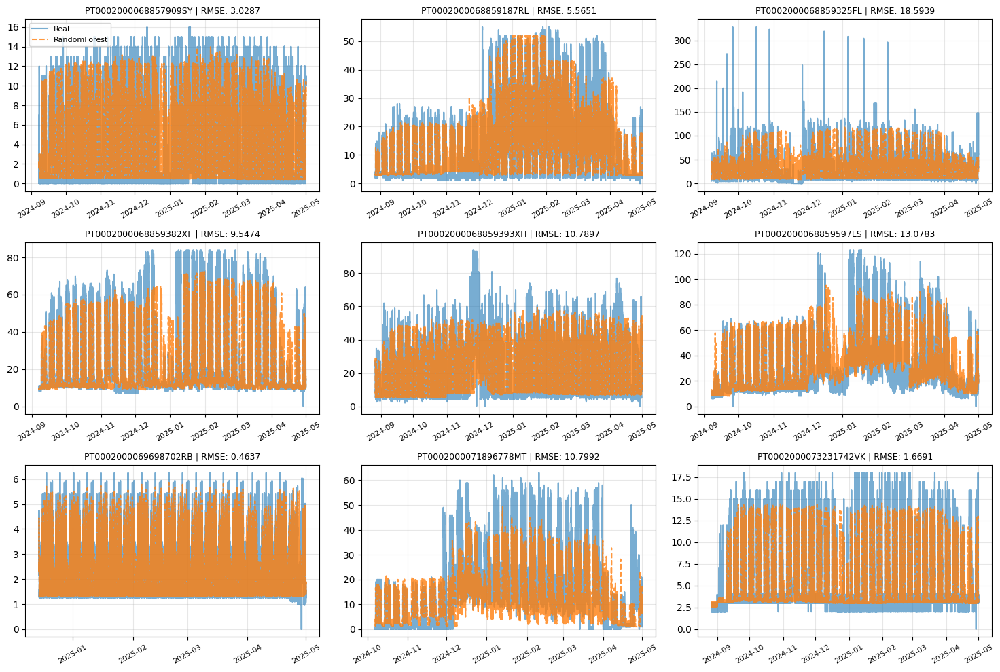

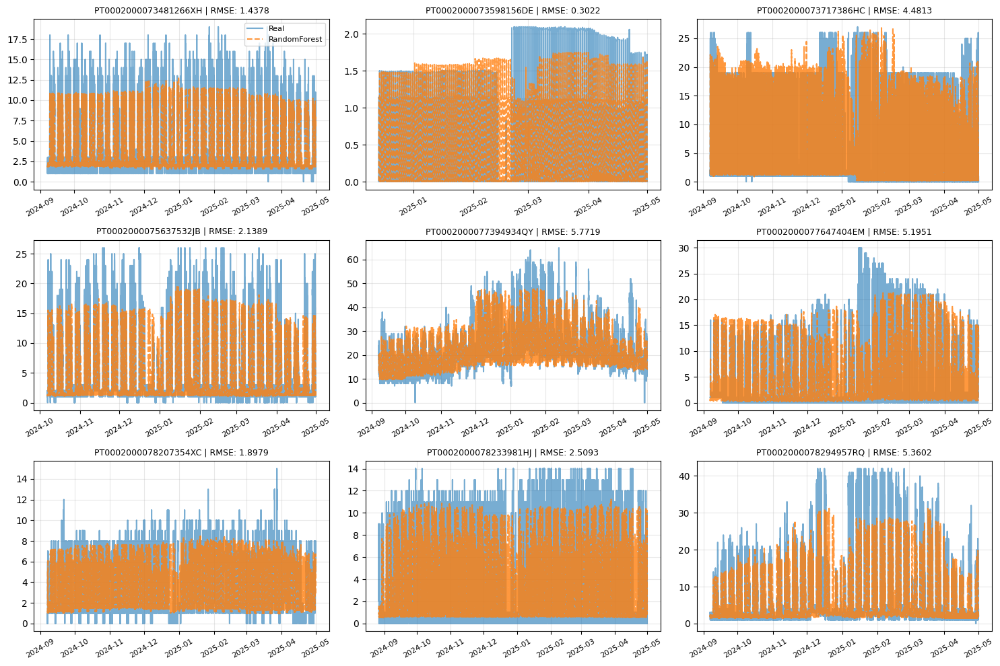

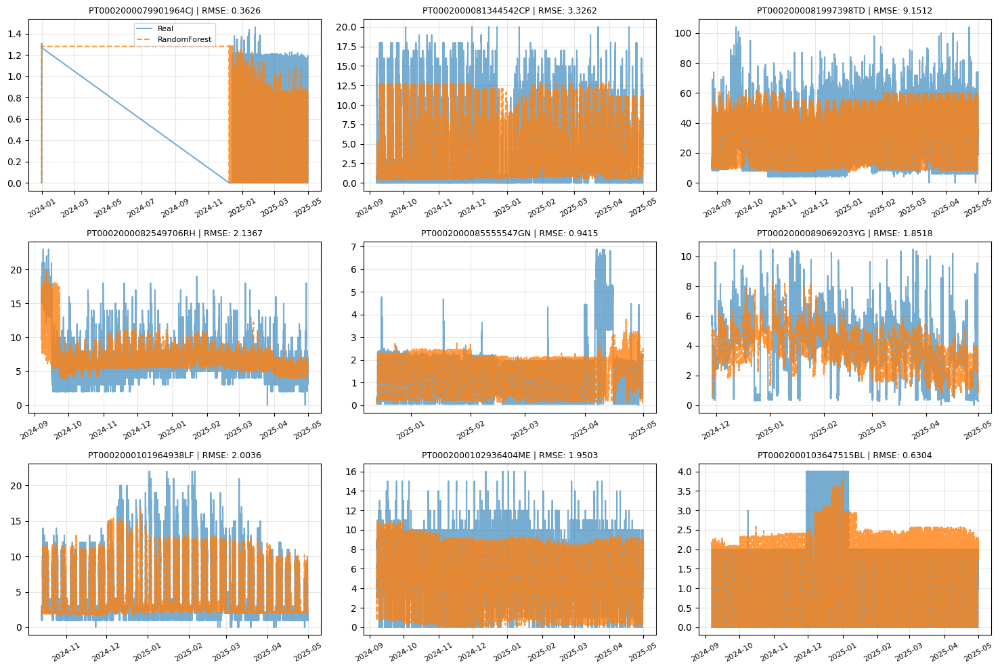

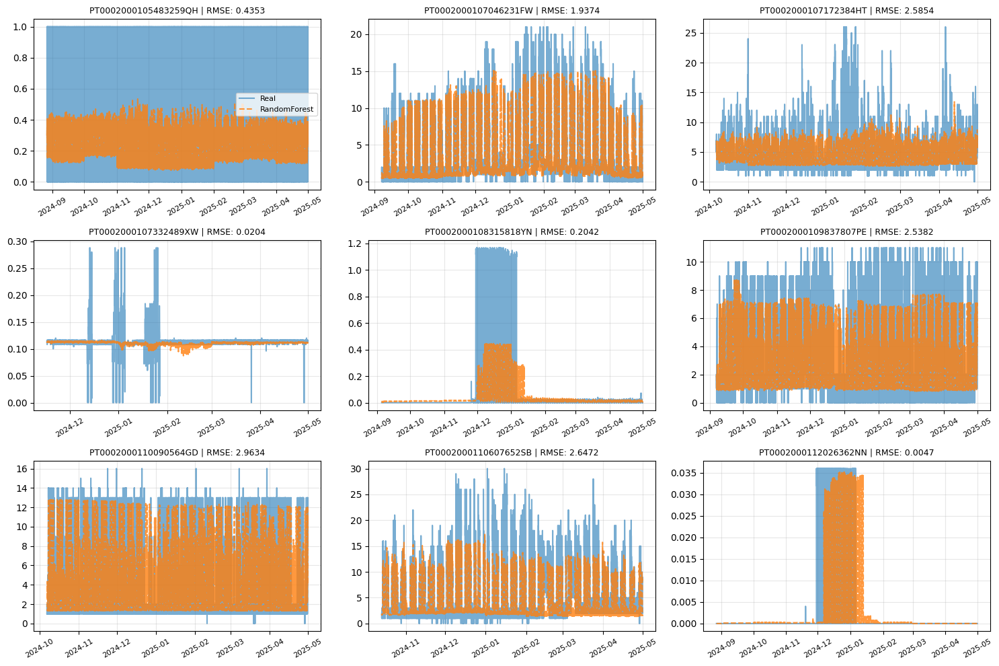

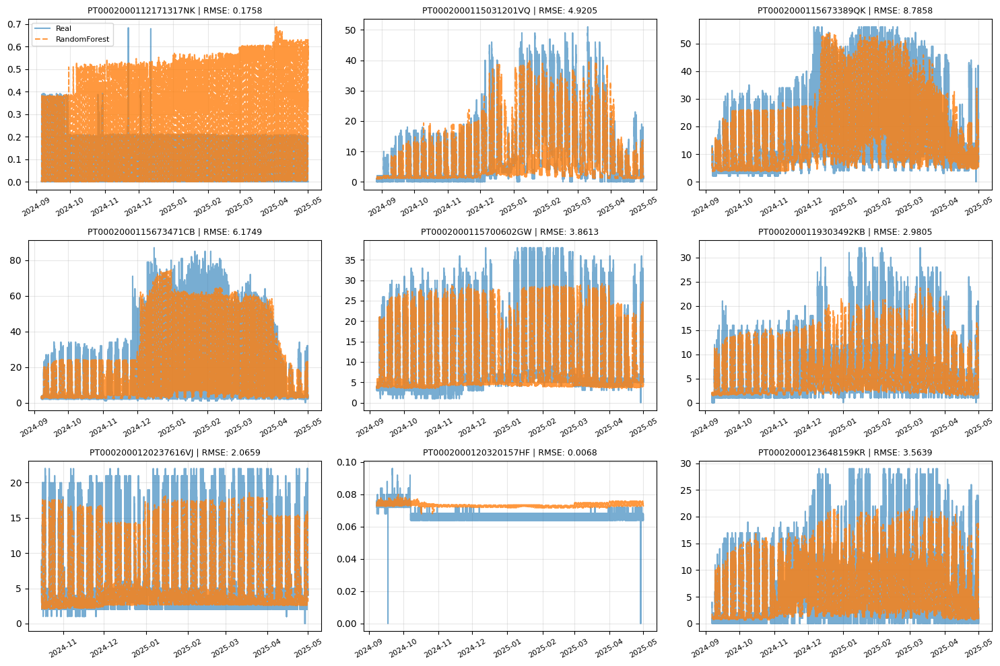

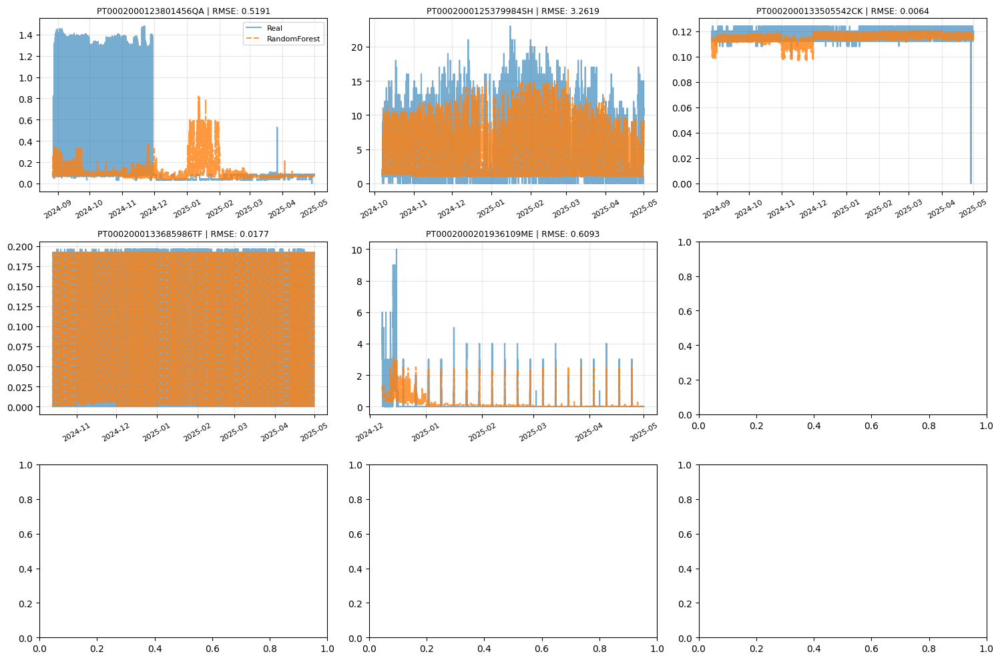

In [ ]:
cpes = list(resultados_randomForest.keys())
batch_size = 9

for i in range(0, len(cpes), batch_size):
    fig, axes = plt.subplots(3, 3, figsize=(15, 10))
    axes = axes.flatten()
    
    # Selecionar o lote atual de CPEs
    batch_cpes = cpes[i : i + batch_size]
    
    for j, cpe in enumerate(batch_cpes):
        # Extrair dados do dicionario de resultados_randomForest
        dados_cpe = resultados_randomForest[cpe]
        real = dados_cpe["real"]
        previsao = dados_cpe["previsao"]
        rmse_val = dados_cpe["rmse"]
        
        # Plotar
        axes[j].plot(real.index, real, label="Real", color='tab:blue', alpha=0.6)
        axes[j].plot(previsao.index, previsao, label="RandomForest", color='tab:orange', alpha=0.8, linestyle='--')
        
        # Titulo com o erro associado
        axes[j].set_title(f"{cpe} | RMSE: {rmse_val:.4f}", fontsize=9)
        axes[j].grid(True, alpha=0.3)
        
        # Melhorar a leitura da data no eixo X
        axes[j].tick_params(axis='x', rotation=30, labelsize=8)
        
        # Legenda apenas no primeiro grafico para nao poluir
        if j == 0:
            axes[j].legend(loc='best', fontsize=8)
    
    plt.tight_layout()
    plt.show()

##### Com Normalização

In [ ]:
resultados_randomForest_scaled = {}

for cpe, dados in df_feature_set_scaled.items():
    
    # Verificar a qual cluster este CPE pertence
    if cpe in cluster_por_cpe:
        cluster_id = cluster_por_cpe[cpe]
        
        # Recuperar os parâmetros desse cluster
        if cluster_id in best_params_cluster_randomForest:
            params = best_params_cluster_randomForest[cluster_id].copy()
        else:
            print(f"AVISO: Cluster {cluster_id} sem parâmetros.")
            params = {'n_estimators': 300, 'max_depth': 5}
    else:
        print(f"AVISO: CPE {cpe} sem cluster.")
        params = {'n_estimators': 300, 'max_depth': 5}

    # garantir parametros necessarios
    params['random_state'] = 42

    print(f"Treinando CPE: {cpe} (Cluster {cluster_id})")

    # Obter os dados (NORMALIZADOS)
    X_treino, y_treino = dados["X_treino"], dados["y_treino"]
    X_teste, y_teste   = dados["X_teste"], dados["y_teste"]
    
    # Obter o scaler para desnormalizar depois
    if "scaler_y" in dados:
        scaler_y = dados["scaler_y"]
    else:
        print(f"Erro: Scaler não encontrado para {cpe}. Saltando.")
        continue

    # Instanciar o modelo usando unpacking (**params)
    model = xgb.XGBRFRegressor(**params)
    
    # Treinar o modelo
    model.fit(X_treino, y_treino)
    
    # Fazer a previsao (Sai NORMALIZADA)
    previsoes_norm = model.predict(X_teste)
    
    # --- DESNORMALIZAR (Voltar para kW) ---
    # Inverter a previsao
    previsoes_real_values = scaler_y.inverse_transform(previsoes_norm.reshape(-1, 1)).flatten()
    
    # Inverter o target real (y_teste)
    # Nota: y_teste e uma Series, y_teste.values pega o numpy array
    y_teste_real_values = scaler_y.inverse_transform(y_teste.values.reshape(-1, 1)).flatten()
    
    # Criar Series com índice temporal
    previsoes_series = pd.Series(previsoes_real_values, index=y_teste.index)
    y_teste_real_series = pd.Series(y_teste_real_values, index=y_teste.index)
    
    # Calcular erro REAL (RMSE em kW)
    rmse = np.sqrt(mean_squared_error(y_teste_real_series, previsoes_series))
    mae = mean_absolute_error(y_teste_real_series, previsoes_series)
    print(f"MAE Real: {mae:.4f} | RMSE Real: {rmse:.4f}")
    
    # Guardar tudo (Valores REAIS)
    resultados_randomForest_scaled[cpe] = {
        "modelo": model,
        "real": y_teste_real_series,
        "previsao": previsoes_series,
        "rmse": rmse,
        "mae": mae,
        "cluster_usado": cluster_id
    }


Treinando CPE: PT0002000032976997LZ (Cluster 0)
MAE Real: 2.1377 | RMSE Real: 2.7999
Treinando CPE: PT0002000032993611ME (Cluster 1)
MAE Real: 0.2385 | RMSE Real: 0.4003
Treinando CPE: PT0002000033016394FN (Cluster 1)
MAE Real: 0.5439 | RMSE Real: 0.9154
Treinando CPE: PT0002000033039837ZH (Cluster 1)
MAE Real: 0.6376 | RMSE Real: 1.2504
Treinando CPE: PT0002000033074862LZ (Cluster 0)
MAE Real: 1.8736 | RMSE Real: 3.2649
Treinando CPE: PT0002000033094187PL (Cluster 1)
MAE Real: 0.2125 | RMSE Real: 0.3344
Treinando CPE: PT0002000033186037TF (Cluster 0)
MAE Real: 0.9118 | RMSE Real: 1.4560
Treinando CPE: PT0002000033254603ZX (Cluster 0)
MAE Real: 1.9955 | RMSE Real: 3.1204
Treinando CPE: PT0002000053093191SV (Cluster 1)
MAE Real: 0.2742 | RMSE Real: 0.4030
Treinando CPE: PT0002000065256275YB (Cluster 1)
MAE Real: 0.0020 | RMSE Real: 0.0123
Treinando CPE: PT0002000065523872AA (Cluster 1)
MAE Real: 0.0522 | RMSE Real: 0.0863
Treinando CPE: PT0002000068856655YV (Cluster 1)
MAE Real: 0.8797 

In [100]:
# Concatenar todos os valores reais e previsoes
todos_reais = np.concatenate([resultados_randomForest_scaled[cpe]["real"] for cpe in resultados_randomForest_scaled])
todas_prev = np.concatenate([resultados_randomForest_scaled[cpe]["previsao"] for cpe in resultados_randomForest_scaled])

# Calcular metricas globais
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
mae_total = mean_absolute_error(todos_reais, todas_prev)

print(f"Random Forest normalizado - MAE total: {mae_total:.3f} | RMSE total: {rmse_total:.3f}")

Random Forest normalizado - MAE total: 1.986 | RMSE total: 4.711


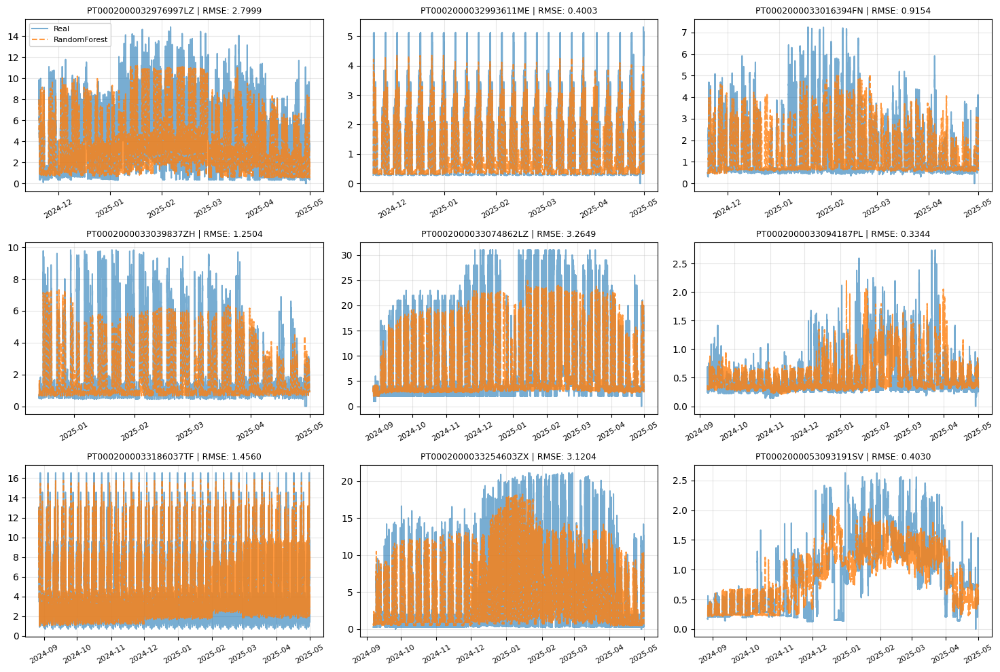

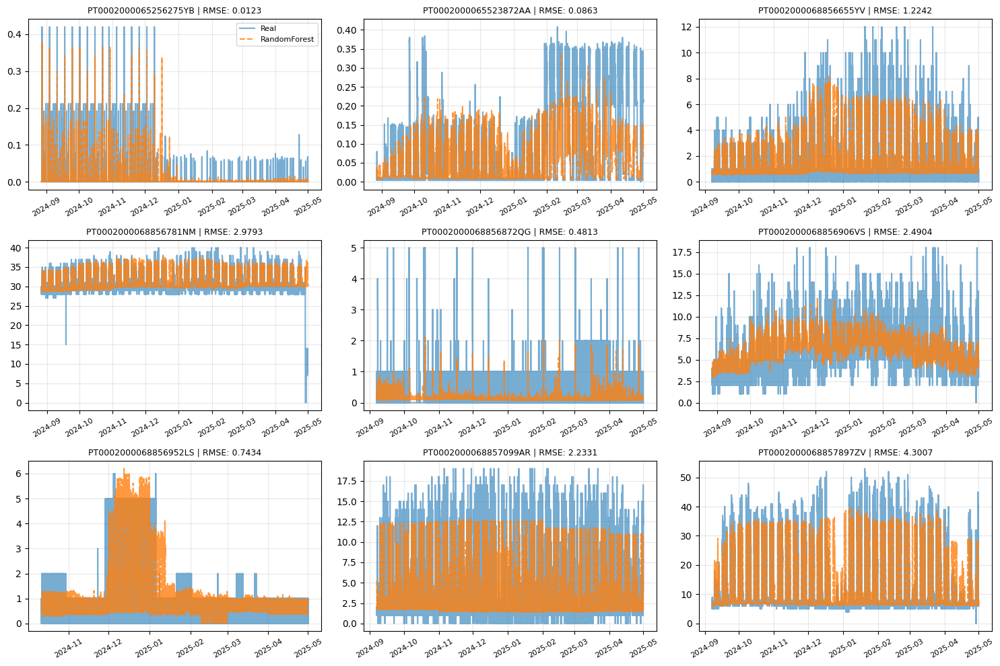

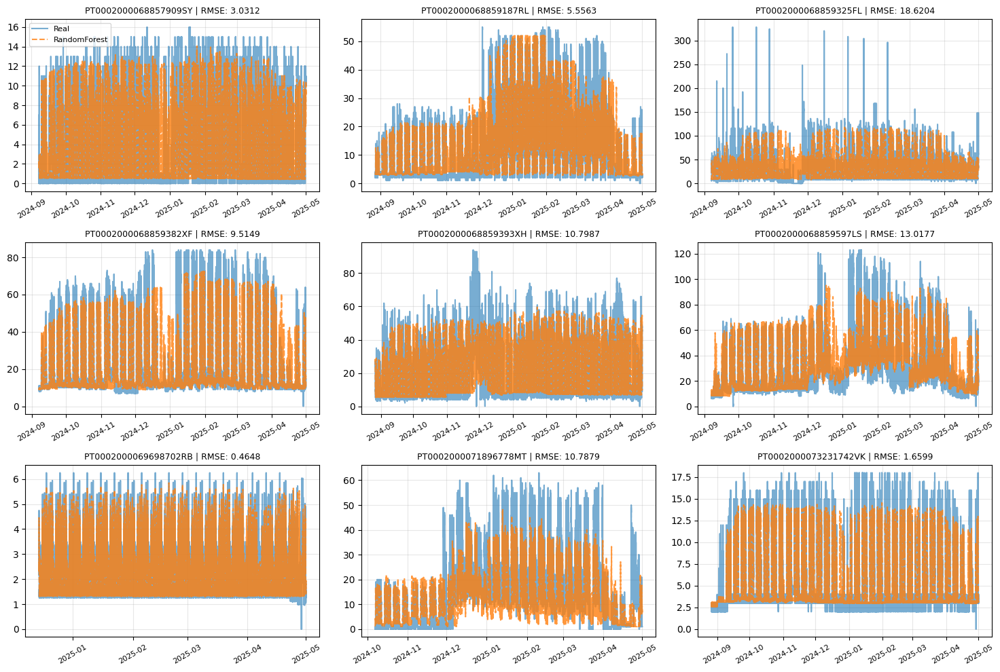

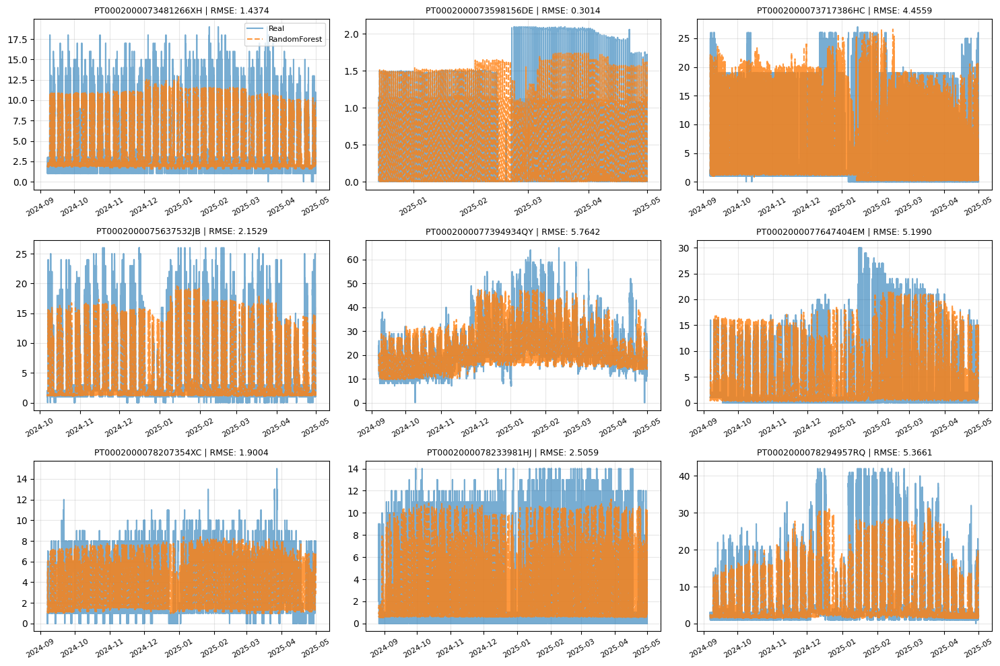

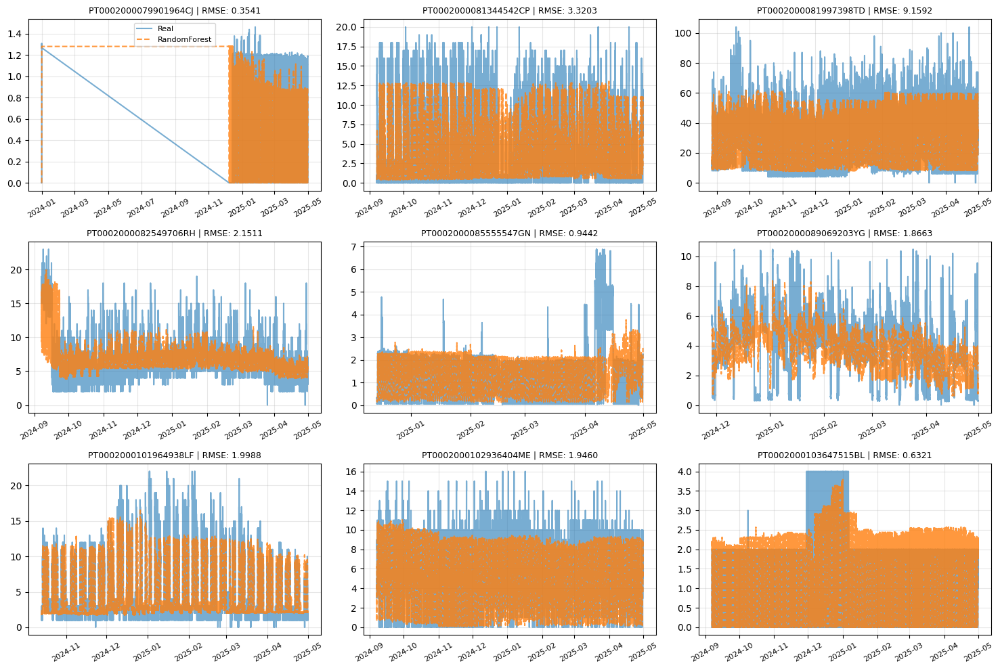

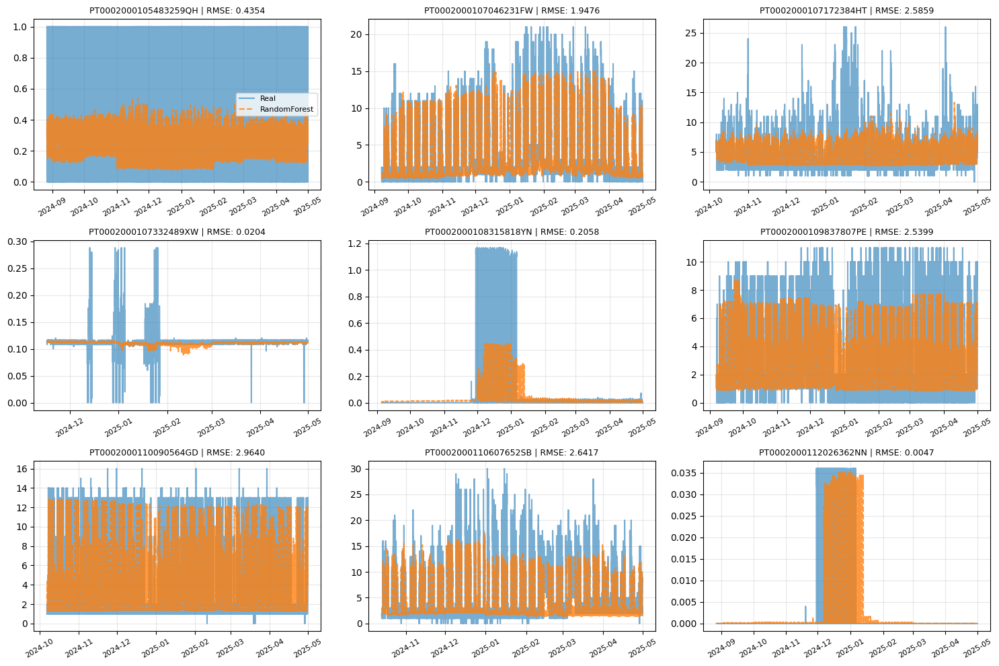

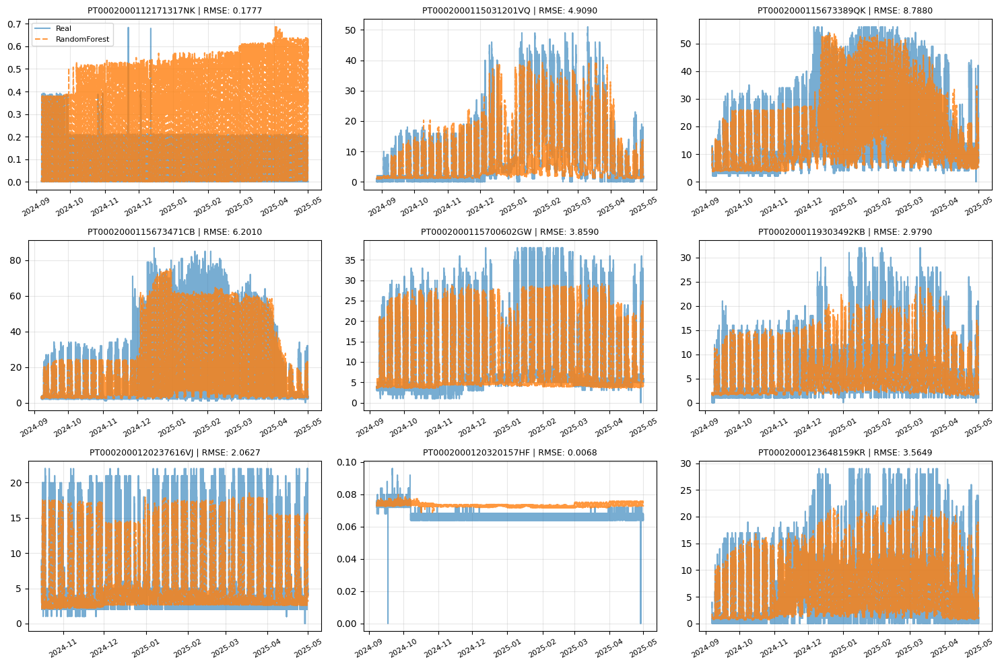

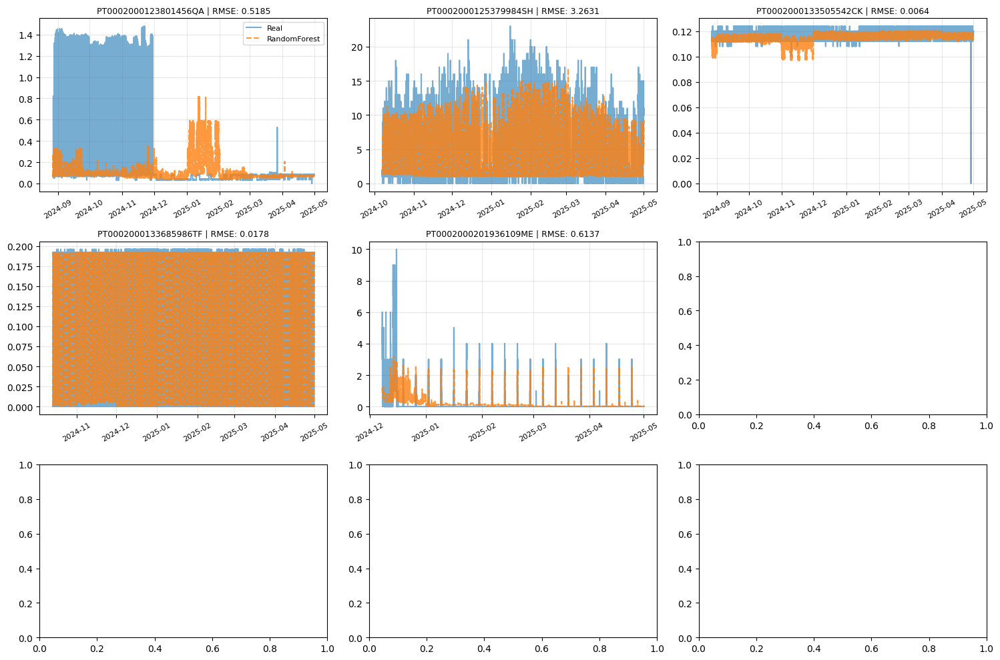

In [ ]:
cpes = list(resultados_randomForest_scaled.keys())
batch_size = 9

for i in range(0, len(cpes), batch_size):
    fig, axes = plt.subplots(3, 3, figsize=(15, 10))
    axes = axes.flatten()
    
    # Selecionar o lote atual de CPEs
    batch_cpes = cpes[i : i + batch_size]
    
    for j, cpe in enumerate(batch_cpes):
        # Extrair dados do dicionario de resultados_randomForest_scaled
        dados_cpe = resultados_randomForest_scaled[cpe]
        real = dados_cpe["real"]
        previsao = dados_cpe["previsao"]
        rmse_val = dados_cpe["rmse"]
        
        # Plotar
        axes[j].plot(real.index, real, label="Real", color='tab:blue', alpha=0.6)
        axes[j].plot(previsao.index, previsao, label="RandomForest", color='tab:orange', alpha=0.8, linestyle='--')
        
        # Titulo com o erro associado
        axes[j].set_title(f"{cpe} | RMSE: {rmse_val:.4f}", fontsize=9)
        axes[j].grid(True, alpha=0.3)
        
        # Melhorar a leitura da data no eixo X
        axes[j].tick_params(axis='x', rotation=30, labelsize=8)
        
        # Legenda apenas no primeiro grafico para nao poluir
        if j == 0:
            axes[j].legend(loc='best', fontsize=8)
    
    plt.tight_layout()
    plt.show()

#### MLP - Usado com inputs de features-sets por CPE

In [ ]:
# --- Configuracoes ---
N_TRIALS = 20        # Numero de trials por cluster
N_CPES_TESTE = 5     # Quantos CPEs por cluster usar para testar

##### sem normalização

In [ ]:
# Organizar CPEs por cluster (igual ao que fizeste antes)
cpes_by_cluster_id = {}
for cpe, cluster_id in cluster_por_cpe.items():
    if cpe in df_feature_set:
        cpes_by_cluster_id.setdefault(cluster_id, []).append(cpe)

best_params_cluster_mlp = {}

print(f"--- Iniciando Otimização MLP por Cluster ---")

for cluster_id, lista_cpes in cpes_by_cluster_id.items():
    
    # Selecionar amostra aleatoria de CPEs deste cluster
    cpes_selecionados = random.sample(lista_cpes, min(len(lista_cpes), N_CPES_TESTE))
    print(f"\n> Otimizando Cluster {cluster_id} (Amostra: {len(cpes_selecionados)} CPEs)")

    def objective(trial):
        # --- DEFINICAO DO ESPACO DE PROCURA ---
        
        layers_options = [
            (32,),
            (50,),
            (64,),
            (100,), 
            (50, 25), 
            (64, 32),
        ]
        
        params = {
            'hidden_layer_sizes': trial.suggest_categorical('hidden_layer_sizes', layers_options),
            'activation': 'relu',  # Relu é geralmente o melhor padrao
            'solver': 'adam',      # Adam funciona bem para dados grandes
            
            # Alpha (Regularização L2): Evita overfitting
            'alpha': trial.suggest_float('alpha', 1e-5, 1e-1, log=True),
            
            # Taxa de aprendizagem inicial
            'learning_rate_init': trial.suggest_float('learning_rate_init', 1e-4, 1e-2, log=True),
            
            # Outros fixos
            'max_iter': 500,
            'early_stopping': True,
            'random_state': 42
        }
        
        erros_cpes = []
        
        for cpe in cpes_selecionados:
            dados = df_feature_set[cpe] 
            
            X_t, y_t = dados["X_treino"], dados["y_treino"]
            X_v, y_v = dados["X_teste"], dados["y_teste"]
            
            # Criar modelo com parametros do trial
            model = MLPRegressor(**params)
            
            try:
                # Treinar (silenciosamente)
                model.fit(X_t, y_t)
                
                # Prever
                preds = model.predict(X_v)
                
                # Calcular erro
                
                rmse = np.sqrt(mean_squared_error(y_v, preds))
                erros_cpes.append(rmse)
                
            except Exception as e:
                # Se o modelo explodir (comum em dados nao normalizados), retornamos erro infinito
                return float('inf')
        
        # O objetivo e minimizar a media dos RMSEs dos CPEs testados
        return np.mean(erros_cpes)

    # Executar Optuna
    optuna.logging.set_verbosity(optuna.logging.WARNING) 
    study = optuna.create_study(direction='minimize')
    study.optimize(objective, n_trials=N_TRIALS)
    
    # Guardar melhores params
    best_params = study.best_params
    
    # Adicionar configuracoes fixas necessarias para a aplicacao final
    best_params.update({
        'activation': 'relu',
        'solver': 'adam',
        'max_iter': 1000,       # Na versao final damos mais tempo
        'early_stopping': True,
        'random_state': 42
    })
    
    best_params_cluster_mlp[cluster_id] = best_params
    print(f"  [Cluster {cluster_id}] Melhor RMSE: {study.best_value:.4f}")
    print(f"  -> Params: {study.best_params}")

print("\n--- Otimização MLP Concluída ---")


--- Iniciando Otimização MLP por Cluster ---

> Otimizando Cluster 0 (Amostra: 5 CPEs)
  [Cluster 0] Melhor RMSE: 4.3025
  -> Params: {'hidden_layer_sizes': (32,), 'alpha': 3.601420825562646e-05, 'learning_rate_init': 0.001734824362602463}

> Otimizando Cluster 1 (Amostra: 5 CPEs)
  [Cluster 1] Melhor RMSE: 0.3724
  -> Params: {'hidden_layer_sizes': (64, 32), 'alpha': 0.0193732737212934, 'learning_rate_init': 0.001415356081219546}

> Otimizando Cluster 2 (Amostra: 5 CPEs)
  [Cluster 2] Melhor RMSE: 11.8887
  -> Params: {'hidden_layer_sizes': (100,), 'alpha': 0.0030761233202769374, 'learning_rate_init': 0.00013559558437718257}

--- Otimização MLP Concluída ---


In [126]:
# Dicionario para guardar os resultados
resultados_mlp = {}

print("A iniciar treino e previsão com MLP (Sem Normalização)")

for cpe, dados in df_feature_set.items():    
    if cpe in cluster_por_cpe:
        cluster_id = cluster_por_cpe[cpe]
        if cluster_id in best_params_cluster_mlp:
            params = best_params_cluster_mlp[cluster_id]
        else:   # Fallback se algo falhar
            params = {'hidden_layer_sizes': (100, 50), 'activation': 'relu', 'solver': 'adam', 'max_iter': 500}
    else:   # Fallback se algo falhar
        params = {'hidden_layer_sizes': (100, 50), 'activation': 'relu', 'solver': 'adam', 'max_iter': 500}
    print(f"Treinando CPE: {cpe} (Cluster {cluster_id})")
    # Dados
    X_treino, y_treino = dados["X_treino"], dados["y_treino"]
    X_teste, y_teste   = dados["X_teste"], dados["y_teste"]
    
    # Treinar Modelo
    # Como params ja tem tudo basta fazer unpack
    model = MLPRegressor(**params)
    
    try:
        # Treino
        model.fit(X_treino, y_treino)
        
        # Previsao
        previsoes = model.predict(X_teste)
        previsoes_series = pd.Series(previsoes, index=y_teste.index)
        
        # Avaliacao
        mse = mean_squared_error(y_teste, previsoes_series)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(y_teste, previsoes_series)

        print(f"Antes de clipping: MAE: {mae:.4f} | RMSE: {rmse:.4f}")

        # clip feito para meter valores negativos a zero (nao existem potencias negativas)
        previsao_final = np.clip(previsoes_series, 0, None)

        # metricas de erro
        mse = mean_squared_error(y_teste, previsao_final)
        rmse_final = np.sqrt(mse)
        mae_final = mean_absolute_error(y_teste, previsao_final)

        print(f"Após clipping: MAE: {mae_final:.4f} | RMSE: {rmse_final:.4f}")
        
        # Guardar resultados
        resultados_mlp[cpe] = {
            "rmse": rmse_final,
            "mae": mae_final,
            "previsao": previsao_final,
            "real": y_teste
        }
        
    except Exception as e:
        print(f"CPE {cpe} -> Falha no treino: {e}")
    

A iniciar treino e previsão com MLP (Sem Normalização)
Treinando CPE: PT0002000032976997LZ (Cluster 0)
Antes de clipping: MAE: 2.2631 | RMSE: 3.0637
Após clipping: MAE: 2.2626 | RMSE: 3.0635
Treinando CPE: PT0002000032993611ME (Cluster 1)
Antes de clipping: MAE: 0.2578 | RMSE: 0.4790
Após clipping: MAE: 0.2578 | RMSE: 0.4789
Treinando CPE: PT0002000033016394FN (Cluster 1)
Antes de clipping: MAE: 0.4871 | RMSE: 0.8513
Após clipping: MAE: 0.4846 | RMSE: 0.8488
Treinando CPE: PT0002000033039837ZH (Cluster 1)
Antes de clipping: MAE: 0.6035 | RMSE: 1.1635
Após clipping: MAE: 0.6019 | RMSE: 1.1617
Treinando CPE: PT0002000033074862LZ (Cluster 0)
Antes de clipping: MAE: 1.7910 | RMSE: 3.1336
Após clipping: MAE: 1.7910 | RMSE: 3.1335
Treinando CPE: PT0002000033094187PL (Cluster 1)
Antes de clipping: MAE: 0.2397 | RMSE: 0.3997
Após clipping: MAE: 0.2397 | RMSE: 0.3996
Treinando CPE: PT0002000033186037TF (Cluster 0)
Antes de clipping: MAE: 1.4785 | RMSE: 1.9119
Após clipping: MAE: 1.4785 | RMSE: 

In [127]:
# Concatenar todos os valores reais e previsoes
todos_reais = np.concatenate([resultados_mlp[cpe]["real"] for cpe in resultados_mlp])
todas_prev = np.concatenate([resultados_mlp[cpe]["previsao"] for cpe in resultados_mlp])

# Calcular metricas globais
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
mae_total = mean_absolute_error(todos_reais, todas_prev)

print(f"MLP - MAE total: {mae_total:.3f} | RMSE total: {rmse_total:.3f}")

MLP - MAE total: 2.059 | RMSE total: 4.811


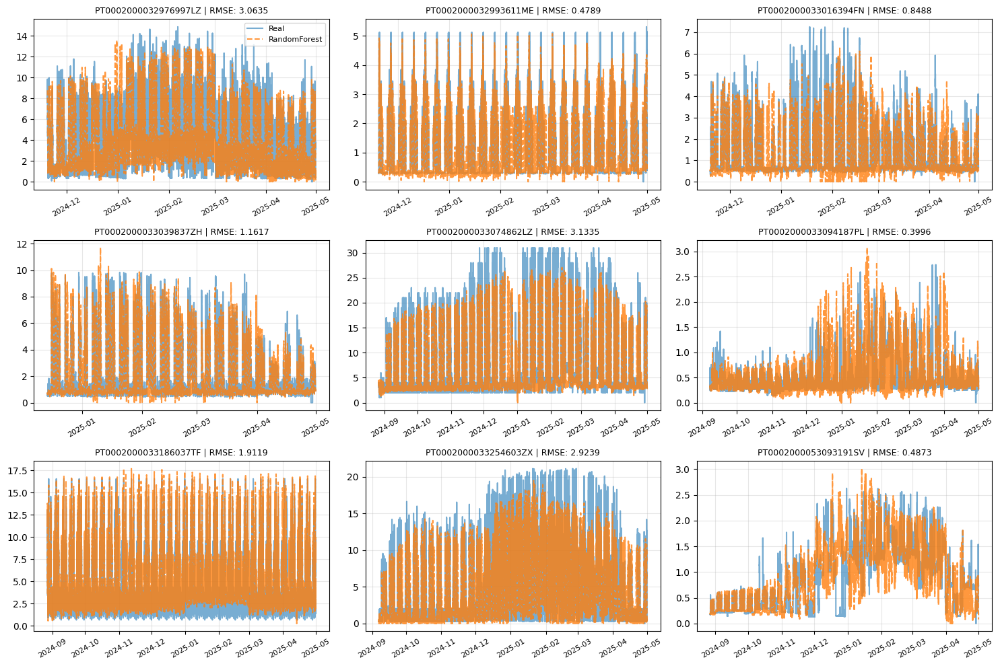

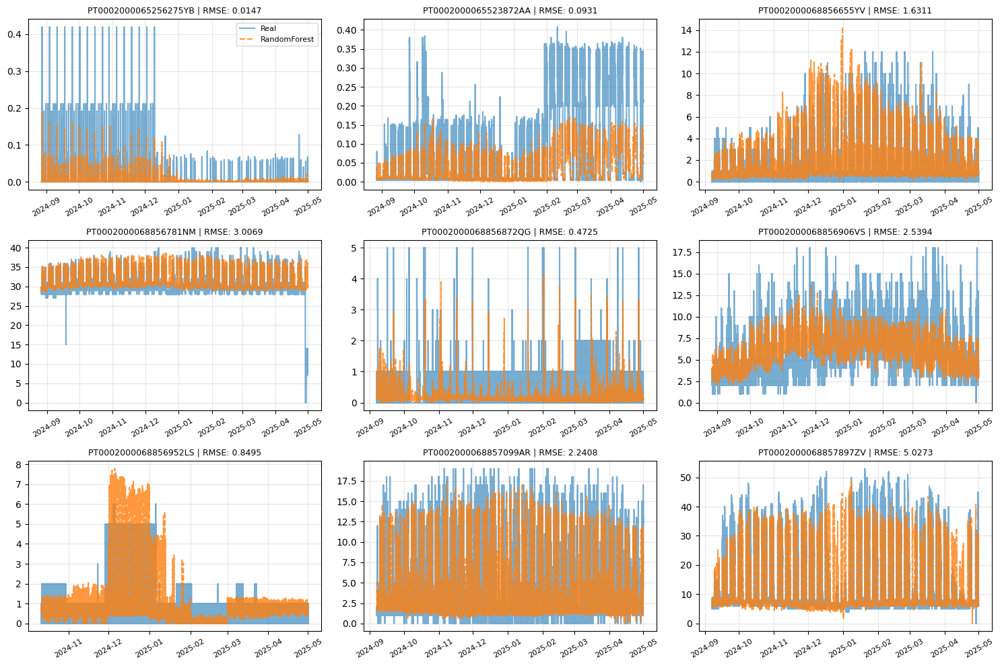

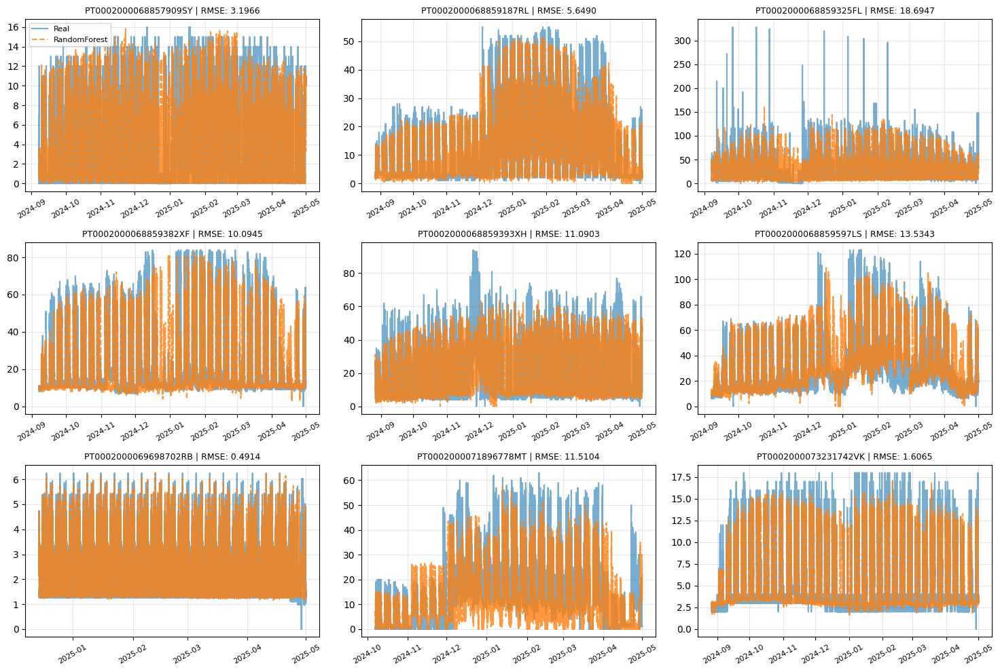

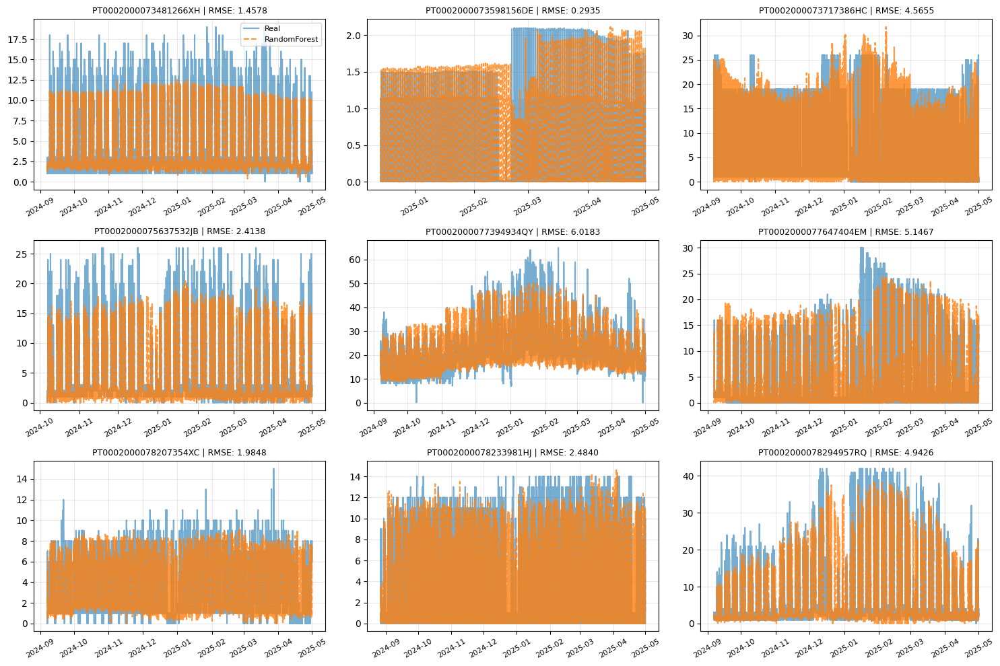

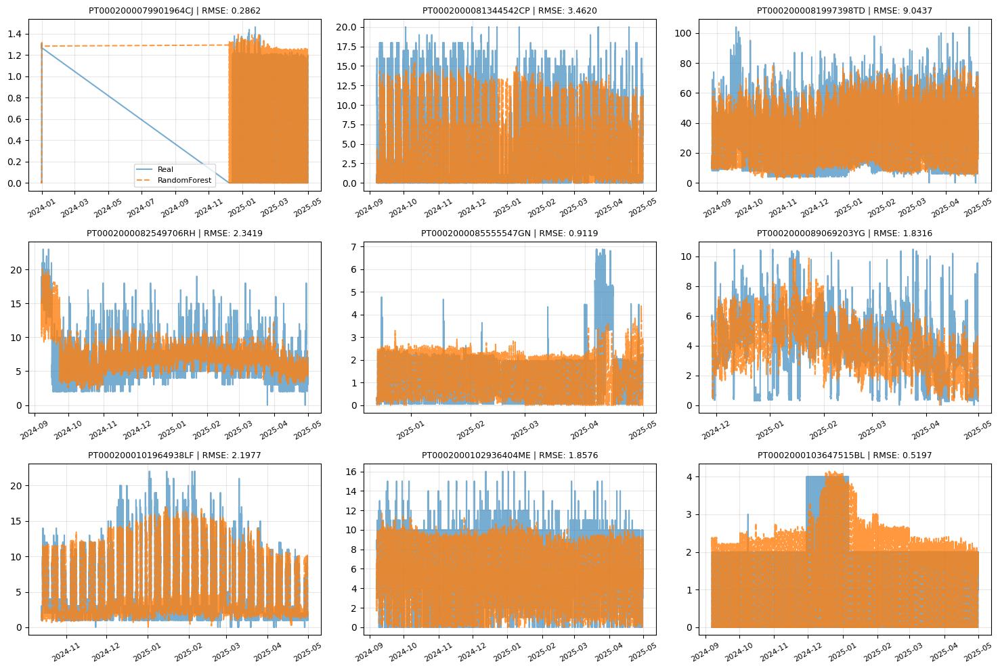

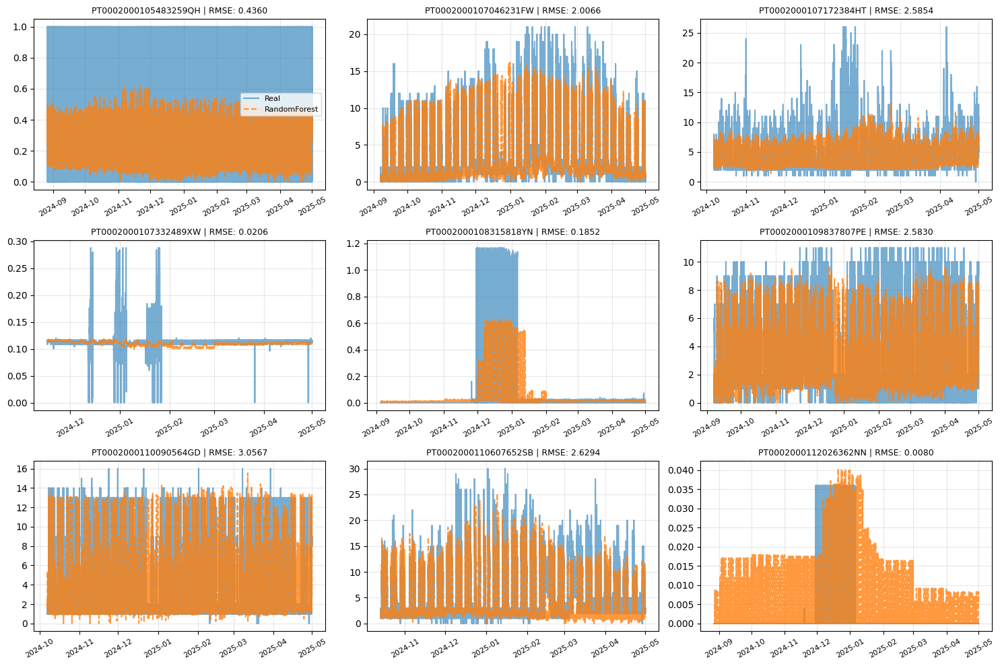

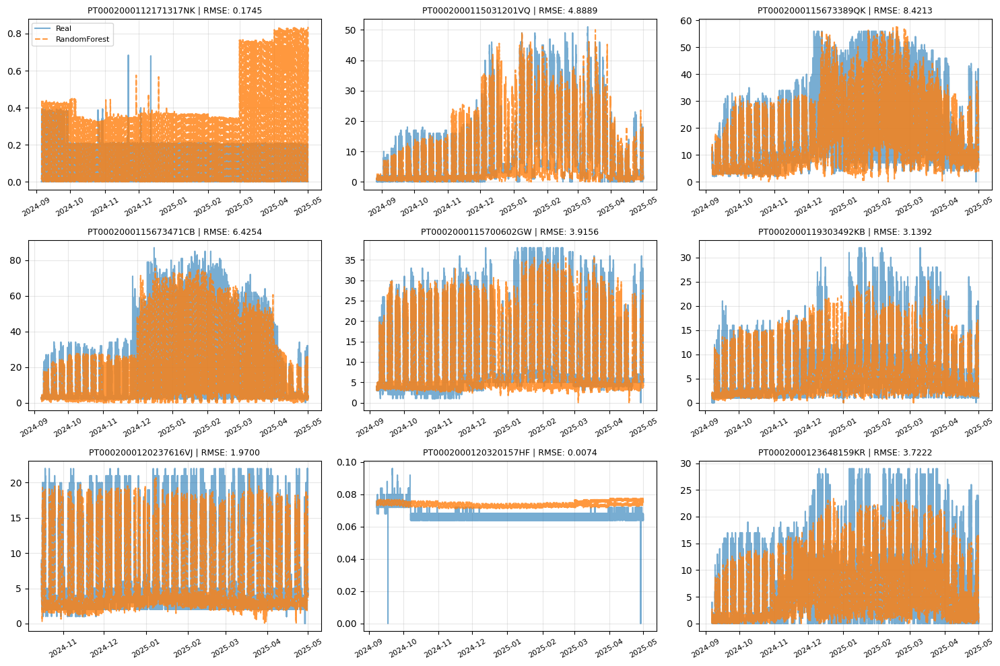

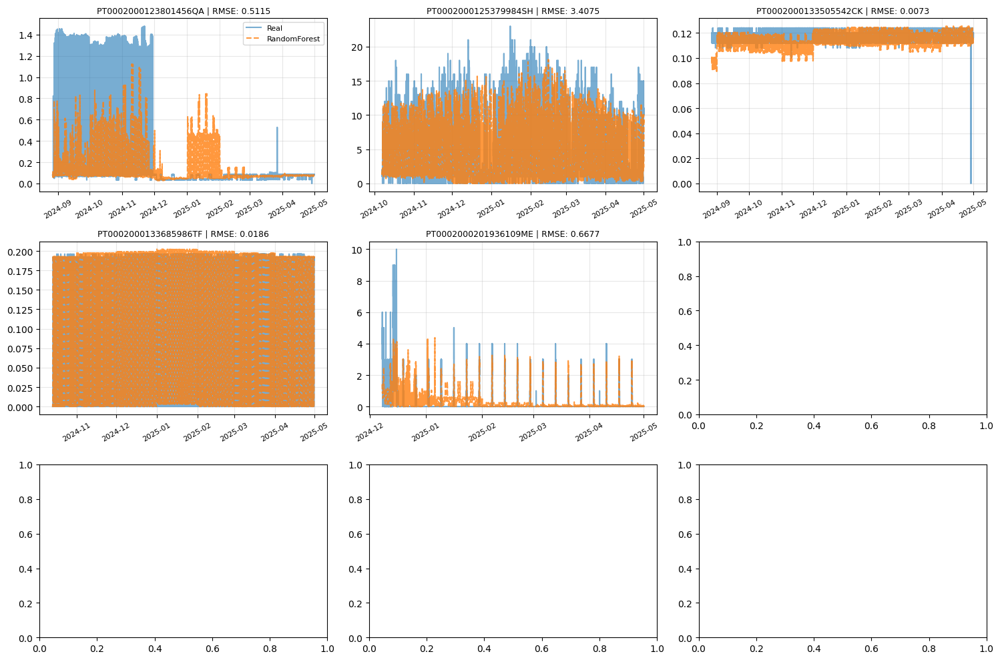

In [128]:
cpes = list(resultados_mlp.keys())
batch_size = 9

for i in range(0, len(cpes), batch_size):
    fig, axes = plt.subplots(3, 3, figsize=(15, 10))
    axes = axes.flatten()
    
    # Selecionar o lote atual de CPEs
    batch_cpes = cpes[i : i + batch_size]
    
    for j, cpe in enumerate(batch_cpes):
        # Extrair dados do dicionario de resultados_mlp
        dados_cpe = resultados_mlp[cpe]
        real = dados_cpe["real"]
        previsao = dados_cpe["previsao"]
        rmse_val = dados_cpe["rmse"]
        
        # Plotar
        axes[j].plot(real.index, real, label="Real", color='tab:blue', alpha=0.6)
        axes[j].plot(previsao.index, previsao, label="RandomForest", color='tab:orange', alpha=0.8, linestyle='--')
        
        # Titulo com o erro associado
        axes[j].set_title(f"{cpe} | RMSE: {rmse_val:.4f}", fontsize=9)
        axes[j].grid(True, alpha=0.3)
        
        # Melhorar a leitura da data no eixo X
        axes[j].tick_params(axis='x', rotation=30, labelsize=8)
        
        # Legenda apenas no primeiro grafico para nao poluir
        if j == 0:
            axes[j].legend(loc='best', fontsize=8)
    
    plt.tight_layout()
    plt.show()

##### com normalização

In [107]:
# Organizar CPEs por cluster
cpes_by_cluster_id = {}
for cpe, cluster_id in cluster_por_cpe.items():
    if cpe in df_feature_set_scaled:
        cpes_by_cluster_id.setdefault(cluster_id, []).append(cpe)

best_params_cluster_mlp_scaled = {}

print(f"--- Iniciando Otimização MLP por Cluster ---")

for cluster_id, lista_cpes in cpes_by_cluster_id.items():
    
    # Selecionar amostra aleatoria de CPEs deste cluster
    cpes_selecionados = random.sample(lista_cpes, min(len(lista_cpes), N_CPES_TESTE))
    print(f"\n Otimizando Cluster {cluster_id} (Amostra: {len(cpes_selecionados)} CPEs)")

    def objective(trial):
        # --- DEFINIÇÃO DO ESPAÇO DE PROCURA ---
        # Estrutura da Rede (Tuplas de camadas)
        layers_options = [
            (32,),
            (50,),
            (64,),
            (100,), 
            (50, 25), 
            (64, 32),
        ]
        
        params = {
            'hidden_layer_sizes': trial.suggest_categorical('hidden_layer_sizes', layers_options),
            'activation': 'relu',  # Relu e geralmente o melhor padrao
            'solver': 'adam',      # Adam funciona bem para dados grandes
            
            # Alpha (Regularizacao L2): Evita overfitting
            'alpha': trial.suggest_float('alpha', 1e-5, 1e-1, log=True),
            
            # Taxa de aprendizagem inicial
            'learning_rate_init': trial.suggest_float('learning_rate_init', 1e-4, 1e-2, log=True),
            
            # Outros fixos
            'max_iter': 500,
            'early_stopping': True,
            'random_state': 42
        }
        
        erros_cpes = []
        
        for cpe in cpes_selecionados:
            dados = df_feature_set_scaled[cpe] 
            
            X_t, y_t = dados["X_treino"], dados["y_treino"]
            X_v, y_v = dados["X_teste"], dados["y_teste"]
            
            # Criar modelo com parametros do trial
            model = MLPRegressor(**params)
            
            try:
                # Treinar (silenciosamente)
                model.fit(X_t, y_t)
                
                # Prever
                preds = model.predict(X_v)
                
                rmse = np.sqrt(mean_squared_error(y_v, preds))
                erros_cpes.append(rmse)
                
            except Exception as e:
                # Se o modelo explodir, retornamos erro infinito
                return float('inf')
        
        # O objetivo e minimizar a media dos RMSEs dos CPEs testados
        return np.mean(erros_cpes)

    # Executar Optuna
    optuna.logging.set_verbosity(optuna.logging.WARNING) 
    study = optuna.create_study(direction='minimize')
    study.optimize(objective, n_trials=N_TRIALS)
    
    # Guardar melhores params
    best_params = study.best_params
    
    # Adicionar configuracoes fixas necessarias para a aplicacao final
    best_params.update({
        'activation': 'relu',
        'solver': 'adam',
        'max_iter': 1000,       # Na versao final damos mais tempo
        'early_stopping': True,
        'random_state': 42
    })
    
    best_params_cluster_mlp_scaled[cluster_id] = best_params
    print(f"  [Cluster {cluster_id}] Melhor RMSE: {study.best_value:.4f}")
    print(f"  -> Params: {study.best_params}")

print("\n--- Otimização MLP Concluída ---")

--- Iniciando Otimização MLP por Cluster ---

 Otimizando Cluster 0 (Amostra: 5 CPEs)
  [Cluster 0] Melhor RMSE: 0.5896
  -> Params: {'hidden_layer_sizes': (50,), 'alpha': 0.00036576760058963507, 'learning_rate_init': 0.00010217105301665127}

 Otimizando Cluster 1 (Amostra: 5 CPEs)
  [Cluster 1] Melhor RMSE: 1.0076
  -> Params: {'hidden_layer_sizes': (32,), 'alpha': 0.05295721446056777, 'learning_rate_init': 0.007603027501420191}

 Otimizando Cluster 2 (Amostra: 5 CPEs)
  [Cluster 2] Melhor RMSE: 0.6378
  -> Params: {'hidden_layer_sizes': (100,), 'alpha': 0.0991217101781074, 'learning_rate_init': 0.008969735951406694}

--- Otimização MLP Concluída ---


In [129]:
# Dicionario para guardar os resultados finais
resultados_mlp_scaled = {}

for cpe, dados in df_feature_set_scaled.items():
    
    # --- 1. Identificar Cluster e Parametros ---
    # Verificar a qual cluster este CPE pertence
    if cpe in cluster_por_cpe:
        cluster_id = cluster_por_cpe[cpe]
        
        # Recuperar os parametros desse cluster
        if cluster_id in best_params_cluster_mlp_scaled:
            # .copy() é importante para não alterar o dicionário original
            params = best_params_cluster_mlp_scaled[cluster_id].copy()
        else:
            print(f"AVISO: Cluster {cluster_id} sem parâmetros. Usando default.")
            # Fallback seguro
            params = {
                'hidden_layer_sizes': (100, 50), 
                'learning_rate_init': 0.001, 
                'alpha': 0.0001
            }
    else:
        print(f"AVISO: CPE {cpe} sem cluster. Usando default.")
        cluster_id = "N/A"
        params = {
            'hidden_layer_sizes': (100, 50), 
            'learning_rate_init': 0.001, 
            'alpha': 0.0001
        }

    # Forcar/Adicionar configuracoes fixas 
    params.update({
        'validation_fraction': 0.1,
        'verbose': False
    })

    print(f"Treinando CPE: {cpe} (Cluster {cluster_id})")

    # Obter os dados
    X_treino, y_treino = dados["X_treino"], dados["y_treino"]
    X_teste, y_teste   = dados["X_teste"], dados["y_teste"]
    
    # Obter o scaler (Crucial para desnormalizar)
    if "scaler_y" in dados:
        scaler_y = dados["scaler_y"]
    else:
        print(f"Erro: Scaler não encontrado para {cpe}. Saltando.")
        continue

    # Instanciar o modelo com os PARAMS OTIMIZADOS
    # O **params desembrulha o dicionario e coloca os argumentos no sitio certo
    model = MLPRegressor(**params)
    
    # Treinar o modelo
    try:
        model.fit(X_treino, y_treino)
    except Exception as e:
        print(f"  -> Erro no treino do CPE {cpe}: {e}")
        continue
    
    # Fazer a previsao (Sai NORMALIZADA)
    previsoes_norm = model.predict(X_teste)
    
    # DESNORMALIZAR (Voltar para kW) 
    previsoes_real_values = scaler_y.inverse_transform(previsoes_norm.reshape(-1, 1)).flatten()
    y_teste_real_values = scaler_y.inverse_transform(y_teste.values.reshape(-1, 1)).flatten()
    
    # Criar Series
    previsoes_series = pd.Series(previsoes_real_values, index=y_teste.index)
    y_teste_real_series = pd.Series(y_teste_real_values, index=y_teste.index)
    
    # Avaliacao
    mse = mean_squared_error(y_teste_real_series, previsoes_series)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_teste_real_series, previsoes_series)

    print(f"Antes de clipping: MAE: {mae:.4f} | RMSE: {rmse:.4f}")

    # clip feito para meter valores negativos a zero (nao existem potencias negativas)
    previsao_final = np.clip(previsoes_series, 0, None)

    # metricas de erro
    mse = mean_squared_error(y_teste_real_series, previsao_final)
    rmse_final = np.sqrt(mse)
    mae_final = mean_absolute_error(y_teste_real_series, previsao_final)

    print(f"Após clipping: MAE: {mae_final:.4f} | RMSE: {rmse_final:.4f}")
    
    # Guardar resultados
    resultados_mlp_scaled[cpe] = {
        "modelo": model, 
        "real": y_teste_real_series,
        "previsao": previsao_final,
        "rmse": rmse_final,
        "mae": mae_final,
        "params_usados": params 
    }


Treinando CPE: PT0002000032976997LZ (Cluster 0)
Antes de clipping: MAE: 2.4784 | RMSE: 3.3868
Após clipping: MAE: 2.4743 | RMSE: 3.3807
Treinando CPE: PT0002000032993611ME (Cluster 1)
Antes de clipping: MAE: 0.2865 | RMSE: 0.4744
Após clipping: MAE: 0.2865 | RMSE: 0.4743
Treinando CPE: PT0002000033016394FN (Cluster 1)
Antes de clipping: MAE: 0.5041 | RMSE: 0.8505
Após clipping: MAE: 0.5028 | RMSE: 0.8493
Treinando CPE: PT0002000033039837ZH (Cluster 1)
Antes de clipping: MAE: 0.6304 | RMSE: 1.1925
Após clipping: MAE: 0.6302 | RMSE: 1.1923
Treinando CPE: PT0002000033074862LZ (Cluster 0)
Antes de clipping: MAE: 1.7910 | RMSE: 3.1225
Após clipping: MAE: 1.7910 | RMSE: 3.1224
Treinando CPE: PT0002000033094187PL (Cluster 1)
Antes de clipping: MAE: 0.2334 | RMSE: 0.3821
Após clipping: MAE: 0.2334 | RMSE: 0.3821
Treinando CPE: PT0002000033186037TF (Cluster 0)
Antes de clipping: MAE: 1.3132 | RMSE: 1.7789
Após clipping: MAE: 1.3132 | RMSE: 1.7789
Treinando CPE: PT0002000033254603ZX (Cluster 0)


In [130]:
# Concatenar todos os valores reais e previsoes
todos_reais = np.concatenate([resultados_mlp_scaled[cpe]["real"] for cpe in resultados_mlp_scaled])
todas_prev = np.concatenate([resultados_mlp_scaled[cpe]["previsao"] for cpe in resultados_mlp_scaled])

# Calcular métricas globais
rmse_total = np.sqrt(np.mean((todos_reais - todas_prev)**2))
mae_total = mean_absolute_error(todos_reais, todas_prev)
print(f"MLP Normalizado - MAE total: {mae_total:.3f}, RMSE total: {rmse_total:.3f}")

MLP Normalizado - MAE total: 2.063, RMSE total: 4.748


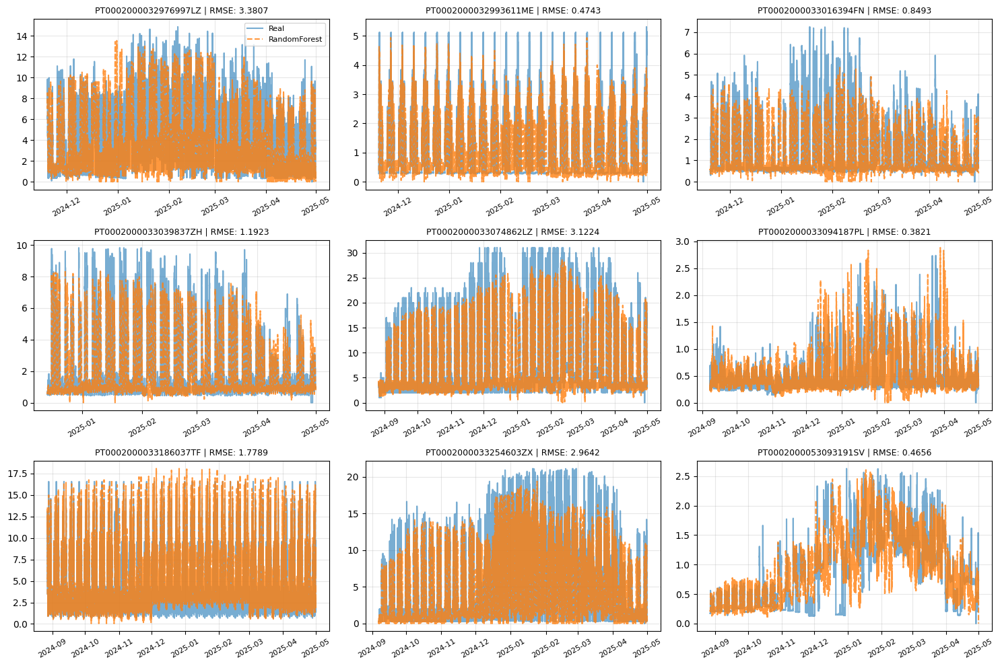

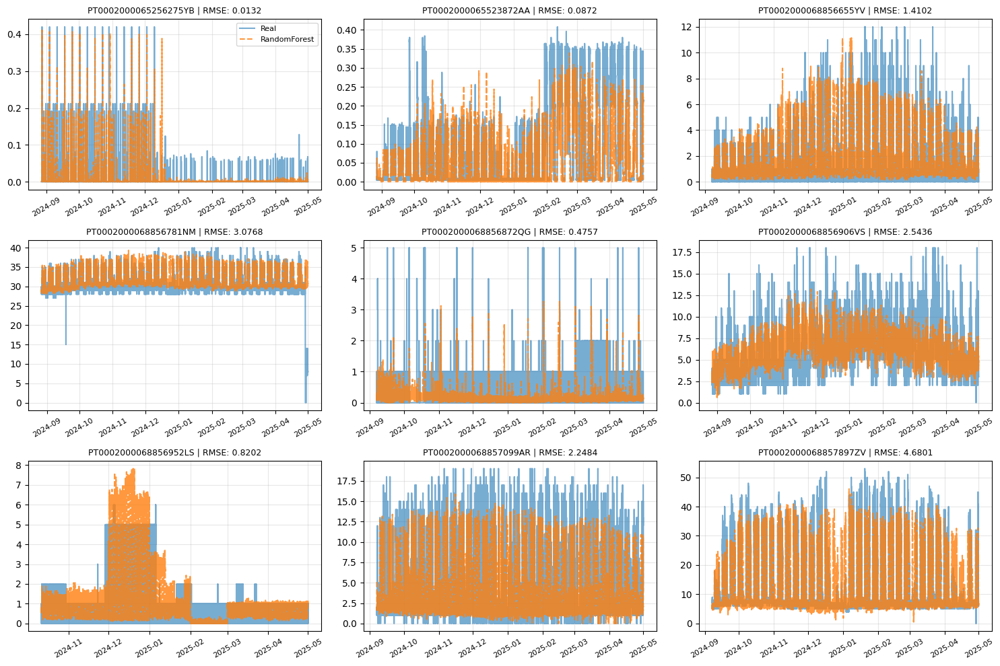

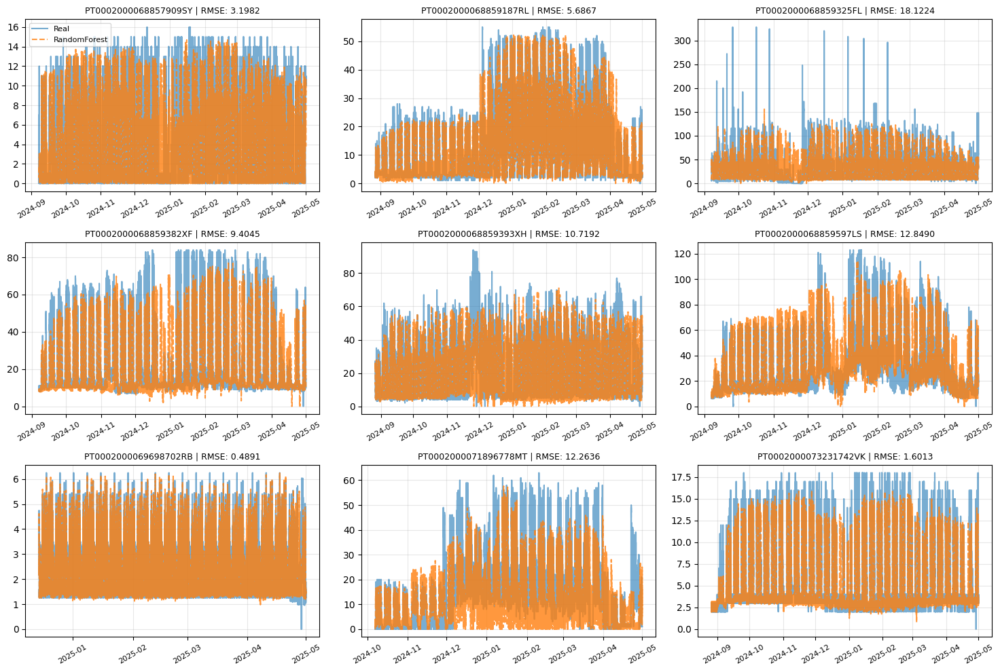

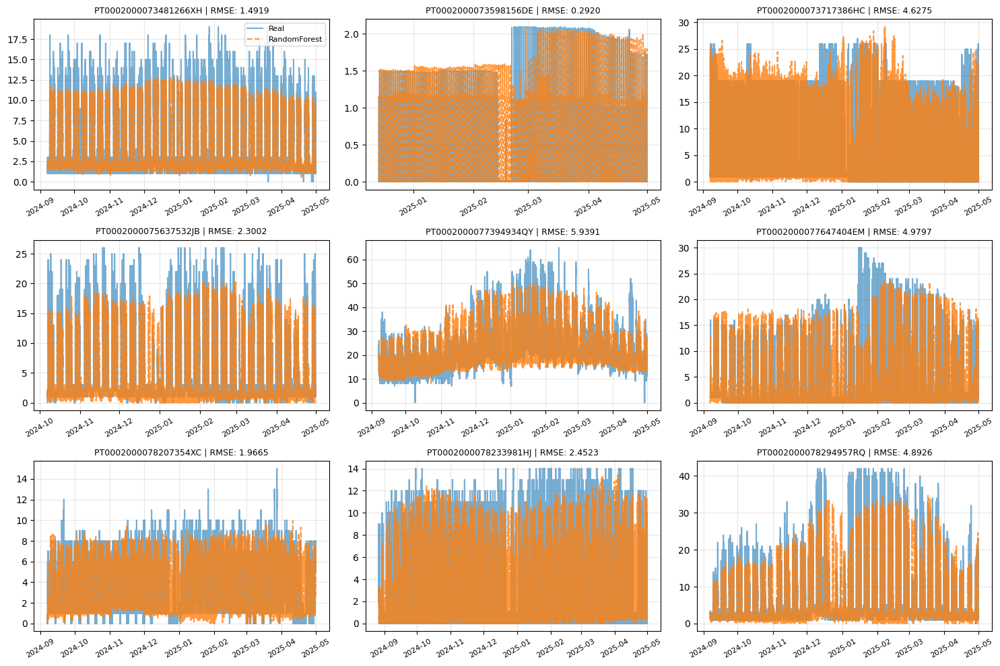

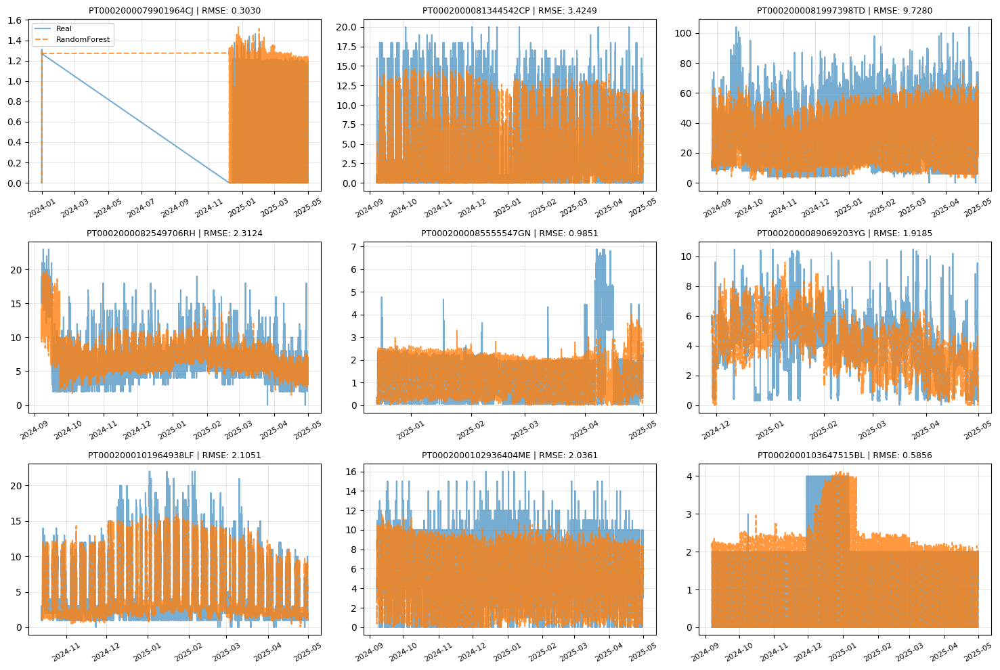

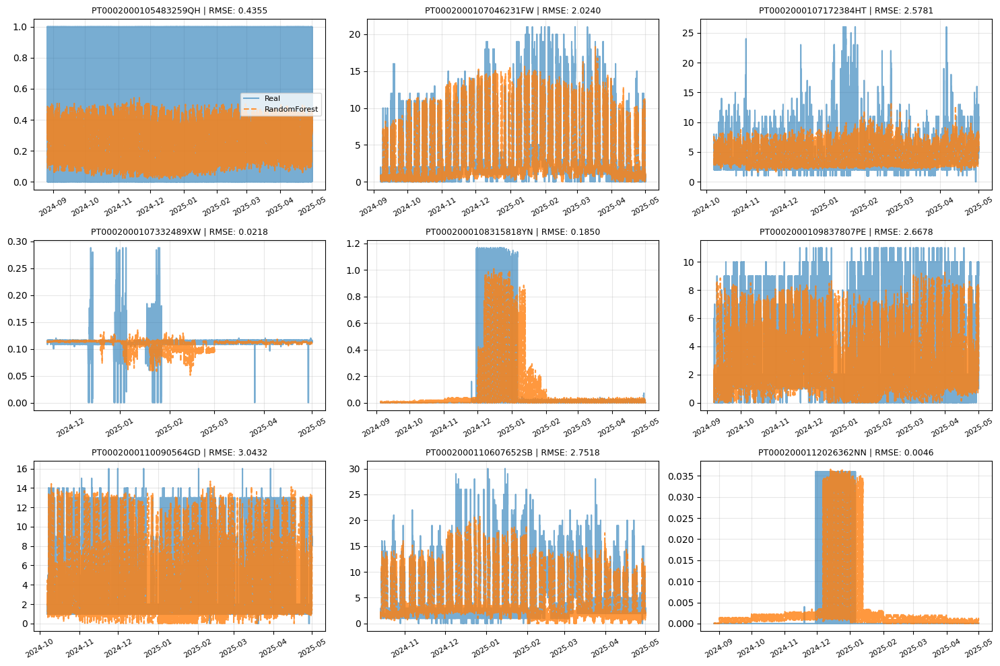

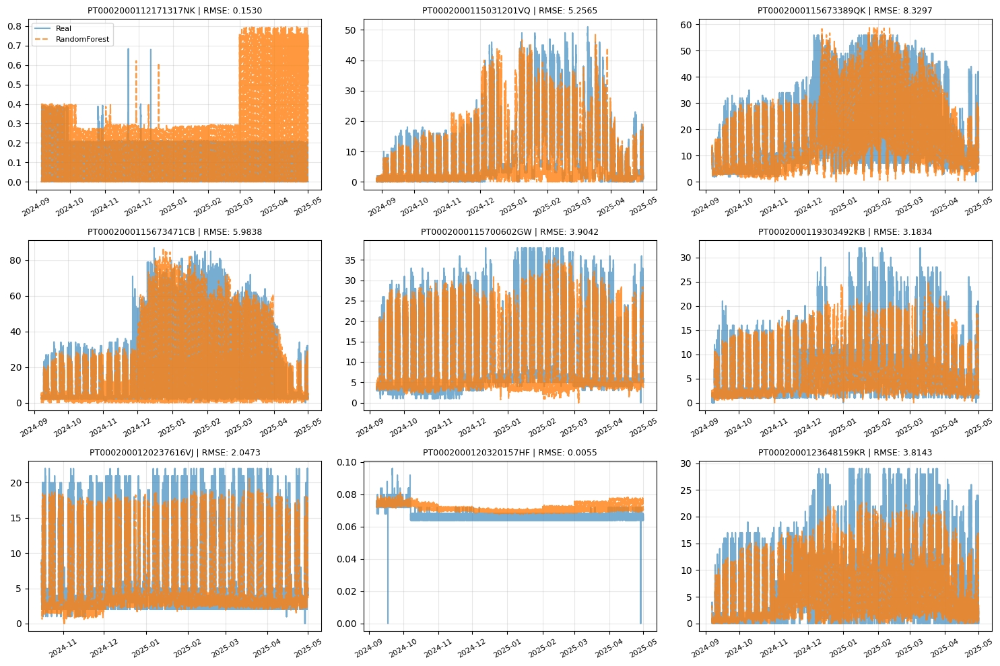

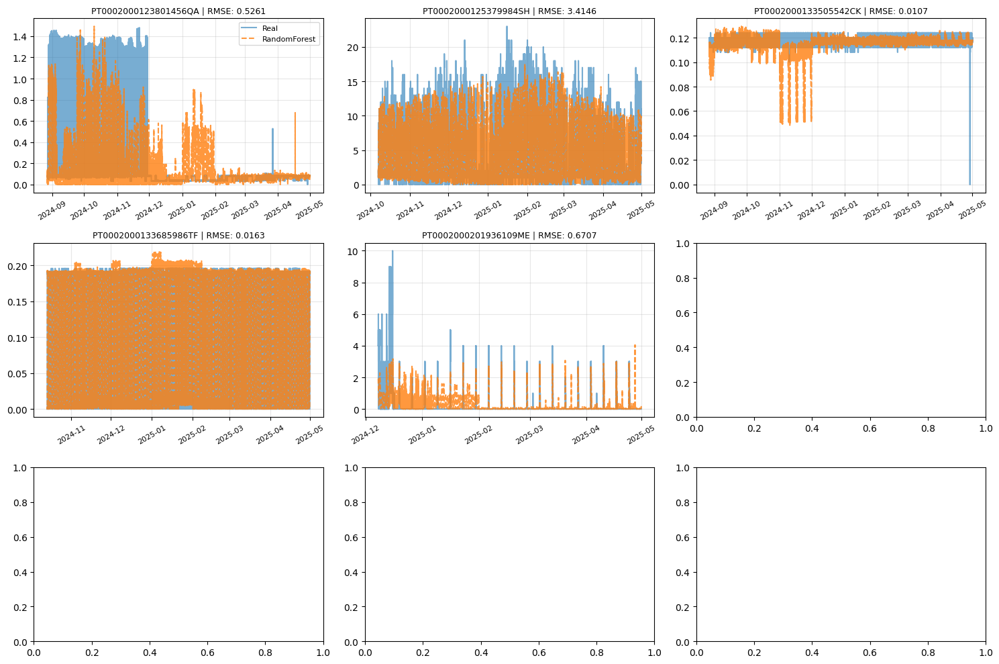

In [131]:
cpes = list(resultados_mlp_scaled.keys())
batch_size = 9

for i in range(0, len(cpes), batch_size):
    fig, axes = plt.subplots(3, 3, figsize=(15, 10))
    axes = axes.flatten()
    
    # Selecionar o lote atual de CPEs
    batch_cpes = cpes[i : i + batch_size]
    
    for j, cpe in enumerate(batch_cpes):
        # Extrair dados do dicionario de resultados_mlp_scaled
        dados_cpe = resultados_mlp_scaled[cpe]
        real = dados_cpe["real"]
        previsao = dados_cpe["previsao"]
        rmse_val = dados_cpe["rmse"]
        
        # Plotar
        axes[j].plot(real.index, real, label="Real", color='tab:blue', alpha=0.6)
        axes[j].plot(previsao.index, previsao, label="RandomForest", color='tab:orange', alpha=0.8, linestyle='--')
        
        # Titulo com o erro associado
        axes[j].set_title(f"{cpe} | RMSE: {rmse_val:.4f}", fontsize=9)
        axes[j].grid(True, alpha=0.3)
        
        # Melhorar a leitura da data no eixo X
        axes[j].tick_params(axis='x', rotation=30, labelsize=8)
        
        # Legenda apenas no primeiro grafico para nao poluir
        if j == 0:
            axes[j].legend(loc='best', fontsize=8)
    
    plt.tight_layout()
    plt.show()